In [1]:
import numpy as np
import matplotlib.pyplot as plt
import healpy as hp
from tqdm import tqdm

### Constants

In [2]:
c = 299792458.
day_s = 86400.
Om_Earth = 2*np.pi/day_s
print(Om_Earth)

7.27220521664304e-05


### Detectors information
The general coordinate system is WGS-84 Earth Model, described in the documentation of [lal_detector](https://lscsoft.docs.ligo.org/lalsuite/lal/group___l_a_l_detectors__h.html),  
and the document [T980044](https://dcc.ligo.org/public/0002/T980044/001/T980044-10.pdf).

In [3]:
#LIGO-Hanford, LIGO-Livingston, Virgo
#https://dcc.ligo.org/public/0072/P000006/000/P000006-D.pdf
#https://journals.aps.org/prd/pdf/10.1103/PhysRevD.63.042003

u_H = np.array([-0.223891216, 0.799830697, 0.556905359])
v_H = np.array([-0.913978490, 0.0260953206, -0.404922650])
L_H = 4000
x_H = np.array([-2161414.92635999, -3834695.17889000, 4600350.22664000])

u_L = np.array([-0.954574615, -0.141579994, -0.262187738])
v_L = np.array([0.297740169, -0.487910627, -0.820544948])
L_L = 4000
x_L = np.array([-74276.04472380, -5496283.71970999, 3224257.01744000])

u_V = np.array([-0.7005, 0.2085, 0.6826])
v_V = np.array([-0.0538, -0.9691, 0.2408])
L_V = 3000
x_V = np.array([4546374., 842990., 4378577.])

#KAGRA
u_K = np.array([-0.3759040, -0.8361583, 0.3994189])
v_K = np.array([0.7164378, 0.01114076, 0.6975620])
L_K_x = 2*1513.2535
L_K_y = 2*1511.611
L_K = (L_K_x + L_K_y)/2
x_K = np.array([-3777336.024, 3484898.411, 3765313.697])

#LIGO-India
#https://dcc.ligo.org/DocDB/0167/T2000158/001/LIO_coordinateSystem.pdf->currently commented
u_I = np.array([0.38496278183, -0.39387275094, 0.83466634811])
v_I = np.array([0.89838844906, -0.04722636126, -0.43665531647])
L_I = 4000
x_I = np.array([1.34897115479e6, 5.85742826577e6, 2.12756925209e6])

#is the one in lal the most updated one?-> nope this is a place-holder
#u_I = np.array([-9.72097635269165039e-01, 2.34576612710952759e-01, -4.23695567519644101e-08])
#v_I = np.array([-5.76756671071052551e-02, -2.39010959863662720e-01, 9.69302475452423096e-01])
#L_I = 4000
#x_I = np.array([1450526.82294155, 6011058.39047265, 1558018.27884102])

#GEO600 #see below
x_G = np.array([3.856310e6, 0.666599e6, 5.019641e6])
u_G = np.array([-0.6261, -0.5522, 0.5506])
v_G = np.array([-0.4453, 0.8665, 0.2255])
L_G = 600

## Unit vectors and polarisation tensors

In [4]:
def n_hat(theta, phi):
    ct = np.cos(theta)
    st = np.sin(theta)
    cp = np.cos(phi)
    sp = np.sin(phi)
    
    n_x = st*cp
    n_y = st*sp
    n_z = ct

    return np.squeeze([n_x, n_y, n_z])#.T

#dn/d_th
def l_hat(theta, phi):
    
    ct = np.cos(theta)
    st = np.sin(theta)
    cp = np.cos(phi)
    sp = np.sin(phi)
    
    l_x = ct*cp
    l_y = ct*sp
    l_z = -st
    
    return np.squeeze([l_x, l_y, l_z])#.T

#d(n/th)/dphiz
def m_hat(theta, phi):
    ct = np.cos(theta)
    st = np.sin(theta)
    cp = np.cos(phi)
    sp = np.sin(phi)
    
    m_x = -sp
    m_y = cp
    m_z = cp*int(0)

    return np.squeeze([m_x, m_y, m_z])#.T

#all units vectors together
def unit_vectors(theta, phi):
    ct = np.cos(theta)
    st = np.sin(theta)
    cp = np.cos(phi)
    sp = np.sin(phi)
    
    n_x = st*cp
    n_y = st*sp
    n_z = ct
    
    l_x = ct*cp
    l_y = ct*sp
    l_z = -st
    
    m_x = -sp
    m_y = cp
    m_z = cp*int(0)

    n = np.squeeze([n_x, n_y, n_z])#.T
    l = np.squeeze([l_x, l_y, l_z])#.T
    m = np.squeeze([m_x, m_y, m_z])#.T
    
    return n, l, m

#polarization tensors
def e_pol (theta, phi):
    """
    Input: theta=[0,pi), phi=[0,2pi) must be lists 
    Output: e_cross, e_plus
    """
    
      
    _, ll, mm = unit_vectors(theta, phi)
    
    e_plus = np.array([np.array([ll[0]*ll[0], ll[0]*ll[1], ll[0]*ll[2]]), np.array([ll[1]*ll[0], ll[1]*ll[1], ll[1]*ll[2]]), np.array([ll[2]*ll[0],ll[2]*ll[1], ll[2]*ll[2]])])\
    -np.array([np.array([mm[0]*mm[0], mm[0]*mm[1], mm[0]*mm[2]]), np.array([mm[1]*mm[0], mm[1]*mm[1], mm[1]*mm[2]]), np.array([mm[2]*mm[0],mm[2]*mm[1], mm[2]*mm[2]])])
    e_cross = np.array([np.array([ll[0]*mm[0], ll[0]*mm[1], ll[0]*mm[2]]), np.array([ll[1]*mm[0], ll[1]*mm[1], ll[1]*mm[2]]), np.array([ll[2]*mm[0],ll[2]*mm[1], ll[2]*mm[2]])])\
    +np.array([np.array([mm[0]*ll[0], mm[0]*ll[1], mm[0]*ll[2]]), np.array([mm[1]*ll[0], mm[1]*ll[1], mm[1]*ll[2]]), np.array([mm[2]*ll[0],mm[2]*ll[1], mm[2]*ll[2]])])
    
    
    #e_cross = np.array(np.tensordot(ll,mm, axes = 0) + np.tensordot(mm,ll, axes = 0))
    #e_plus = np.array(np.tensordot(ll,ll, axes = 0) - np.tensordot(mm,mm, axes = 0))
    
    #e_cross = np.array(np.tensordot(ll,mm, axes = 0) + np.tensordot(mm,ll, axes = 0))
    #e_cross = np.array(list(map(np.tensordot,ll,mm,[0]*len(ll)))) + np.array(list(map(np.tensordot,ll,mm,[0]*len(ll))))



    return e_cross, e_plus

def e_pol_hats(ll, mm):
    """
    Input: l_hat ,m_hat
    Output: e_cross, e_plus
    """
    
    #e_plus = np.array([np.array([ll[0]*ll[0], ll[0]*ll[1], ll[0]*ll[2]]), np.array([ll[1]*ll[0], ll[1]*ll[1], ll[1]*ll[2]]), np.array([ll[2]*ll[0],ll[2]*ll[1], ll[2]*ll[2]])])\
    #-np.array([np.array([mm[0]*mm[0], mm[0]*mm[1], mm[0]*mm[2]]), np.array([mm[1]*mm[0], mm[1]*mm[1], mm[1]*mm[2]]), np.array([mm[2]*mm[0],mm[2]*mm[1], mm[2]*mm[2]])])
    #e_cross = np.array([np.array([ll[0]*mm[0], ll[0]*mm[1], ll[0]*mm[2]]), np.array([ll[1]*mm[0], ll[1]*mm[1], ll[1]*mm[2]]), np.array([ll[2]*mm[0],ll[2]*mm[1], ll[2]*mm[2]])])\
    #+np.array([np.array([mm[0]*ll[0], mm[0]*ll[1], mm[0]*ll[2]]), np.array([mm[1]*ll[0], mm[1]*ll[1], mm[1]*ll[2]]), np.array([mm[2]*ll[0],mm[2]*ll[1], mm[2]*ll[2]])])
    
    #e_plus = np.array(np.tensordot(ll,ll, axes = 0) - np.tensordot(mm,mm, axes = 0))
    #e_cross = np.array(np.tensordot(ll,mm, axes = 0) + np.tensordot(mm,ll, axes = 0))
    
    e_plus = np.einsum('i...,j...', ll, ll) - np.einsum('i...,j...', mm, mm)
    e_cross = np.einsum('i...,j...', ll, mm) + np.einsum('i...,j...', mm, ll)

    return e_plus, e_cross

def e_pol_hats_non_GR(nn, ll, mm):
    
    e_plus, e_cross = e_pol_hats(ll, mm)
    
    e_vec_x=np.einsum('i...,j...', ll, nn) + np.einsum('i...,j...', nn, ll)
    e_vec_y=np.einsum('i...,j...', mm, nn) + np.einsum('i...,j...', nn, mm)
    
    e_scal_breath = np.einsum('i...,j...', ll, ll) + np.einsum('i...,j...', mm, mm)
    e_scal_lon = np.sqrt(2)*np.einsum('i...,j...', nn, nn)
    
    return e_plus, e_cross, e_vec_x, e_vec_y, e_scal_breath, e_scal_lon
    

## Antenna patterns

In [5]:
#time transfer function for two-way tracking
#np.sinc(x) = np.sin(np.pi*x)/(np.pi*c)
def T_u (f, n_hat, u, L, mode = "small antenna limit"):
    """
    Evaluates the time transfer function
    
    Input:
    f -> frequency
    n_hat -> direction in the sky
    u -> arm unit vector with respect to Earth center (?)
    L -> arm length (meters) 
    mode -> "small antenna limits" by default, otherwise full expression
    
    Output:
    2-way track Time transfer function
    """

    if mode == "small antenna limit":
        T_u_small = 2*L/c
        return (T_u_small)
    
    else:
        T_u_full = (L/c)*np.exp(-2j*np.pi*f*L/c) \
        *(np.exp(-1j*np.pi*f*(L/c)*(1-np.dot(n_hat, u)))*np.sinc(f*(L/c)*(1+np.dot(n_hat,u))) \
          + np.exp(1j*np.pi*f*(L/c)*(1+np.dot(n_hat, u)))*np.sinc(f*(L/c)*(1-np.dot(n_hat,u))))

        return(T_u_full)

def T_u_small (f, n_hat, u, L):
    """
    Evaluates the time transfer function
    
    Input:
    f -> frequency
    n_hat -> direction in the sky
    u -> arm unit vector with respect to Earth center (?)
    L -> arm length (meters) 
    
    Output:
    2-way track Time transfer function
    """
    return 2*L/c    

def T_u_full (f, n_hat, u, L):
    """
    Evaluates the time transfer function
    
    Input:
    f -> frequency
    n_hat -> direction in the sky
    u -> arm unit vector with respect to Earth center (?)
    L -> arm length (meters) 
    
    Output:
    2-way track Time transfer function
    """
    n_dot_u = np.einsum('i,i...', u, n_hat)#np.tensordot(u, n_hat, axes = 1)
    phase = 1j*np.pi*f*L/c
    f_phase = f*(L/c)
    
    T_u_full = (L/c)*np.exp(-2*phase) \
    *(np.exp(-phase*(1 - n_dot_u))*np.sinc(f_phase*(1 + n_dot_u)) \
    + np.exp(phase*(1 + n_dot_u))*np.sinc(f_phase*(1 - n_dot_u)))

    return(T_u_full)
    

def R_timing_michelson(f, n_hat, u, v, L, mode = "small antenna limit"):
    t_u = T_u (f, n_hat, u, L, mode)
    t_v = T_u (f, n_hat, v, L, mode)
    
    #uu = np.outer(u,u)
    #vv = np.outer(v,v)
    #R_timing = 0.5*(uu*t_u - vv*t_v)
    
    uu_tu = np.array([np.array([u[0]*u[0]*t_u, u[0]*u[1]*t_u, u[0]*u[2]*t_u]),\
                  np.array([u[1]*u[0]*t_u, u[1]*u[1]*t_u, u[1]*u[2]*t_u]),\
                  np.array([u[2]*u[0]*t_u, u[2]*u[1]*t_u, u[2]*u[2]*t_u])])
    
    vv_tv = np.array([np.array([v[0]*v[0]*t_v, v[0]*v[1]*t_v, v[0]*v[2]*t_v]),\
                  np.array([v[1]*v[0]*t_v, v[1]*v[1]*t_v, v[1]*v[2]*t_v]),\
                  np.array([v[2]*v[0]*t_v, v[2]*v[1]*t_v, v[2]*v[2]*t_v])])
    R_timing = 0.5*(uu_tu - vv_tv)
    
    return R_timing

def R_timing_michelson_small(f, n_hat, u, v, L):
    t_u = T_u_small (f, n_hat, u, L)
    t_v = T_u_small (f, n_hat, v, L)
    uu = np.outer(u,u)
    vv = np.outer(v,v)
    R_timing = 0.5*(uu*t_u - vv*t_v)
    return R_timing

def R_timing_michelson_full(f, n_hat, u, v, L):
    t_u = T_u_full (f, n_hat, u, L)
    t_v = T_u_full (f, n_hat, v, L)
    
    #uu = np.outer(u,u)
    #vv = np.outer(v,v)
    #R_timing = 0.5*(uu*t_u - vv*t_v)
    
    uu_tu = np.array([np.array([u[0]*u[0]*t_u, u[0]*u[1]*t_u, u[0]*u[2]*t_u]),\
                  np.array([u[1]*u[0]*t_u, u[1]*u[1]*t_u, u[1]*u[2]*t_u]),\
                  np.array([u[2]*u[0]*t_u, u[2]*u[1]*t_u, u[2]*u[2]*t_u])])
    
    #uu_tu = np.einsum('i,j,...',u,u,t_u)
    
    vv_tv = np.array([np.array([v[0]*v[0]*t_v, v[0]*v[1]*t_v, v[0]*v[2]*t_v]),\
                  np.array([v[1]*v[0]*t_v, v[1]*v[1]*t_v, v[1]*v[2]*t_v]),\
                  np.array([v[2]*v[0]*t_v, v[2]*v[1]*t_v, v[2]*v[2]*t_v])])
    #vv_tv = np.einsum('i,j,...',v,v,t_v)
    
    R_timing = 0.5*(uu_tu - vv_tv)
    return R_timing

def R_strain_michelson(f, n_hat, u, v, L, mode = "small antenna limit"):
    R_strain = R_timing_michelson(f, n_hat, u, v, L, mode)/(2*L/c)
    return R_strain


def R_strain_michelson_small(f, n_hat, u, v, L):
    R_strain = R_timing_michelson_small(f, n_hat, u, v, L)/(2*L/c)
    return R_strain

def R_strain_michelson_full(f, n_hat, u, v, L):
    R_strain = R_timing_michelson_full(f, n_hat, u, v, L)/(2*L/c)
    return R_strain

def Antenna_patterns(f, theta, phi, u, v , L, mode = "small antenna limit"):
    #if theta, phi numbers
    try:
        n_h = [n_hat(th, ph) for ph in phi for th in theta]
        
        e_cross, e_plus =np.transpose([e_pol(th, ph) for ph in phi for th in theta], axes = (1,0,2,3))

        R_cross = np.array([np.tensordot(e_cr, R_strain_michelson(f, n_hat, u, v, L, mode)) for n_hat, e_cr in zip(n_h, e_cross)])

        R_plus = np.array([np.tensordot(e_pl, R_strain_michelson(f, n_hat, u, v, L, mode)) for n_hat, e_pl in zip(n_h, e_plus)])
        
    except:
        n_h = n_hat(theta, phi)
        e_cross, e_plus = e_pol(theta, phi)

        R_cross = np.tensordot(e_cross, R_strain_michelson(f, n_h, u, v, L, mode))

        R_plus = np.tensordot(e_plus, R_strain_michelson(f, n_h, u, v, L, mode))
        
    return (R_cross, R_plus)

def Antenna_patterns_small_old(f, theta, phi, u, v , L):
    n, m, l = unit_vectors(theta, phi)
        
    try:
        e_cross, e_plus = np.transpose(e_pol_hats(m, l), axes = (0,3,4,1,2))
        
    except ValueError:
        e_cross, e_plus = e_pol_hats(m, l)
    
    try:
        R_mich = R_strain_michelson_small(f, n, u, v, L)
        #print(np.shape(e_cross), np.shape(R_mich))
        R_cross = np.tensordot(e_cross, R_mich)

        R_plus = np.tensordot(e_plus, R_mich)
        
    except ValueError:
        e_cross, e_plus = np.transpose(e_pol_hats(m, l), axes = (0,3,1,2))
        R_mich = R_strain_michelson_small(f, n, u, v, L)
        R_cross = np.tensordot(e_cross, R_mich)
        R_plus = np.tensordot(e_plus, R_mich)
        #print(np.shape(e_cross), np.shape(R_mich), np.shape(R_cross))
    return (R_cross, R_plus)

def Antenna_patterns_small(f, theta, phi, u, v , L):
    n, m, l = unit_vectors(theta, phi)
    #print(np.shape(n))    
    
    e_cross, e_plus = e_pol_hats(m, l)
    #print(np.shape(e_cross))
    
    R_mich = R_strain_michelson_small(f, n, u, v, L)
    #print(np.shape(R_mich))
    
    R_cross = np.einsum('...ij,ji', e_cross, R_mich)
    R_plus = np.einsum('...ij,ji', e_plus, R_mich)
    
    return (R_cross, R_plus)

def Antenna_patterns_full_old(f, theta, phi, u, v , L):
    n, m, l = unit_vectors(theta, phi)
    
    try:
        e_cross, e_plus = np.transpose(e_pol_hats(m, l), axes = (0,3,4,1,2))
        
    except ValueError:
        e_cross, e_plus = e_pol_hats(m, l)
    
    try:
        R_mich = R_strain_michelson_full(f, n, u, v, L)
        #print(np.shape(e_cross), np.shape(R_mich))
        try:
            R_cross = np.transpose(np.tensordot(e_cross, R_mich), axes=(2,3,0,1))[0][0]
            R_plus = np.transpose(np.tensordot(e_plus, R_mich), axes=(2,3,0,1))[0][0]
        except ValueError:
            R_cross = np.tensordot(e_cross, R_mich)
            R_plus = np.tensordot(e_plus, R_mich)
     
    except ValueError:
        e_cross, e_plus = np.transpose(e_pol_hats(m, l), axes = (0,3,1,2))
        R_mich = R_strain_michelson_full(f, n, u, v, L)
        #print(np.shape(e_cross), np.shape(R_mich))
        #R_cross = np.transpose(np.tensordot(e_cross, R_mich, axes = ([1,2],[1,0])))[0]
        #R_plus = np.transpose(np.tensordot(e_plus, R_mich, axes = ([1,2],[1,0])))[0]
        R_cross = np.einsum('...ij,ji...',e_cross, R_mich)#, optimize='greedy')
        R_plus = np.einsum('...ij,ji...',e_plus, R_mich)#, optimize='greedy')
        #print(np.shape(e_cross), np.shape(R_mich), np.shape(R_cross))
        
    return (R_cross, R_plus)

def Antenna_patterns_full(f, theta, phi, u, v , L):
    n, m, l = unit_vectors(theta, phi)
    
    #print(np.shape(n))    
    
    e_cross, e_plus = e_pol_hats(m, l)
    #print(np.shape(e_cross))
    
    R_mich = R_strain_michelson_full(f, n, u, v, L)
    #print(np.shape(R_mich))
    
    R_cross = np.einsum('...ij,ji...', e_cross, R_mich)
    R_plus = np.einsum('...ij,ji...', e_plus, R_mich)
    
    return (R_cross, R_plus)

def Antenna_patterns_small_non_GR(f, theta, phi, u, v , L):
    n, m, l = unit_vectors(theta, phi)
    #print(np.shape(n))    
    
    e_plus, e_cross, e_vec_x, e_vec_y, e_scal_breath, e_scal_lon = e_pol_hats_non_GR(n, m, l)
    #print(np.shape(e_cross))
    
    R_mich = R_strain_michelson_small(f, n, u, v, L)
    #print(np.shape(R_mich))
    
    R_cross = np.einsum('...ij,ji', e_cross, R_mich)
    R_plus = np.einsum('...ij,ji', e_plus, R_mich)
    
    R_vec_x = np.einsum('...ij,ji', e_vec_x, R_mich)
    R_vec_y = np.einsum('...ij,ji', e_vec_y, R_mich)
    
    R_scal_breath = np.einsum('...ij,ji', e_scal_breath, R_mich)
    R_scal_lon = np.einsum('...ij,ji', e_scal_lon, R_mich)
    
    
    return (R_cross, R_plus, R_vec_x, R_vec_y, R_scal_breath, R_scal_lon)

In [6]:
def vector_earth_rotation_old(x0, t, t0 = 0):
    x_t = x0[0]*np.cos(Om_Earth*(t-t0)) - x0[1]*np.sin(Om_Earth*(t-t0))
    y_t = x0[0]*np.sin(Om_Earth*(t-t0)) + x0[1]*np.cos(Om_Earth*(t-t0))
    try:
        z_t = [x0[2]]*len(t)
    except TypeError:
        z_t = x0[2]
    #rot_matrix = [[np.cos(Om_Earth*(t-t0)), -np.sin(Om_Earth*(t-t0)), 0.]\
    #             [np.sin(Om_Earth*(t-t0)), np.cos(Om_Earth*(t-t0)), 0.]\
    #             [0., 0., 1.]]
    return np.array([x_t, y_t, z_t]).T

def vector_earth_rotation(x0, t, t0 = 0):
    try:
        t = np.array(t)
        rot_matrix = [[np.cos(Om_Earth*(np.array(t)-t0)), np.sin(Om_Earth*(t-t0)), np.zeros(len(t))],\
                     [-np.sin(Om_Earth*(t-t0)), np.cos(Om_Earth*(t-t0)), np.zeros(len(t))],\
                     [np.zeros(len(t)), np.zeros(len(t)), np.ones(len(t))]]
        return np.einsum("ij..., j", np.transpose(rot_matrix, axes =(1,0,2)), x0)
    except TypeError:
        rot_matrix = [[np.cos(Om_Earth*(t-t0)), np.sin(Om_Earth*(t-t0)), 0.],\
                     [-np.sin(Om_Earth*(t-t0)), np.cos(Om_Earth*(t-t0)), 0.],\
                     [0., 0., 1.]]
        return np.einsum("ij, j", np.transpose(rot_matrix), x0)
    #print(np.shape(rot_matrix))
    
    #return np.einsum("ij..., j", rot_matrix, x0)
    

#%timeit vector_earth_rotation_old(np.array([1,0,0]), t=np.arange(0,100000), t0 = 0)
#%timeit vector_earth_rotation(np.array([1,0,0]), t=np.arange(0,100000), t0 = 0)
#24 ms ± 3.54 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)
#13.1 ms ± 538 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
#print(vector_earth_rotation_old(np.array([1,1,1]), t=np.arange(0,100000), t0 = 0))
#print(vector_earth_rotation(np.array([1,1,1]), t=np.arange(0,100000), t0 = 0))

In [7]:
np.shape(vector_earth_rotation(np.array([1,1,1]), t=np.arange(0,10), t0 = 0))

(10, 3)

In [8]:
def time_delay(x1 = x_H, x2 = x_L, nside = 8, t=0, t0=0):
    theta, phi = hp.pix2ang(nside, range(0, hp.nside2npix(nside)))
    #print(np.shape( n_hat(theta, phi)), np.shape(vector_earth_rotation(x1-x2, t, t0 = 0)))
    return np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c
                     
def simple_fisher(x1 = x_H, x2 = x_L, t=0, f = 1, nside = 8, t0=0):
    theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))
    orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    #orf2 = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    #print(np.shape(orf))
    fisher_t = np.einsum("...i,...j",np.conjugate(orf), orf)
    if np.shape(fisher_t)[0]!= hp.nside2npix(nside):
        fisher_t = np.sum(fisher_t, axis = 0)
    return fisher_t

def simple_dirty_injection(x1 = x_H, x2 = x_L, t=0, f = 1, nside = 8, t0=0, injection = None):
    #print(f)
    theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))
    orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    #orf2 = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    dirty_t = np.einsum("...i,...j, j",np.conjugate(orf), orf, injection)
    if np.shape(dirty_t)[0]!= hp.nside2npix(nside):
        dirty_t = np.sum(dirty_t, axis = 0)
    return dirty_t   

In [9]:
from numba import jit, njit, prange

@njit
def simple_fisher_numba_single_time_delay(orf = [0], orf_star = [0]):
    #Numpy beats this
    """
    Time delay is a sky map of orf with shape (12*nside**2)
    """
    fisher = [[0.+0.j for i in range(len(orf))] for j in range(len(orf_star))]
    for i in range(0, len(orf_star)):
        for j in range(0, len(orf)):
            #print(fisher[i][j], orf_star[j]*orf[i])
            fisher[i][j] = orf_star[i]*orf[j]
            #print(fisher[i][j])
        #return fisher
    return fisher

@njit
def simple_fisher_numba_multiple_time_delay(orf = [0. +0.j], orf_star = [0.+0.j]):
    #This push memory issue to higher nside 
    #It seems to outperform numpy, but difference in the imaginary part!
    """
    Time delay is a sky map of orf with shape (ntimes, 12*nside**2)
    """
    fisher = [[0.+0.j for i in range(len(orf[0]))] for j in range(len(orf_star[0]))]
    print(np.shape(fisher))
    for t in range(0, len(orf_star)):
        for i in range(0, len(orf[t])):
            for j in range(0, len(orf[t])):
                fisher[i][j] += orf_star[t][i]*orf[t][j]
    return fisher

@njit(parallel = True)
def simple_fisher_numba_multiple_time_delay_prange(orf = [0. +0.j], orf_star = [0.+0.j]):
    #This push memory issue to higher nside 
    #It seems to outperform numpy, but difference in the imaginary part!
    """
    Time delay is a sky map of orf with shape (ntimes, 12*nside**2)
    """
    fisher = [[0.+0.j for i in range(len(orf[0]))] for j in range(len(orf_star[0]))]
    print(np.shape(fisher))
    for t in prange(0, len(orf_star)):
        for i in range(0, len(orf[t])):
            for j in range(0, len(orf[t])):
                fisher[i][j] += orf_star[t][i]*orf[t][j]
    return fisher

In [14]:
nside=16
f = 100
freqs = np.logspace(0,3, 100)
times = np.arange(0, day_s, 3600)
theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))

In [15]:
F_H = Antenna_patterns_small(0, theta, phi, u_H, v_H , L_H)
F_L = Antenna_patterns_small(0, theta, phi, u_L, v_L , L_L)

print(np.shape(np.sum(F_L*np.conjugate(F_H), axis = 0)))

(3072,)


In [16]:
geom_fact = np.sum(F_L*np.conjugate(F_H), axis = 0)
orf = 0.5*geom_fact*[np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)\
                          for f in freqs]
print(np.shape(orf))
print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

orf = orf.reshape(-1, *orf.shape[-1:])
orf_star = np.conjugate(orf)

(100, 24, 3072)
(2400, 3072)


In [17]:
%time HL_simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))

(3072, 3072)
CPU times: user 2min 29s, sys: 751 ms, total: 2min 30s
Wall time: 2min 29s


In [48]:
#%time HL_simple_fisher_broad_numpy = np.sum([simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0)\
#                                                for f in tqdm(freqs)], axis = 0)

In [49]:
np.savez(f"HL_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz", HL_simple_fisher_broad=HL_simple_fisher_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


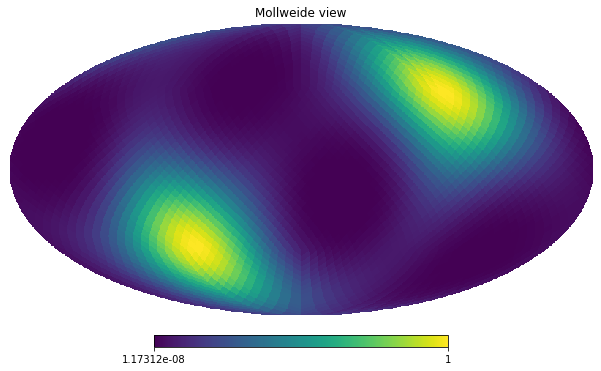

In [50]:
hp.mollview(np.diag(HL_simple_fisher_broad/np.max(np.abs(np.diag(HL_simple_fisher_broad)))))

## Point source

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

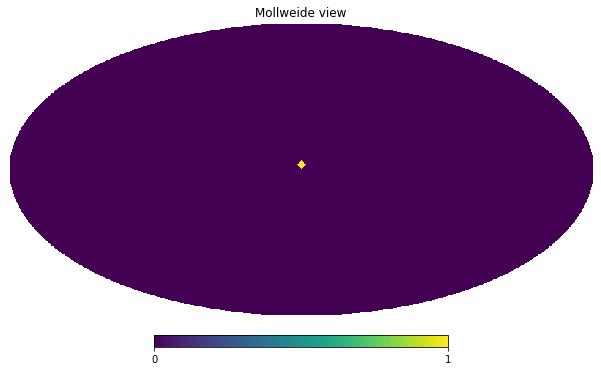

In [18]:
intensity = 1
source = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.1) & (phi==0.)]=intensity #ok for nside >8
#source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.2) & (phi==0.)]=intensity #ok for nside <=8
else:
    source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.05) & (phi==0.)]=intensity #ok for nside >32
#print(source[source ==intensity])

hp.mollview(source)

In [52]:
#HL_simple_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source)\
#                                                for f in tqdm(np.logspace(0,3, 100))], axis = 0)

In [53]:
HL_simple_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source)

In [54]:
np.savez(f"HL_real_ORF_teardrop_nside{nside}_dirty_map_1_1000.npz", HL_simple_dirty_broad=HL_simple_dirty_broad)

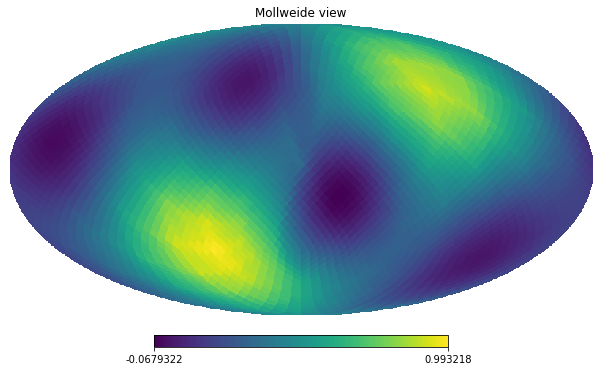

In [55]:
hp.mollview(HL_simple_dirty_broad/np.max(np.abs(HL_simple_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_real_ORF_teardrop_nside{nside}.svg")
plt.savefig(f"HL_real_ORF_teardrop_nside{nside}.pdf")
#plt.savefig(f"HL_real_ORF_teardrop_nside{nside}.eps")


#hp.mollview(HL_simple_dirty_broad/np.max(np.abs(HL_simple_dirty_broad)), rot=(0,0,0), flip = "astro", norm="log")
#plt.savefig(f"HL_real_ORF_teardrop_nside{nside}_log.svg")
#plt.savefig(f"HL_real_ORF_teardrop_nside{nside}_log.pdf")
#plt.savefig(f"HL_real_ORF_teardrop_nside{nside}_log.eps")


## 3-point source

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

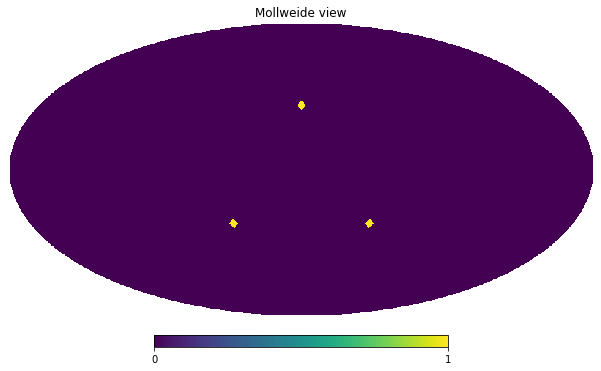

In [56]:
intensity = 1
source_triangle = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source_triangle[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==7*np.pi/4)]=intensity #ok for nside >8
else:
    source_triangle[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_triangle)

In [19]:
#HL_simple_triangle_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source_triangle)\
#                                                for f in tqdm(np.logspace(0,3, 100))], axis = 0)

In [57]:
HL_simple_triangle_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source_triangle)

In [58]:
np.savez(f"HL_real_ORF_triangle_nside{nside}_dirty_map_1_1000.npz", HL_simple_triangle_dirty_broad=HL_simple_triangle_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


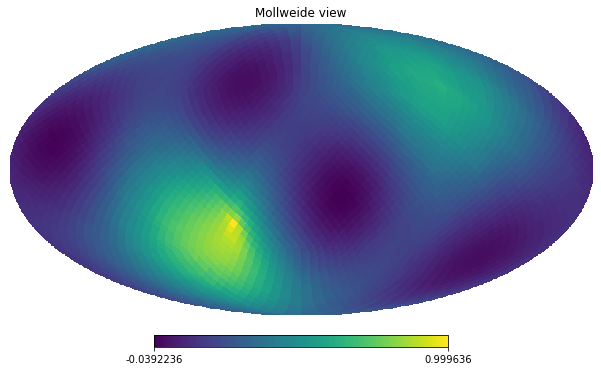

In [59]:
hp.mollview(HL_simple_triangle_dirty_broad/np.max(np.abs(HL_simple_triangle_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_real_ORF_triangle_nside{nside}.svg")
plt.savefig(f"HL_real_ORF_triangle_nside{nside}.pdf")
#plt.savefig(f"HL_real_ORF_triangle_nside{nside}.eps")

## 6-point source

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

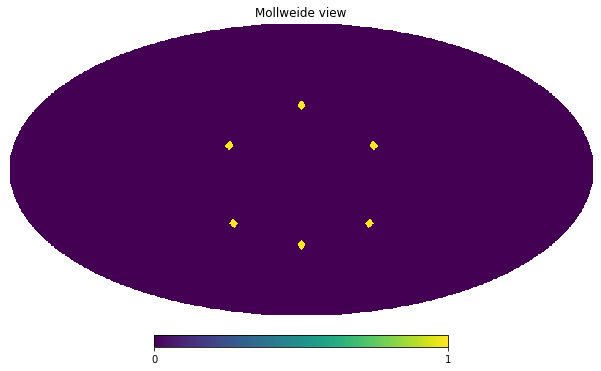

In [60]:
intensity = 1
source_star = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source_star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.1) & (phi==0.)]=intensity #ok for nside >8

else:
    source_star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.15) & (phi==0.)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_star)

In [61]:
#HL_simple_star_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source_star)\
#                                                for f in tqdm(np.logspace(0,3, 100))], axis = 0)

In [62]:
HL_simple_star_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source_star)

In [63]:
np.savez(f"HL_real_ORF_star_nside{nside}_dirty_map_1_1000.npz", HL_simple_star_dirty_broad=HL_simple_star_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


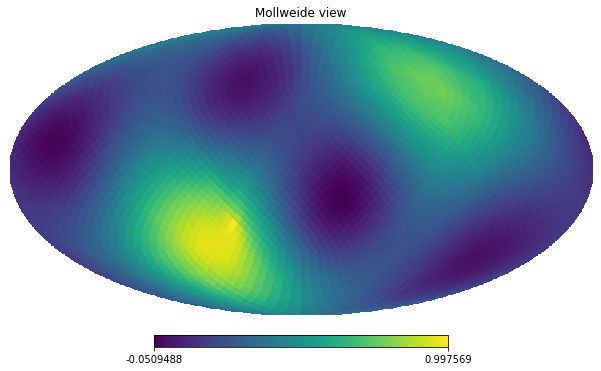

In [64]:
hp.mollview(HL_simple_star_dirty_broad/np.max(np.abs(HL_simple_star_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_real_ORF_star_nside{nside}.svg")
plt.savefig(f"HL_real_ORF_star_nside{nside}.pdf")
#plt.savefig(f"HL_real_ORF_triangle_nside{nside}.eps")

## Dragon ball

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

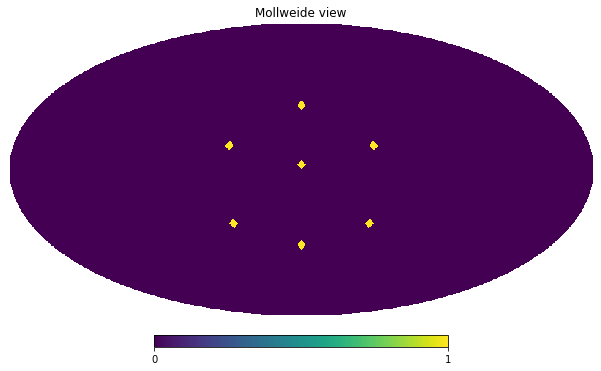

In [65]:
intensity = 1
source_7star = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source_7star[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.1) & (phi==0.)]=intensity #ok for nside >8

else:
    source_7star[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.15) & (phi==0.)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_7star)

In [66]:
HL_simple_7star_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source_7star)

In [67]:
np.savez(f"HL_real_ORF_7star_nside{nside}_dirty_map_1_1000.npz", HL_simple_7star_dirty_broad=HL_simple_7star_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


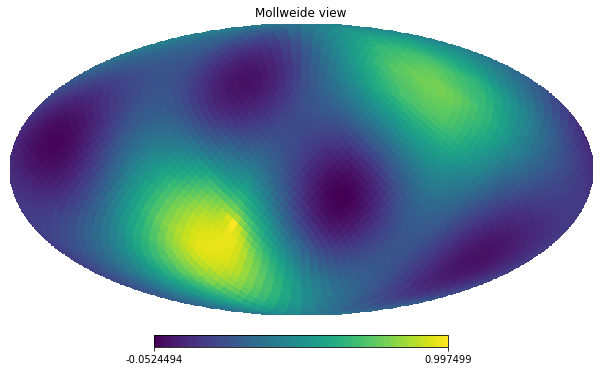

In [68]:
hp.mollview(HL_simple_7star_dirty_broad/np.max(np.abs(HL_simple_7star_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_real_ORF_7star_nside{nside}.svg")
plt.savefig(f"HL_real_ORF_7star_nside{nside}.pdf")
#plt.savefig(f"HL_real_ORF_triangle_nside{nside}.eps")

## N-point sources HLV network 

In [19]:
F_H = Antenna_patterns_small(0, theta, phi, u_H, v_H , L_H)
F_L = Antenna_patterns_small(0, theta, phi, u_L, v_L , L_L)
F_V = Antenna_patterns_small(0, theta, phi, u_V, v_V , L_V)
F_K = Antenna_patterns_small(0, theta, phi, u_K, v_K , L_K)
F_I = Antenna_patterns_small(0, theta, phi, u_I, v_I , L_I)

geom_fact_HL = np.sum(F_L*np.conjugate(F_H), axis = 0)
geom_fact_HV = np.sum(F_V*np.conjugate(F_H), axis = 0)
geom_fact_LV = np.sum(F_V*np.conjugate(F_L), axis = 0)
geom_fact_HK = np.sum(F_K*np.conjugate(F_H), axis = 0)
geom_fact_LK = np.sum(F_K*np.conjugate(F_L), axis = 0)
geom_fact_VK = np.sum(F_K*np.conjugate(F_V), axis = 0)
geom_fact_HI = np.sum(F_I*np.conjugate(F_H), axis = 0)
geom_fact_LI = np.sum(F_I*np.conjugate(F_L), axis = 0)
geom_fact_VI = np.sum(F_I*np.conjugate(F_V), axis = 0)
geom_fact_KI = np.sum(F_I*np.conjugate(F_K), axis = 0)

In [79]:
dx_IJ = [x_H-x_L, x_H-x_V, x_L-x_V]
geom_fact_IJ = [geom_fact_HL, geom_fact_HV, geom_fact_LV]
baselines = ["HL", "HV", "LV", ]
fnames = [f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]

In [80]:
for dx, geom_fact, fname in zip(dx_IJ, geom_fact_IJ, fnames):
    print(fname)
    orf = 0.5*geom_fact*np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
    #print(np.shape(orf))
    #print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

    orf = orf.reshape(-1, *orf.shape[-1:])
    orf_star = np.conjugate(orf)
    
    simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    
    np.savez(fname, simple_fisher_broad=simple_fisher_broad)

HL_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
HV_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
LV_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)


In [81]:
HLV_simple_fisher_broad = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
for fname in fnames:
    HLV_simple_fisher_broad += np.load(fname)["simple_fisher_broad"]
np.savez(f"HLV_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz", simple_fisher_broad=HLV_simple_fisher_broad)

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

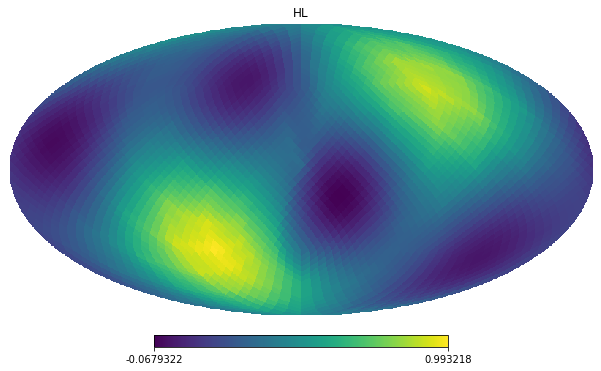

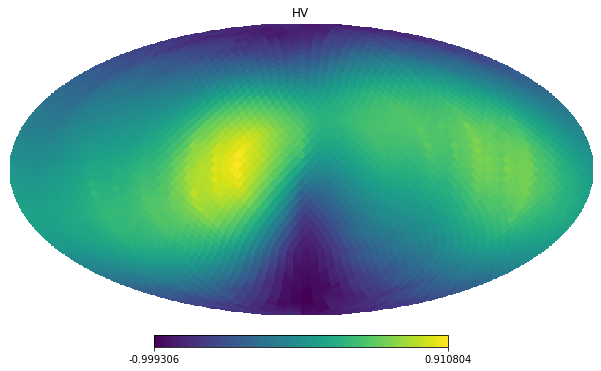

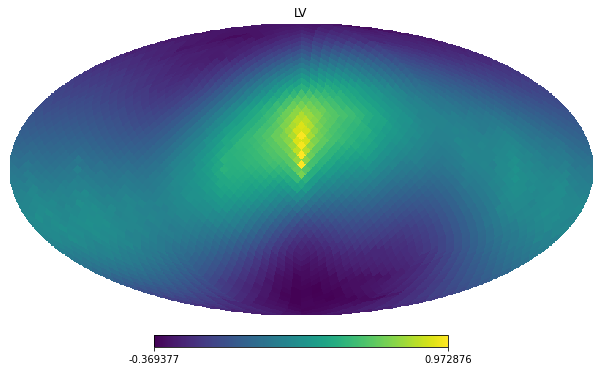

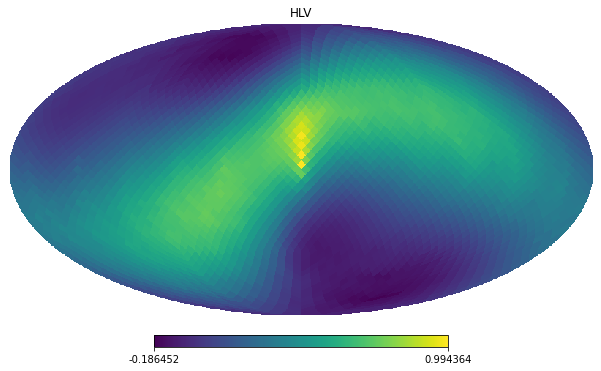

In [82]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_teardrop_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_teardrop_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

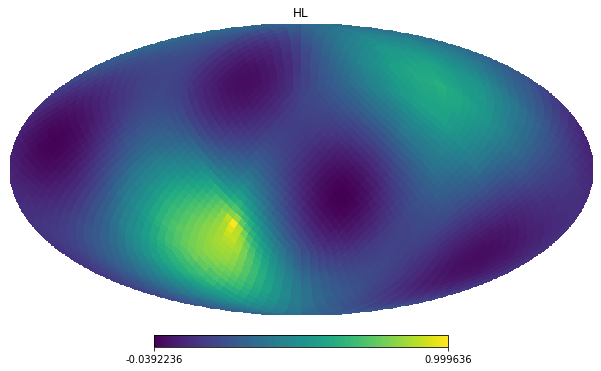

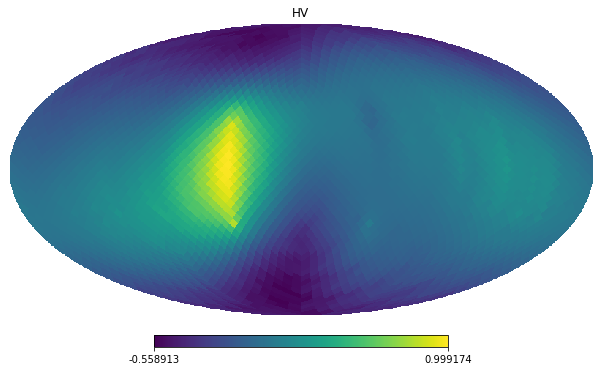

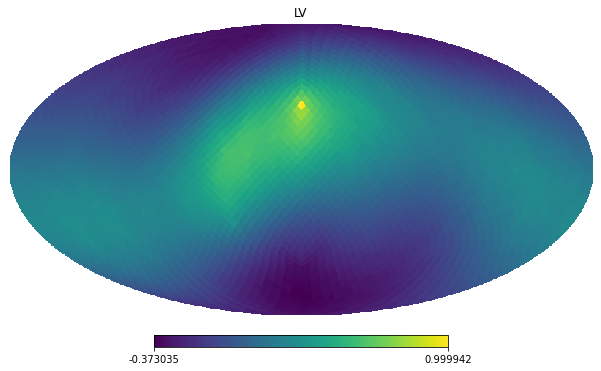

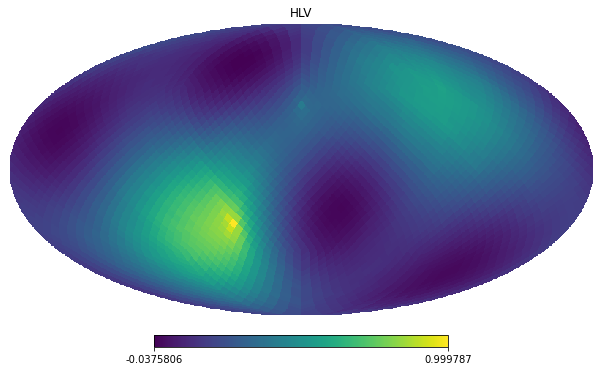

In [83]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_triangle)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_triangle_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_triangle_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

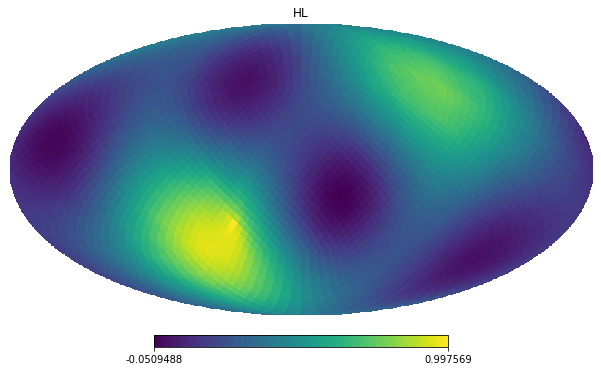

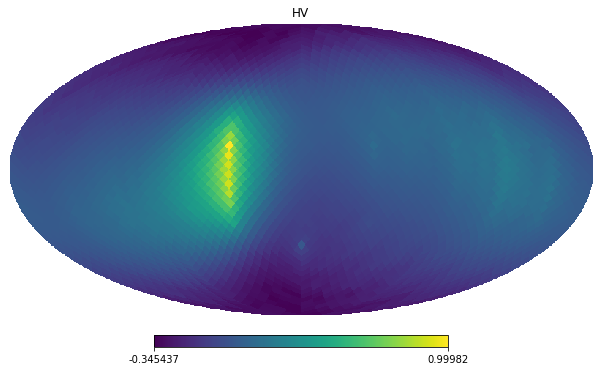

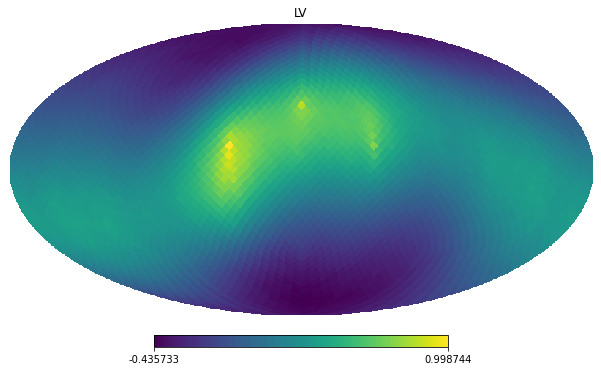

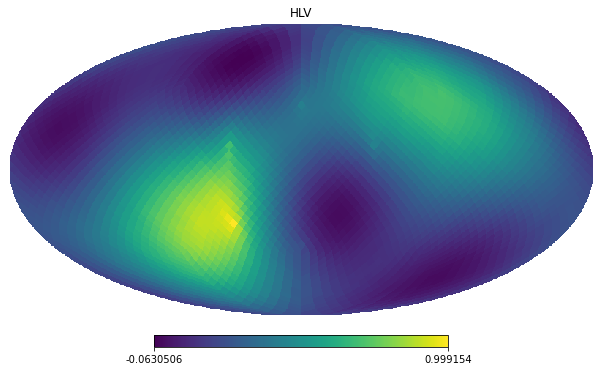

In [84]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_star_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

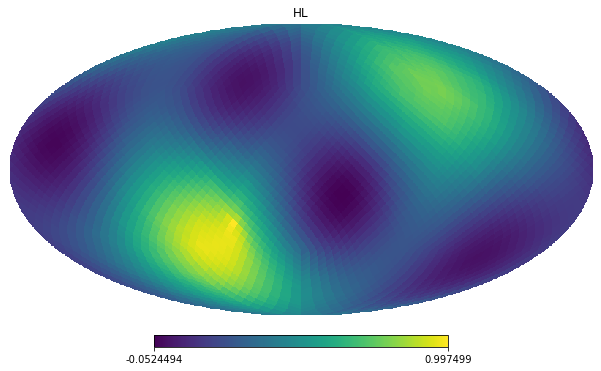

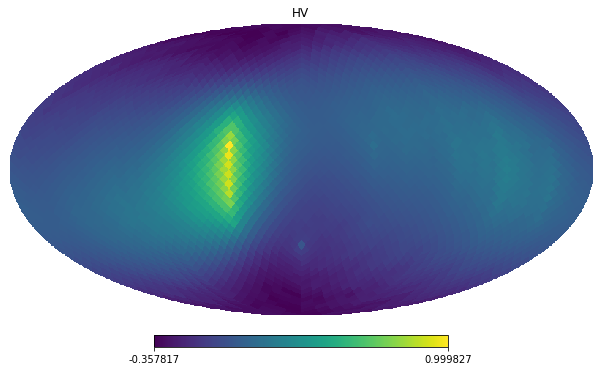

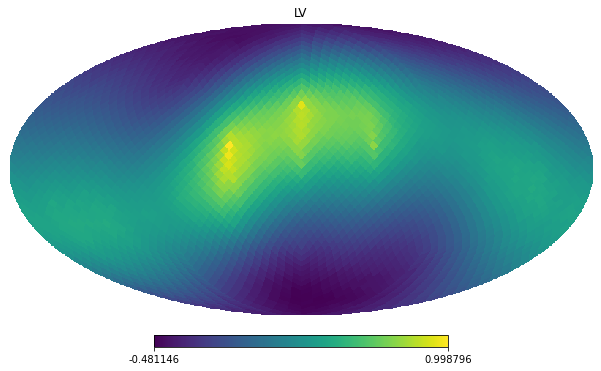

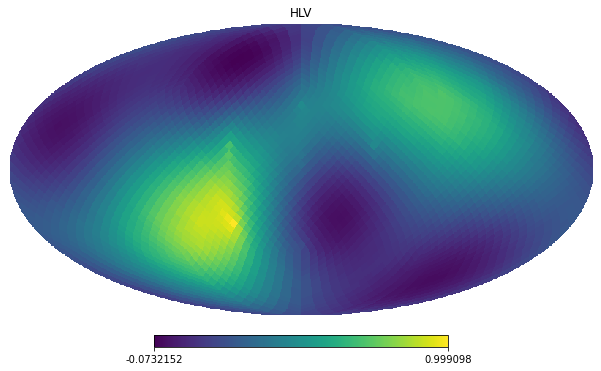

In [85]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_7star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_7star_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_7star_nside{nside}.pdf")

## N-point sources HLVK network 

In [86]:
dx_IJ = [x_H-x_K, x_L-x_K, x_V-x_K]
geom_fact_IJ = [geom_fact_HK, geom_fact_LK, geom_fact_VK]
baselines = ["HK", "LK", "VK", ]
fnames = [f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]

In [87]:
for dx, geom_fact, fname in zip(dx_IJ, geom_fact_IJ, fnames):
    print(fname)
    orf = 0.5*geom_fact*np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
    #print(np.shape(orf))
    #print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

    orf = orf.reshape(-1, *orf.shape[-1:])
    orf_star = np.conjugate(orf)
    
    simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    
    np.savez(fname, simple_fisher_broad=simple_fisher_broad)

HK_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
LK_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
VK_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)


In [88]:
HLVK_simple_fisher_broad = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
baselines = ["HL", "HV", "LV","HK", "LK", "VK", ]
fnames = [f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]
for fname in fnames:
    HLVK_simple_fisher_broad += np.load(fname)["simple_fisher_broad"]
np.savez(f"HLVK_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz", simple_fisher_broad=HLVK_simple_fisher_broad)

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

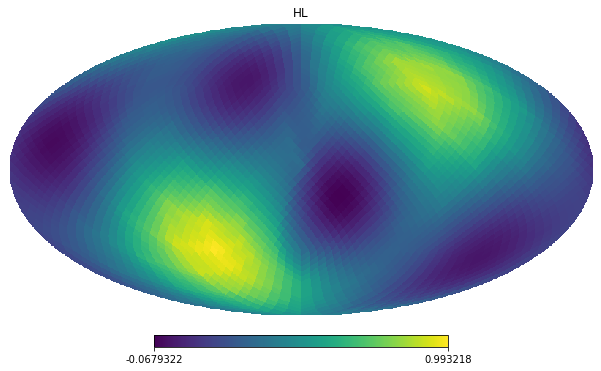

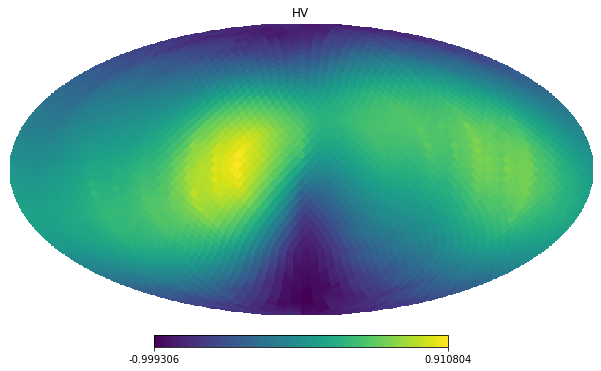

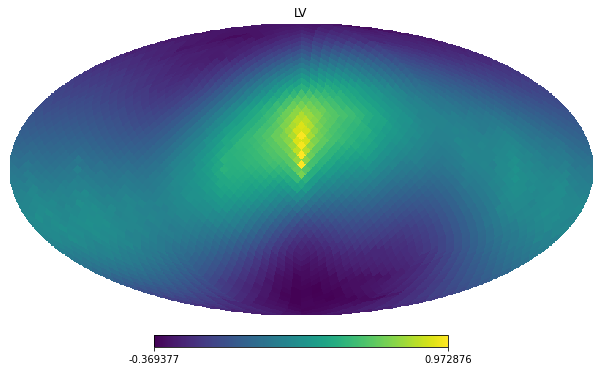

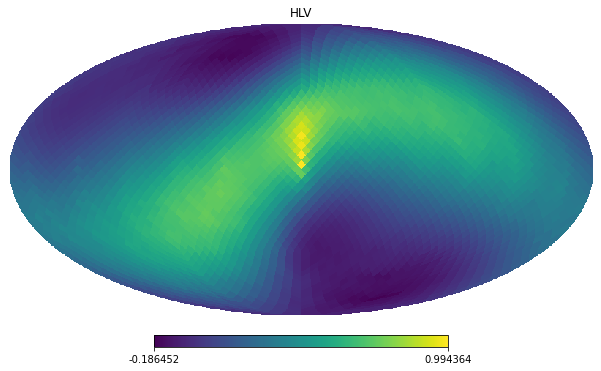

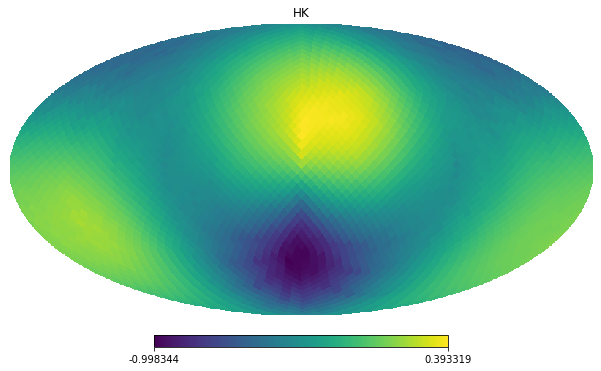

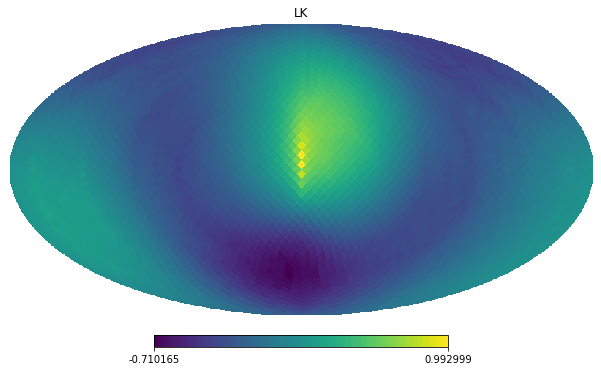

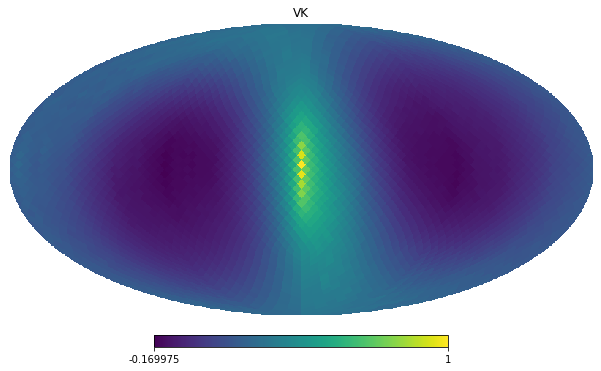

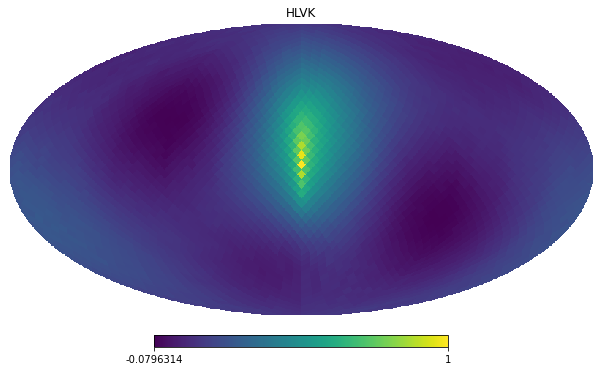

In [89]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_teardrop_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_teardrop_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

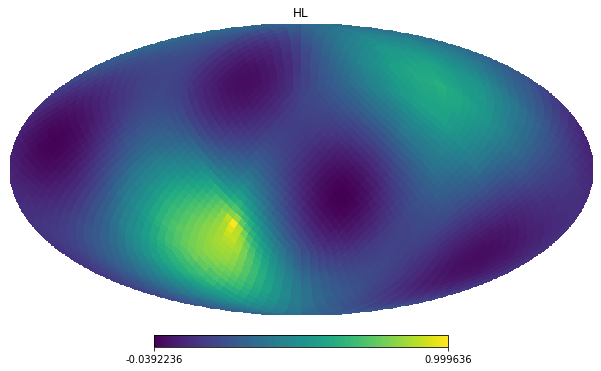

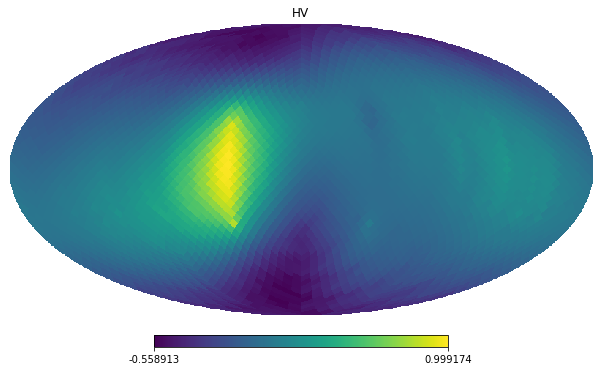

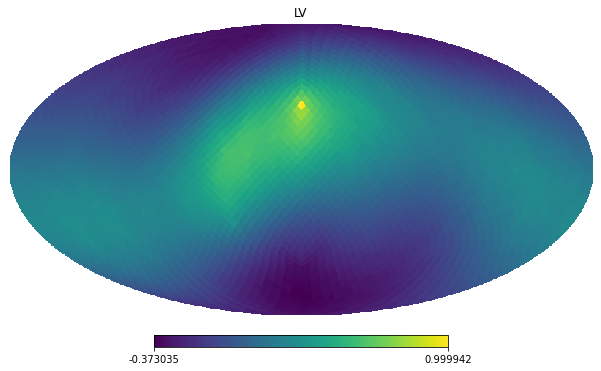

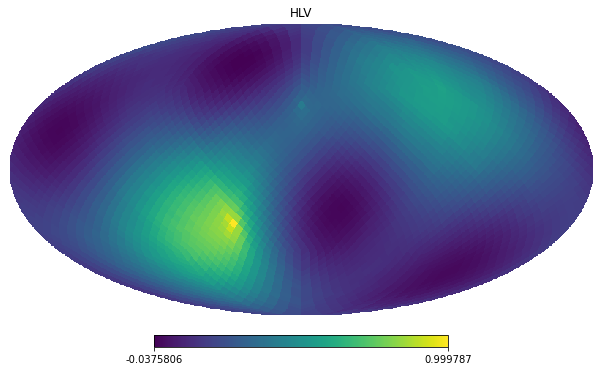

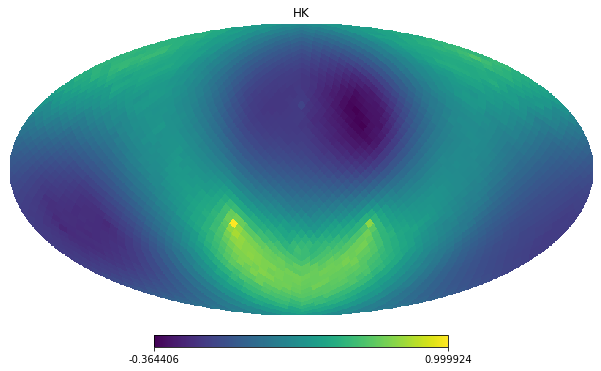

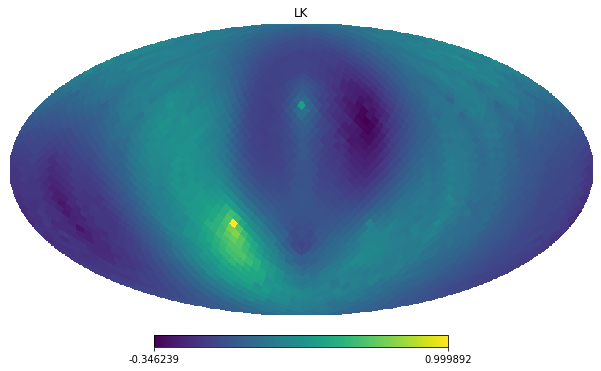

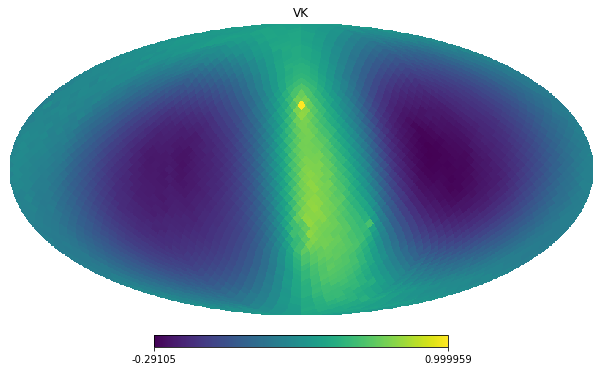

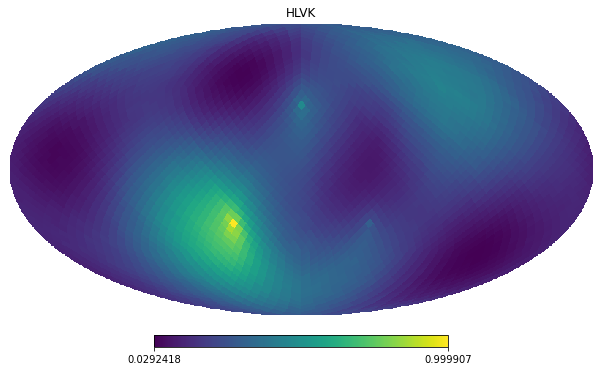

In [90]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_triangle)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_triangle_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_triangle_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

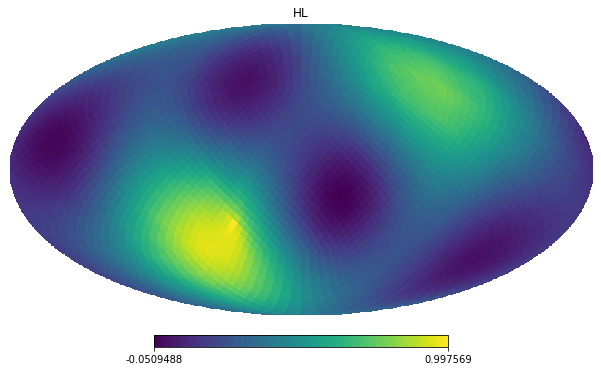

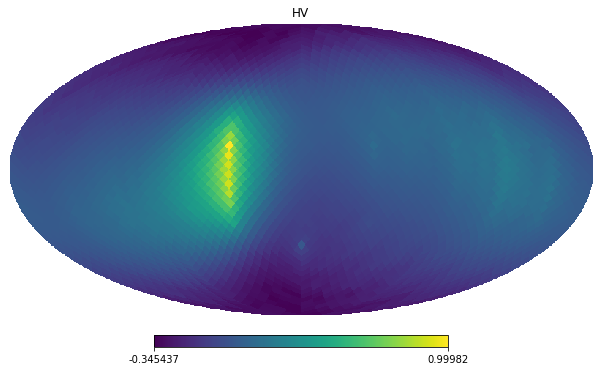

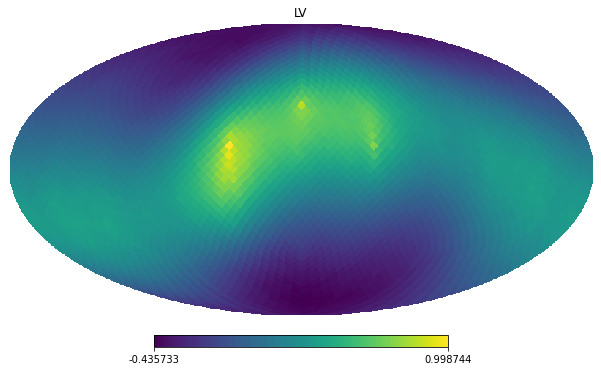

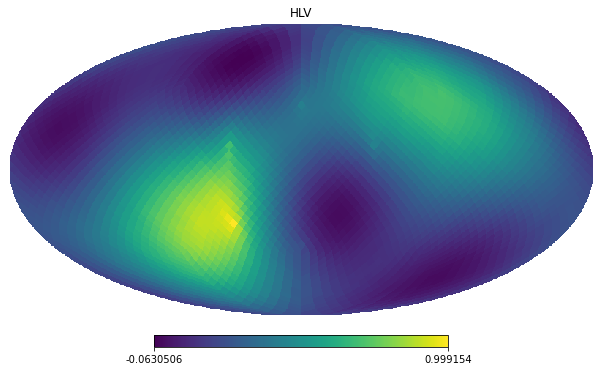

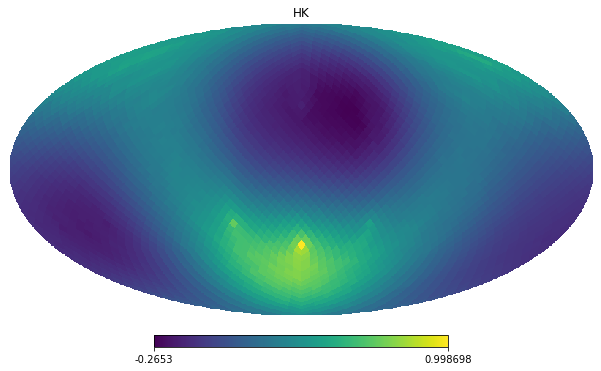

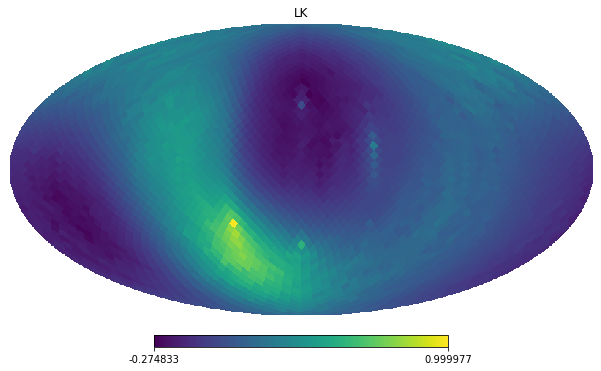

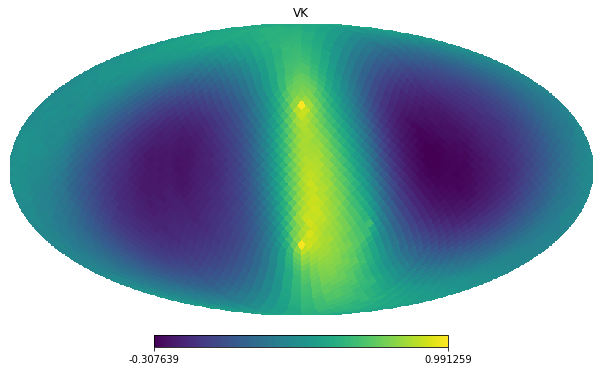

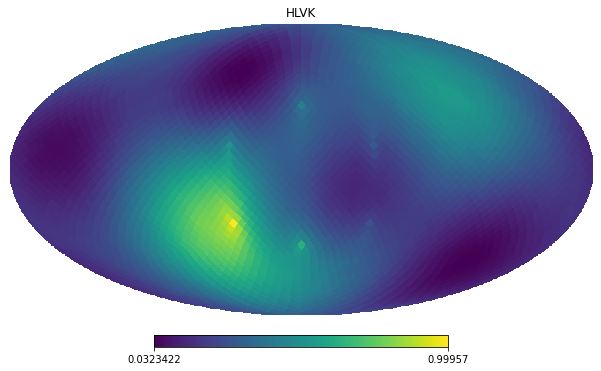

In [91]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_star_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

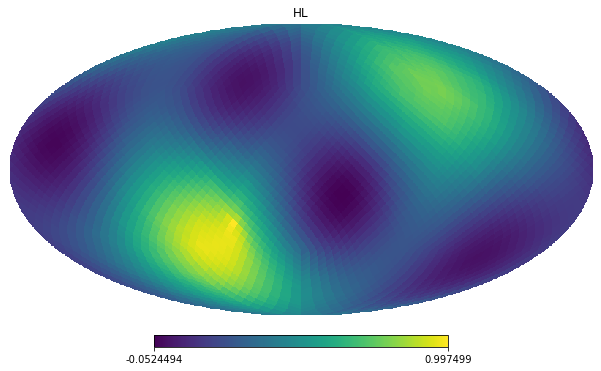

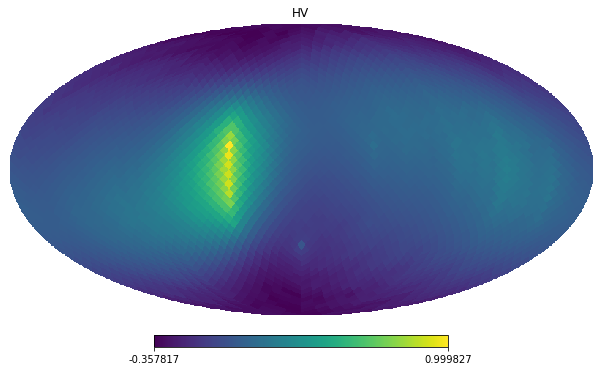

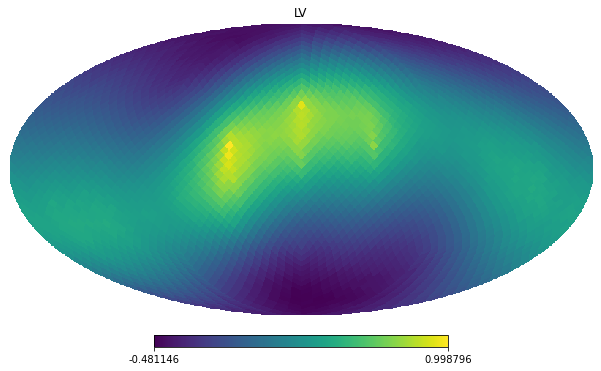

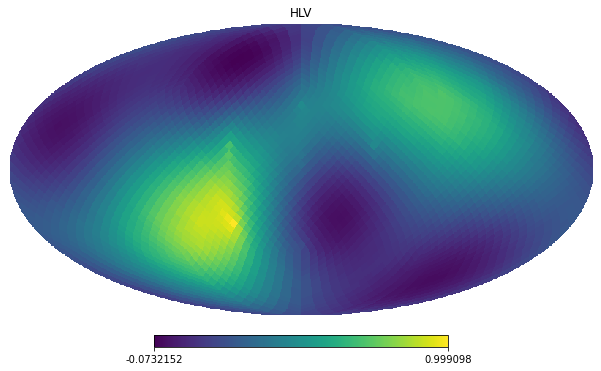

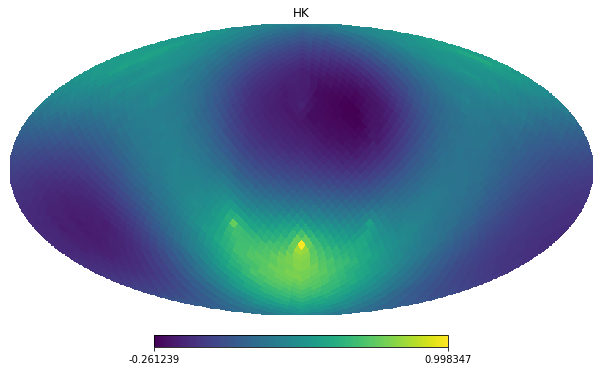

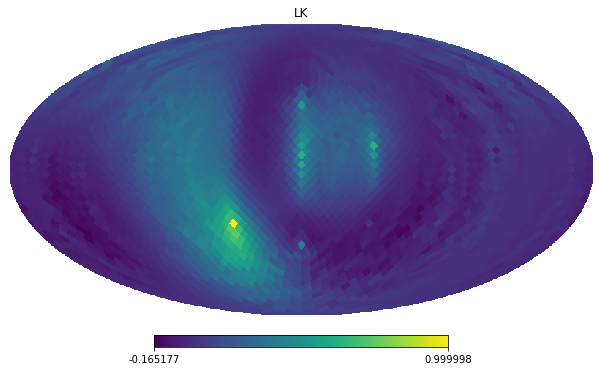

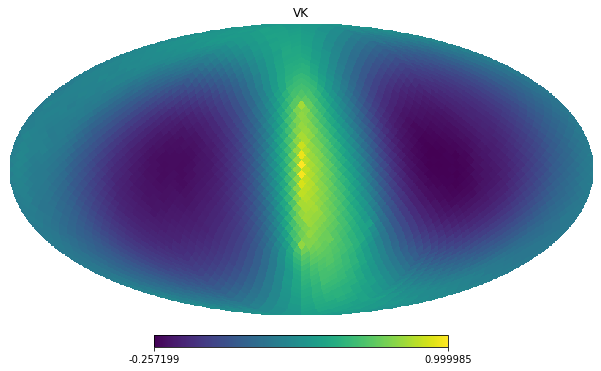

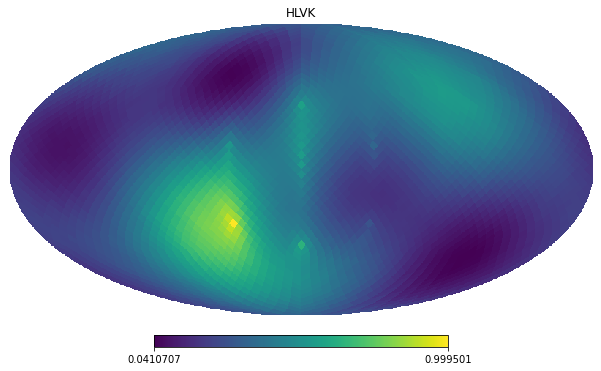

In [92]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_7star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_7star_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_7star_nside{nside}.pdf")

## N-point sources HLVKI network 

In [93]:
dx_IJ = [x_H-x_I, x_L-x_I, x_V-x_I, x_K-x_I]
geom_fact_IJ = [geom_fact_HI, geom_fact_LI, geom_fact_VI, geom_fact_KI]
baselines = ["HI", "LI", "VI", "KI"]
fnames = [f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]

In [94]:
for dx, geom_fact, fname in zip(dx_IJ, geom_fact_IJ, fnames):
    print(fname)
    orf = 0.5*geom_fact*np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
    #print(np.shape(orf))
    #print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

    orf = orf.reshape(-1, *orf.shape[-1:])
    orf_star = np.conjugate(orf)
    
    simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    
    np.savez(fname, simple_fisher_broad=simple_fisher_broad)

HI_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
LI_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
VI_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
KI_real_ORF_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)


In [95]:
HLVKI_simple_fisher_broad = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
baselines = ["HL", "HV", "LV","HK", "LK", "VK", "HI", "LI", "VI", "KI"]
fnames = [f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]
for fname in fnames:
    HLVKI_simple_fisher_broad += np.load(fname)["simple_fisher_broad"]
np.savez(f"HLVKI_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz", simple_fisher_broad=HLVKI_simple_fisher_broad)

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

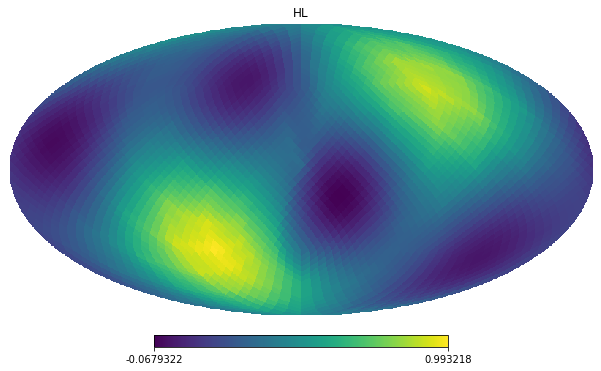

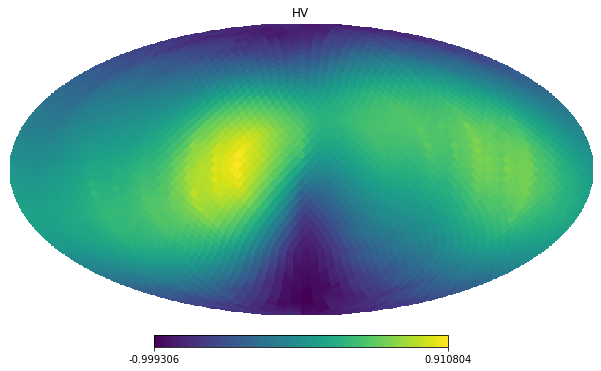

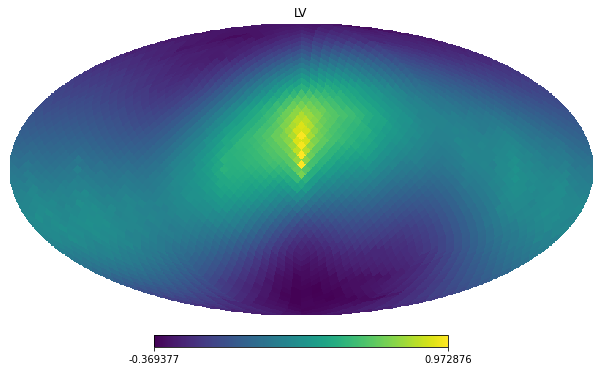

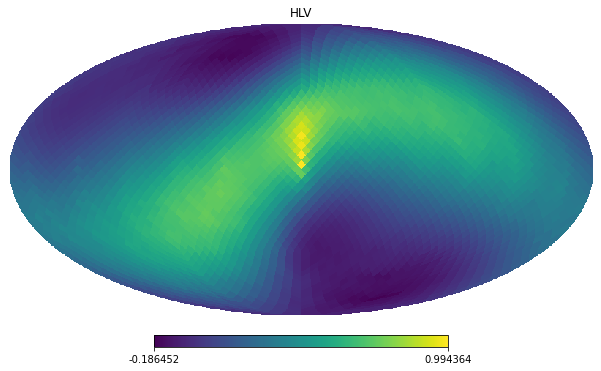

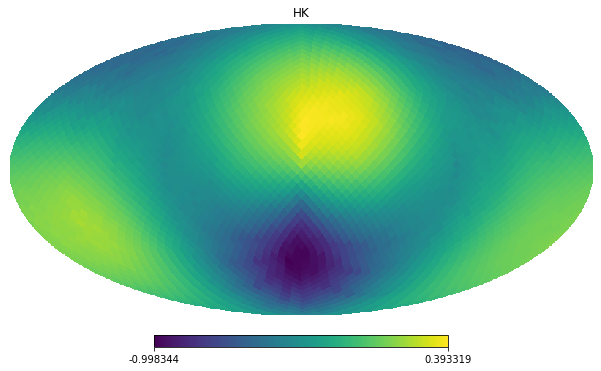

...

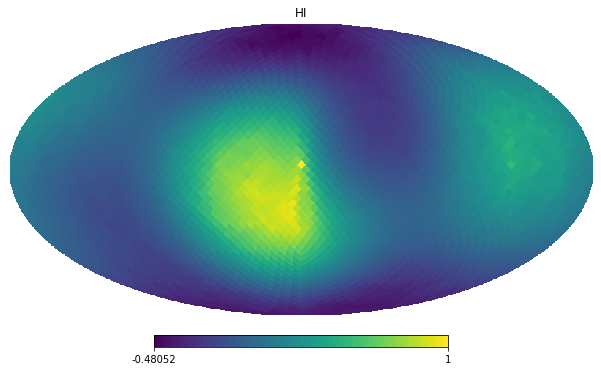

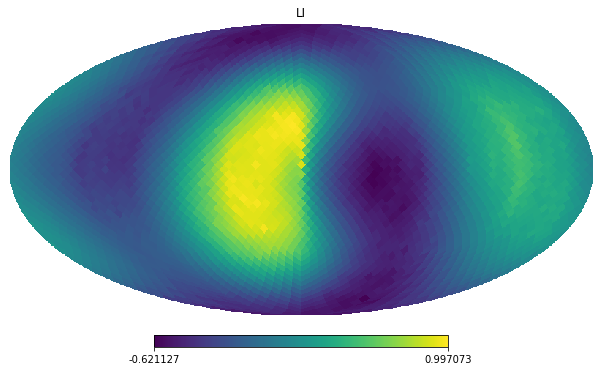

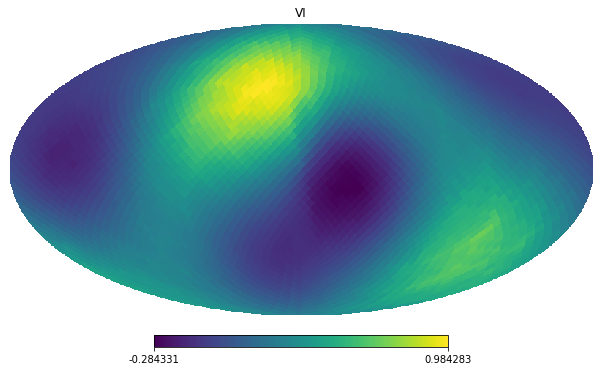

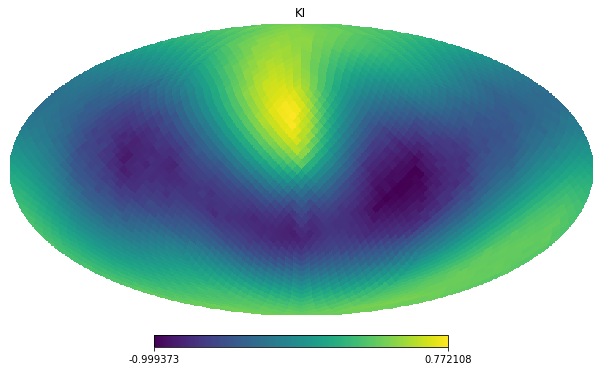

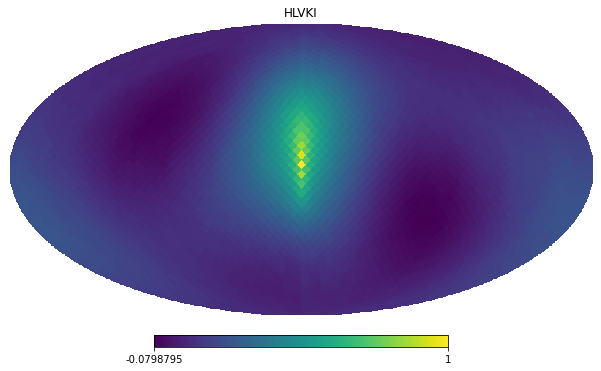

In [96]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_teardrop_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_teardrop_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

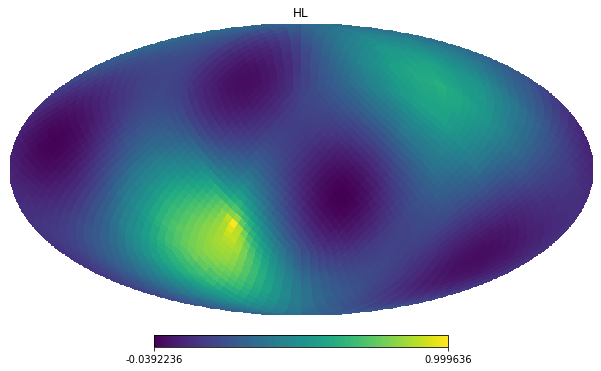

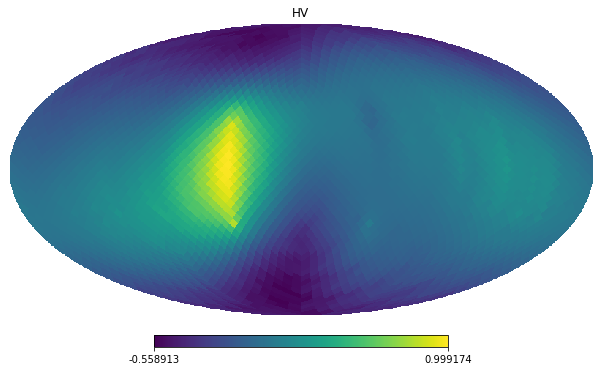

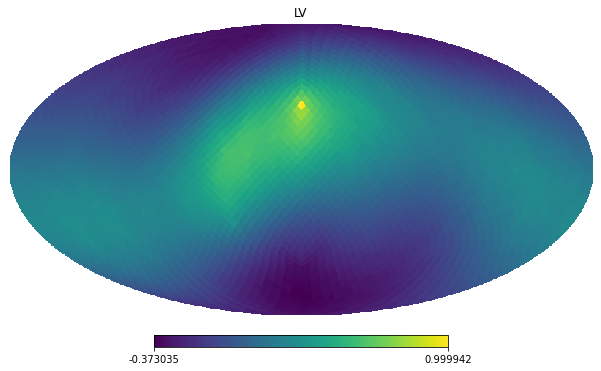

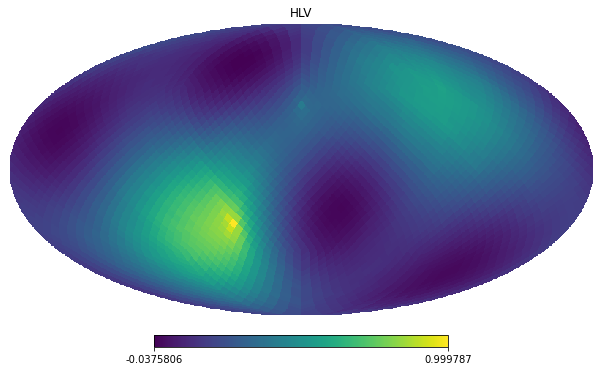

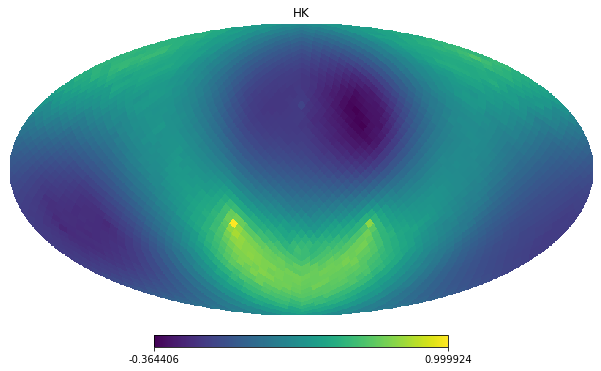

...

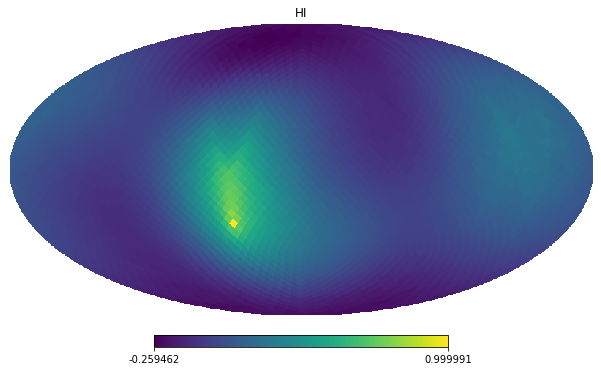

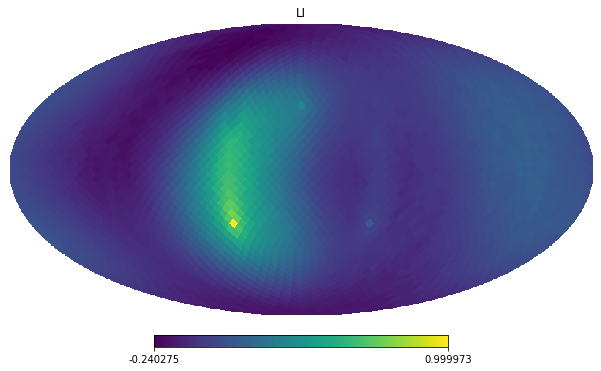

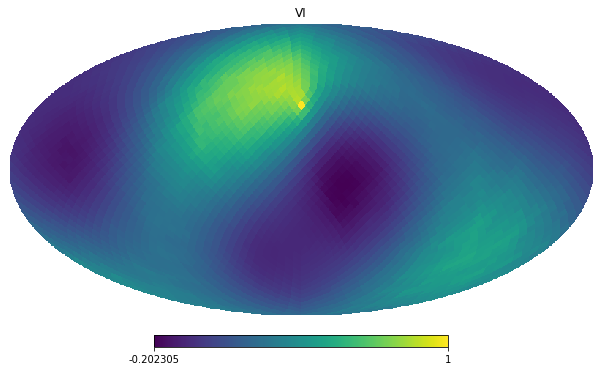

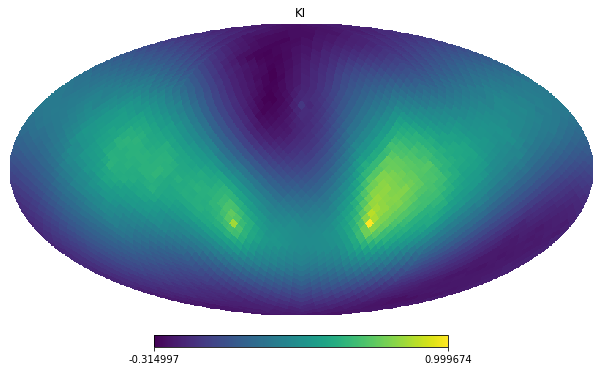

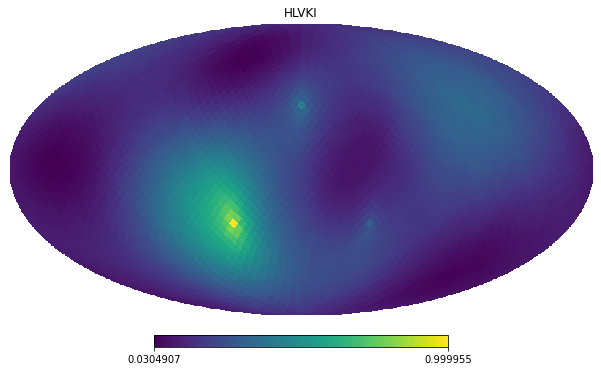

In [97]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_triangle)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_triangle_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_triangle_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

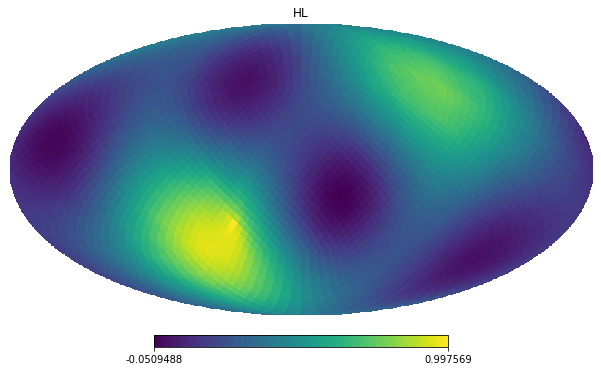

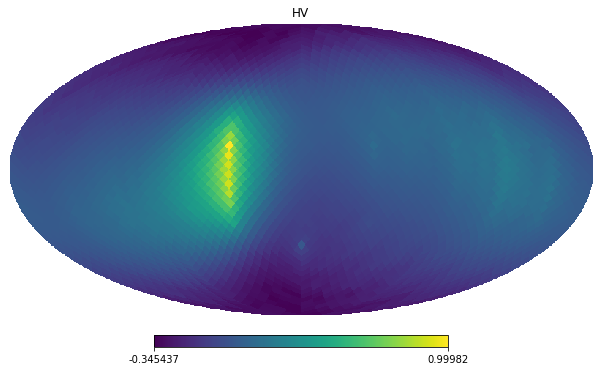

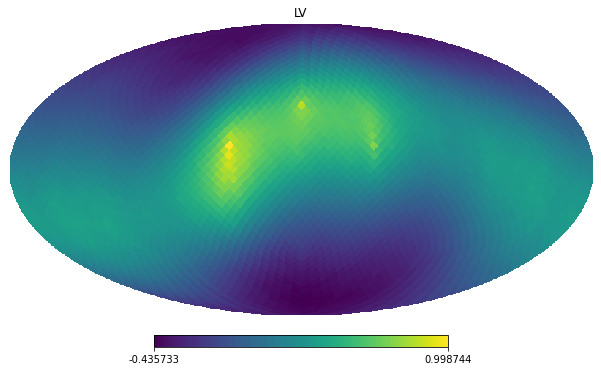

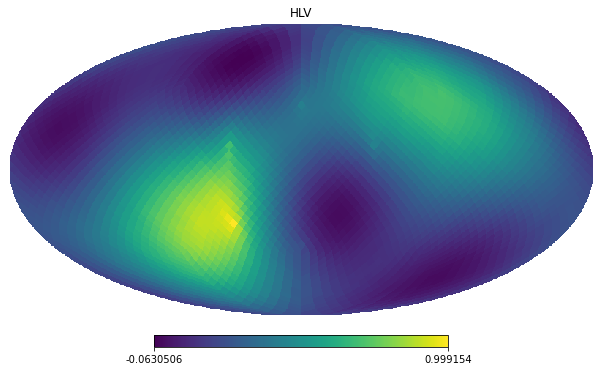

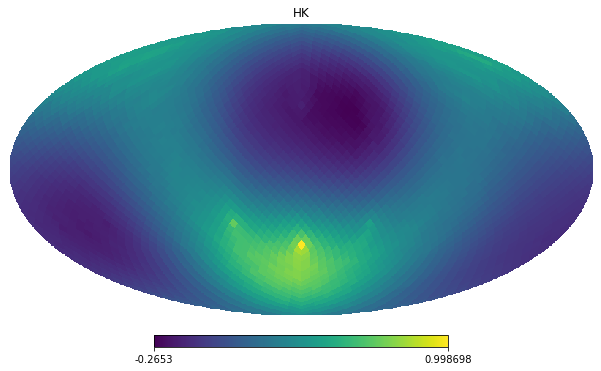

...

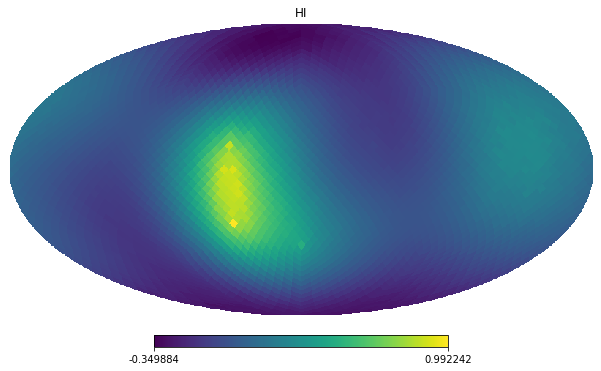

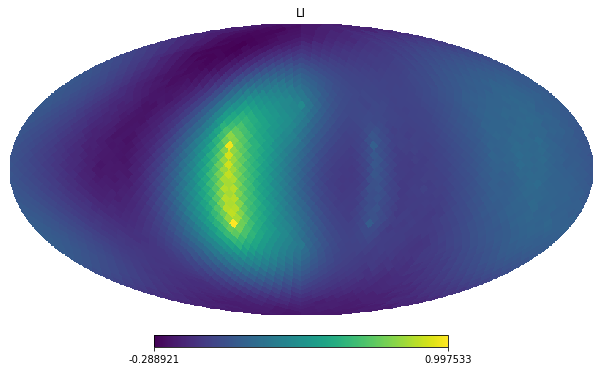

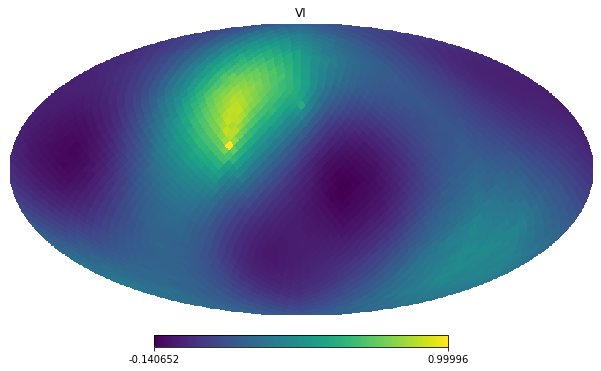

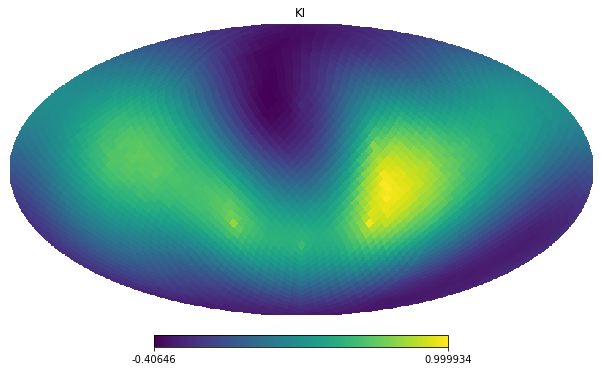

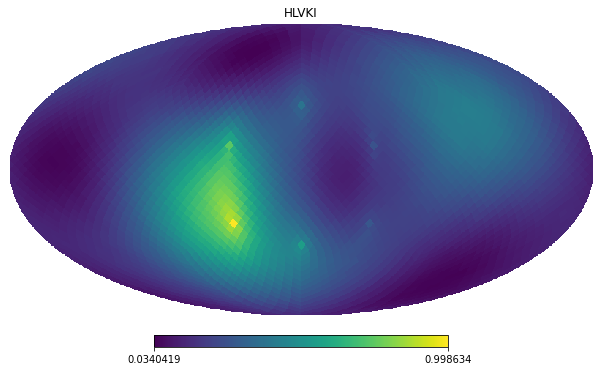

In [98]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_star_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

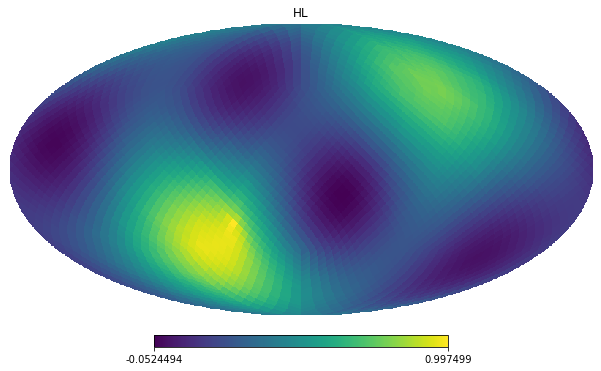

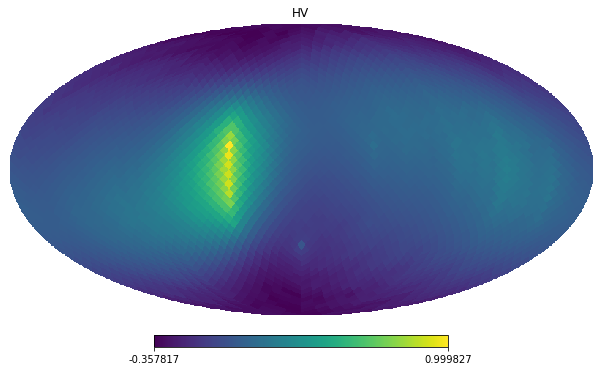

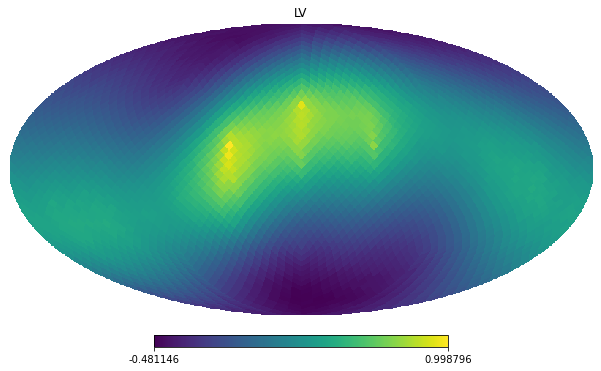

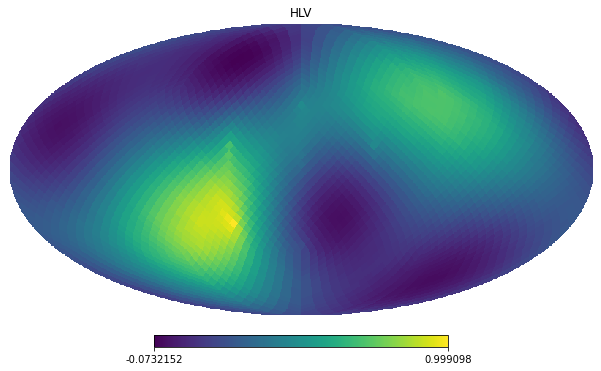

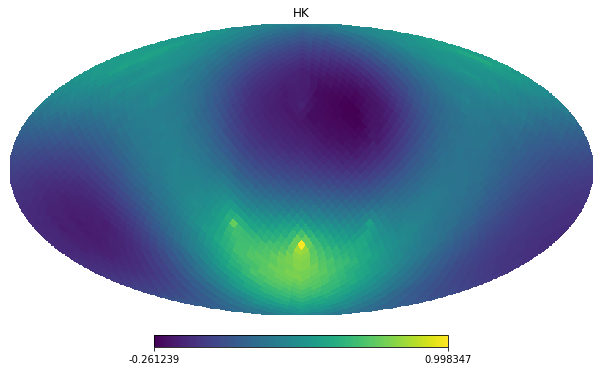

...

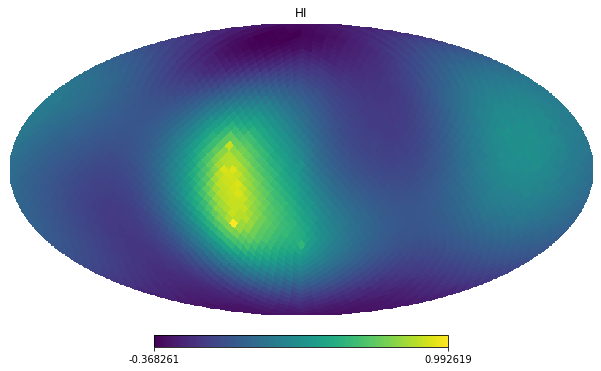

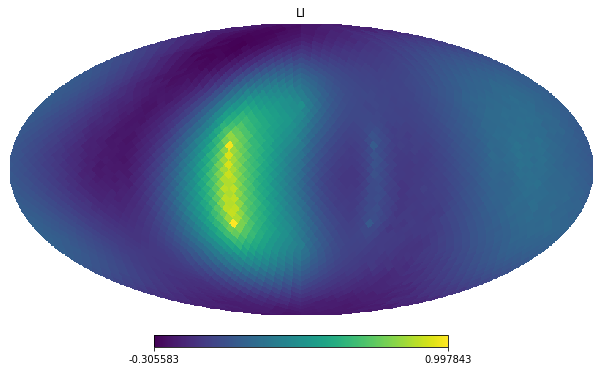

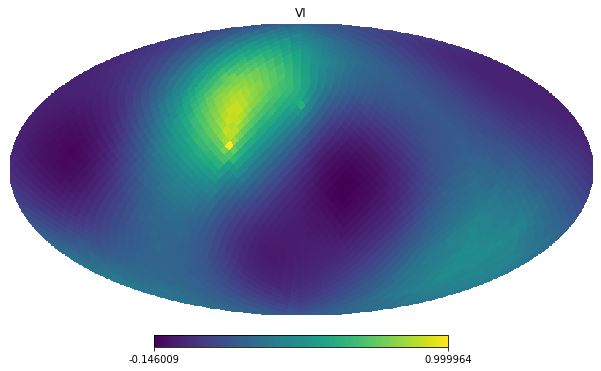

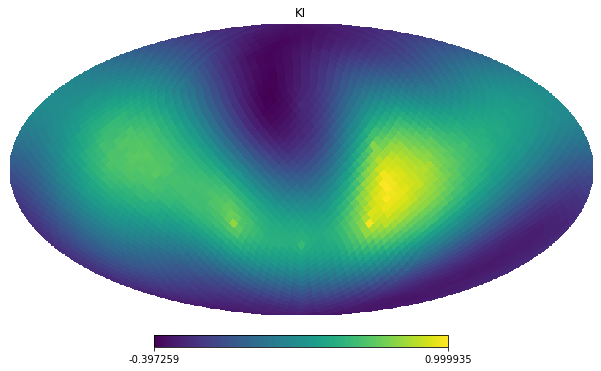

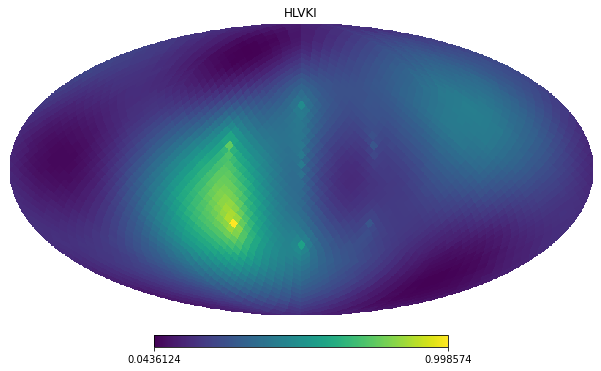

In [99]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_real_ORF_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_7star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_real_ORF_7star_nside{nside}.svg")
    plt.savefig(f"{b}_real_ORF_7star_nside{nside}.pdf")

# Animation

Current strategy: 
Save png and convert to .gif using `ffmpeg -framerate 3 -i %d.png output.gif`

In [100]:
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

In [101]:
f = 375

orf = 0.5*geom_fact*np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf))

(24, 3072) (24, 3072)


In [104]:
orf = 0.5*geom_fact*np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=0, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
fisher_animation_single_time = simple_fisher_numba_single_time_delay(list(orf), list(orf_star))

orf = 0.5*geom_fact*np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
fisher_animation = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))

(3072, 3072)


In [105]:
dirty_animation_single_time = np.einsum("ij, j", fisher_animation_single_time, source)

dirty_animation = np.einsum("ij, j", fisher_animation, source)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

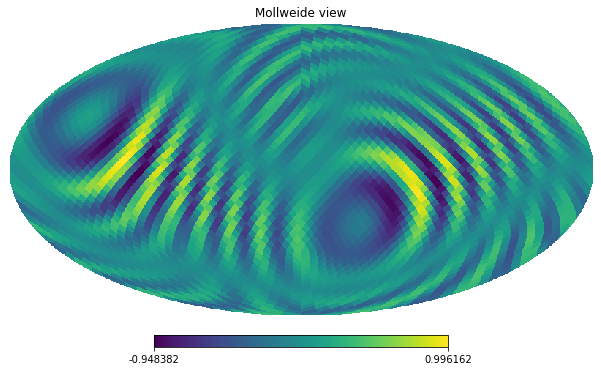

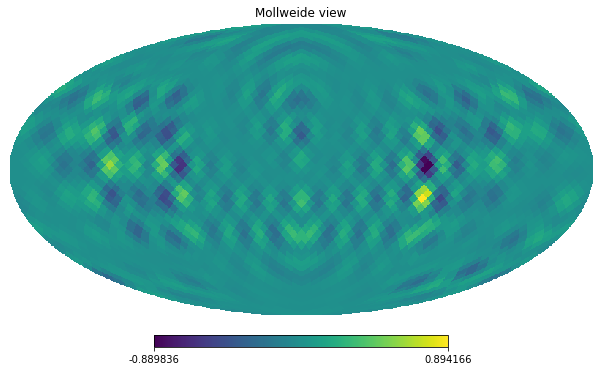

In [106]:
hp.mollview(dirty_animation_single_time/np.max(np.abs(dirty_animation_single_time)))

hp.mollview(dirty_animation/np.max(np.abs(dirty_animation)))

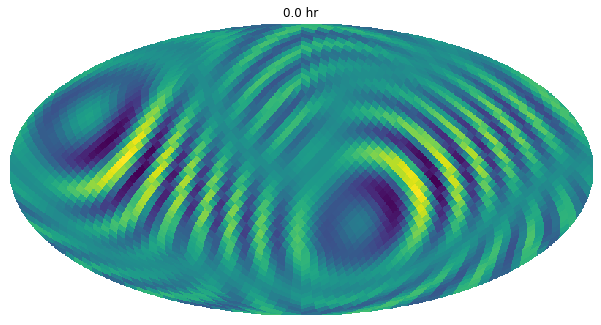

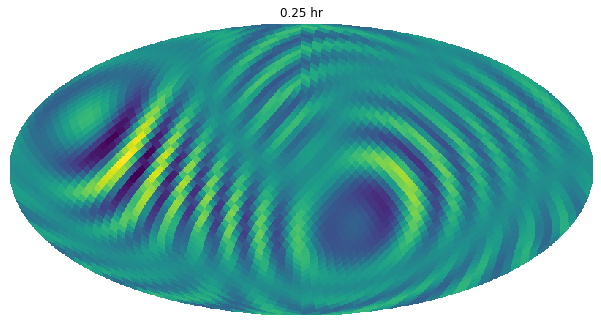

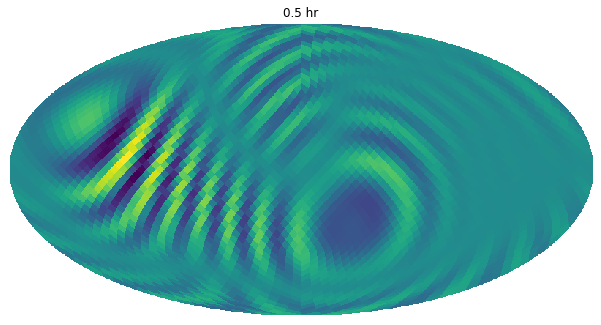

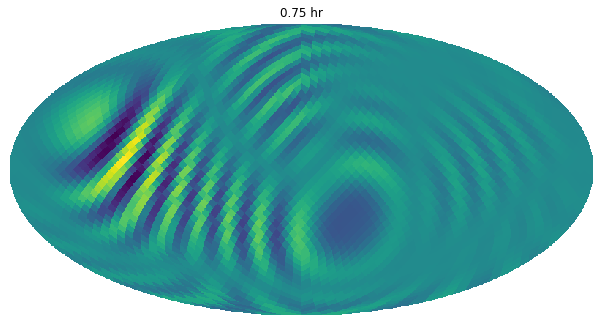

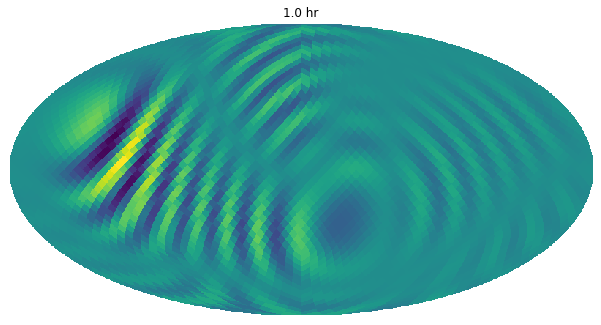

...

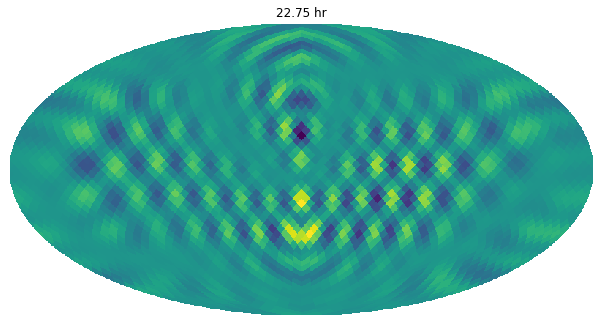

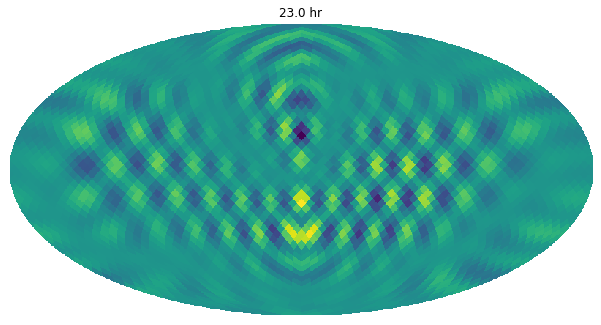

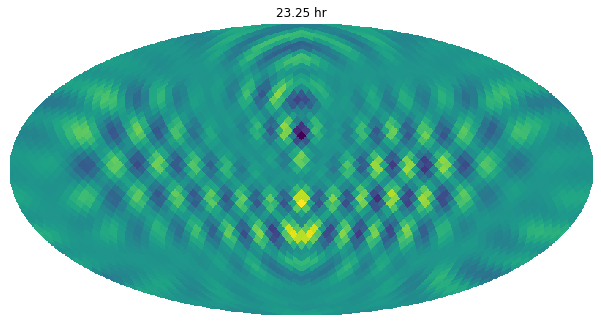

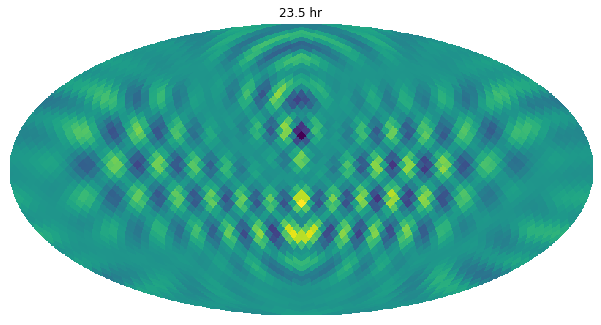

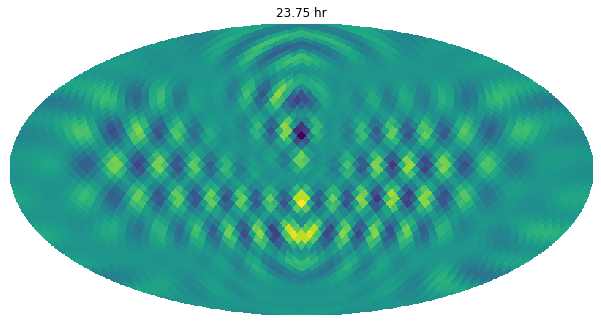

In [107]:
#cumulative_dirty = np.zeros(hp.nside2npix(nside), dtype="complex128")
cumulative_fisher = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
for i, t in enumerate(np.arange(0, 86400, 900)):
    orf = 0.5*geom_fact*np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=t, t0=0), n_hat(theta, phi))/c)
    orf_star = np.conjugate(orf)
    
    cumulative_fisher += simple_fisher_numba_single_time_delay(list(orf), list(orf_star))
    cumulative_dirty = np.einsum("ij,j", cumulative_fisher, source)
    hp.mollview(cumulative_dirty, title = f"{t/3600} hr", cbar = False)
    #if i<100 and i>10:
    #    num = f"0{i}"
    #elif i<10:
    #    num = f"00{i}"
    #else:
    num = f"{i}"
    #plt.savefig(f"./Animation/Single_frequency_real_ORF/{num}.svg", bbox_inches='tight')
    plt.savefig(f"./Animation/Single_frequency_real_ORF/{num}.png", dpi = 300, bbox_inches='tight')
    plt.show()
    plt.close()

(3072, 3072)


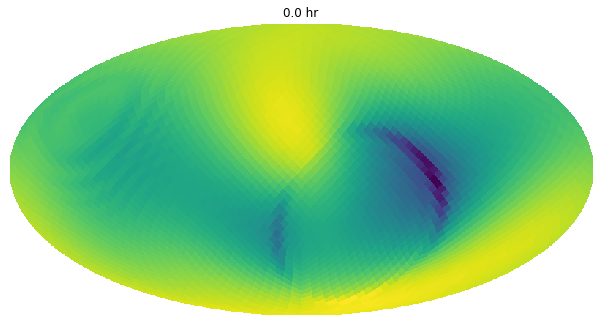

(3072, 3072)


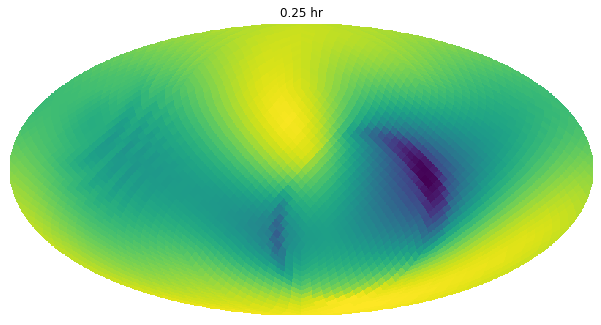

(3072, 3072)


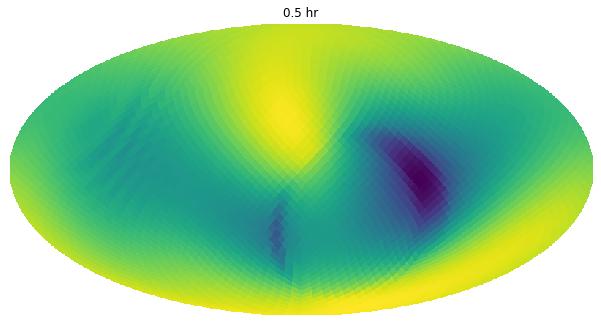

(3072, 3072)


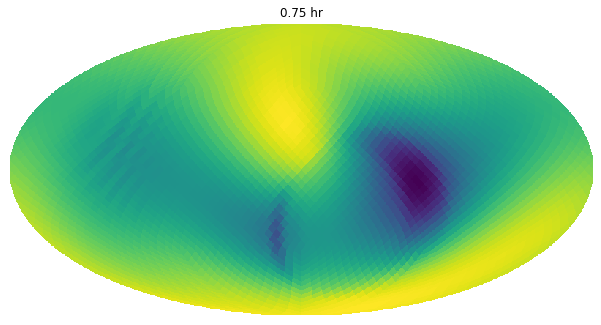

(3072, 3072)


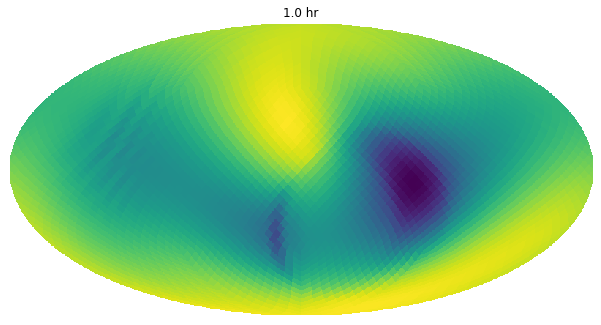

(3072, 3072)


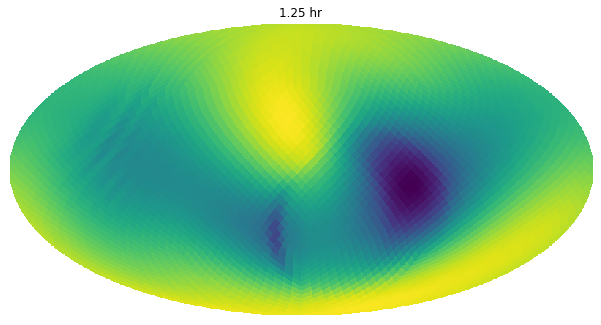

(3072, 3072)


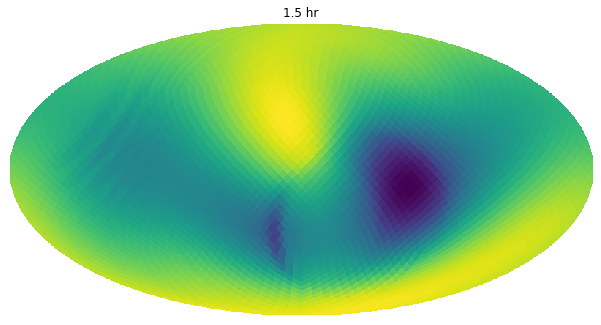

(3072, 3072)


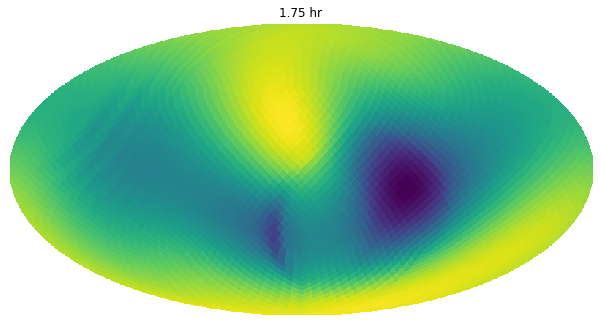

(3072, 3072)


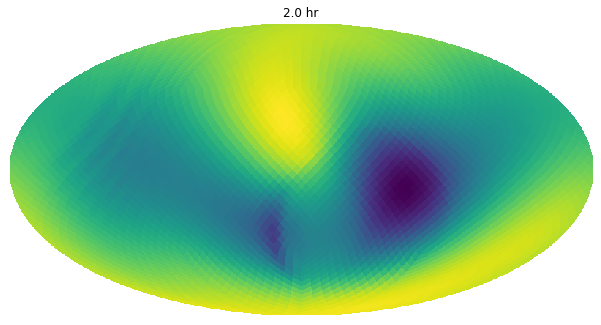

(3072, 3072)


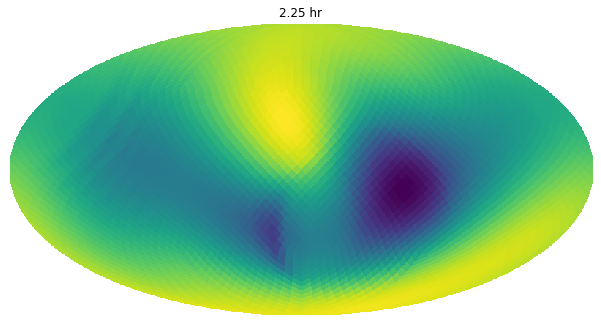

(3072, 3072)


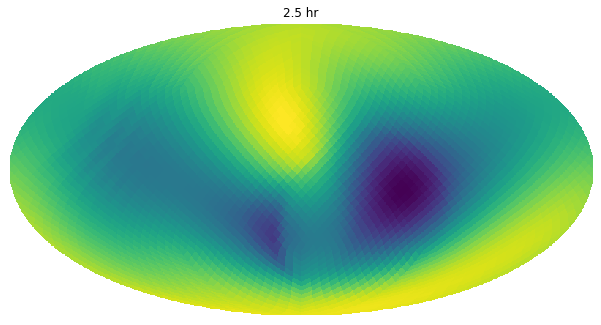

(3072, 3072)


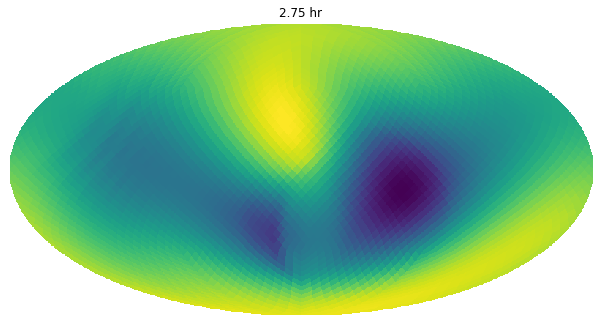

(3072, 3072)


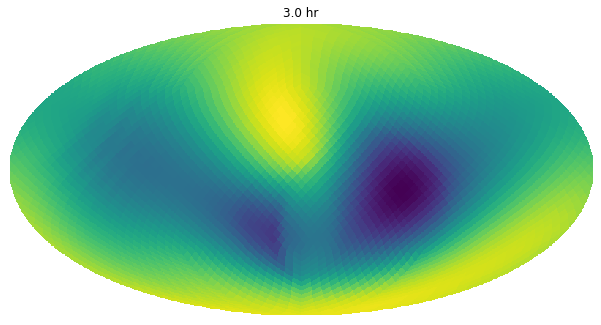

(3072, 3072)


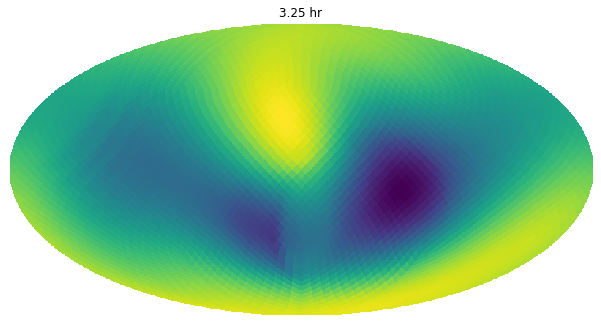

(3072, 3072)


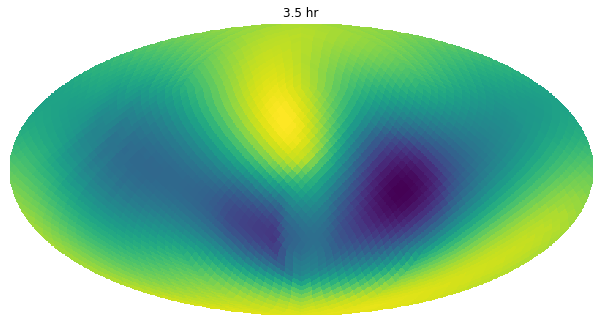

(3072, 3072)


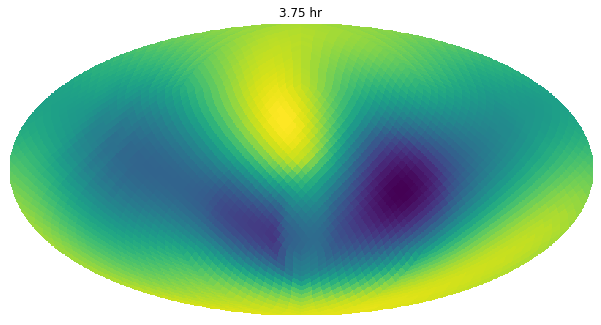

(3072, 3072)


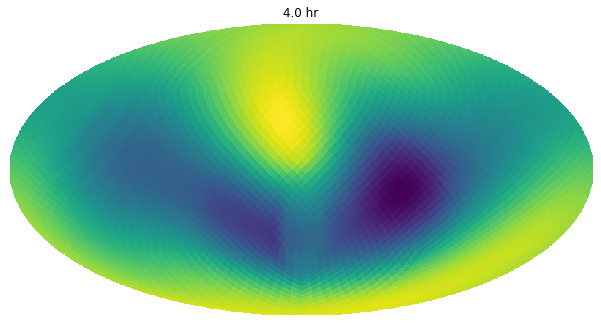

(3072, 3072)


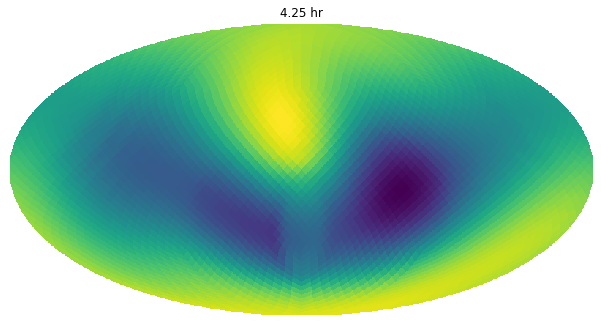

(3072, 3072)


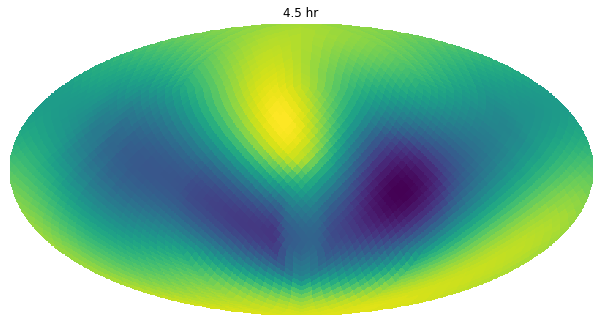

(3072, 3072)


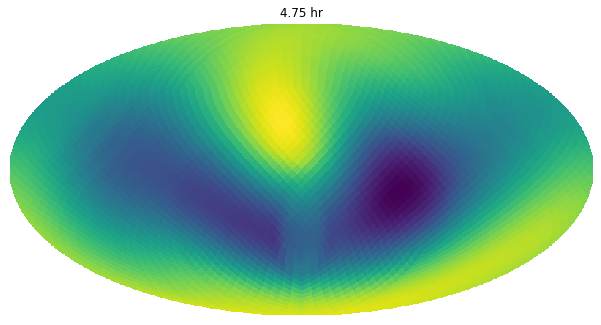

(3072, 3072)


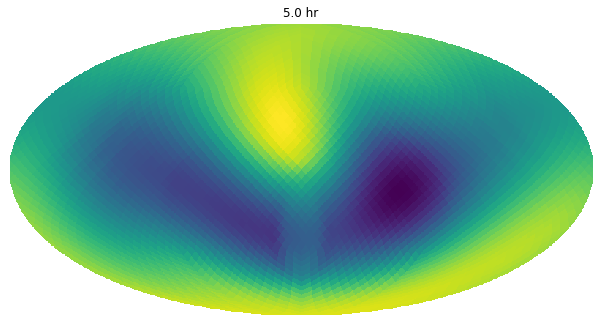

(3072, 3072)


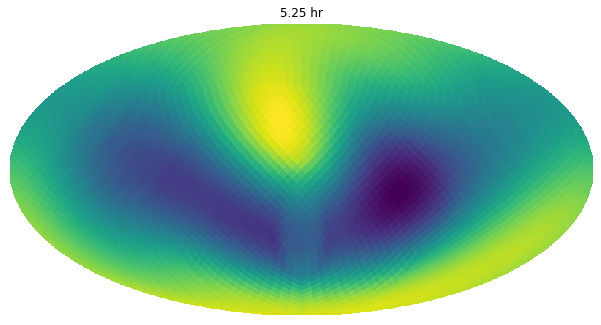

(3072, 3072)


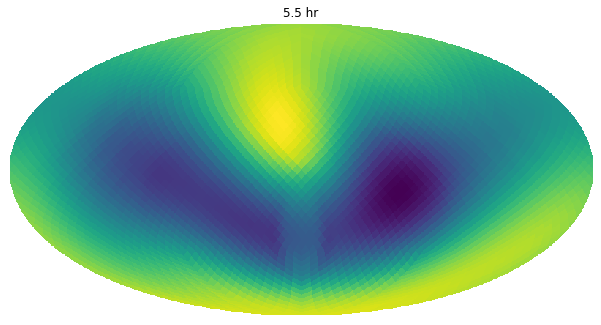

(3072, 3072)


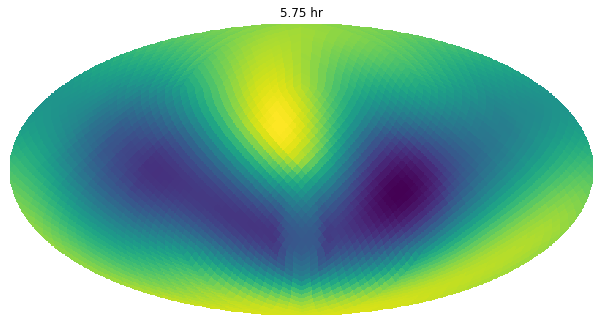

(3072, 3072)


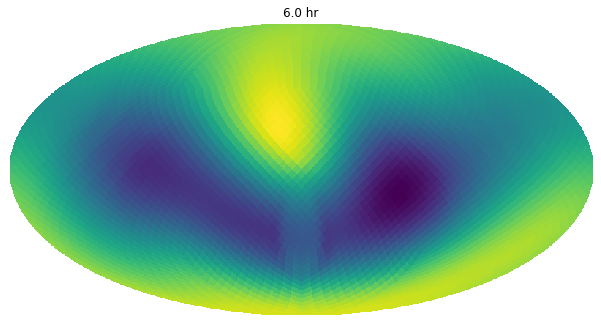

(3072, 3072)


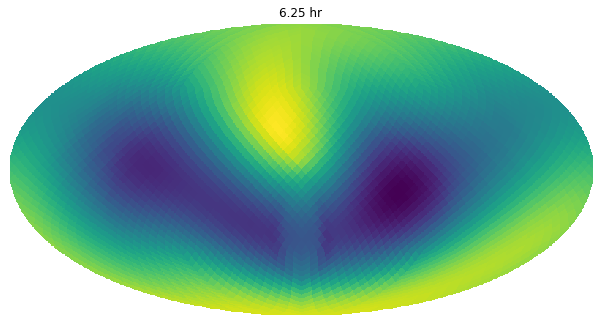

(3072, 3072)


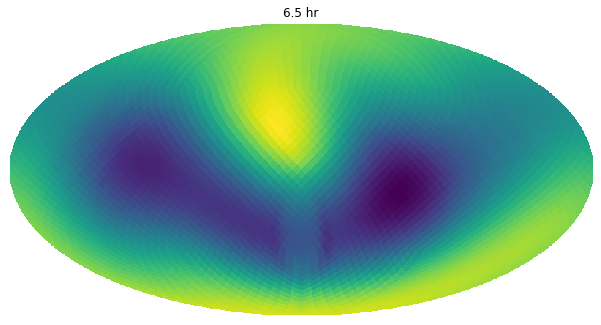

(3072, 3072)


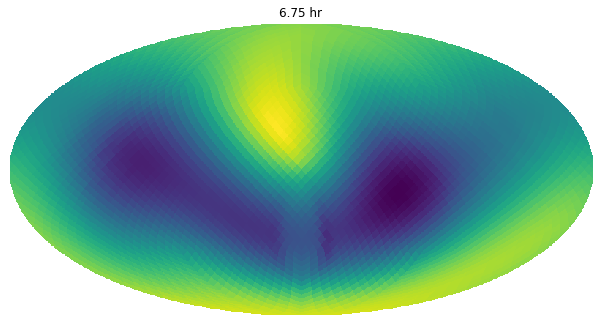

(3072, 3072)


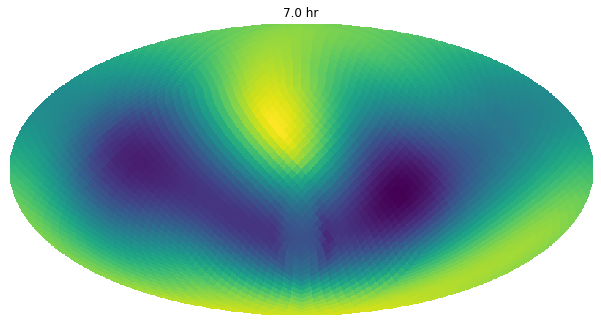

(3072, 3072)


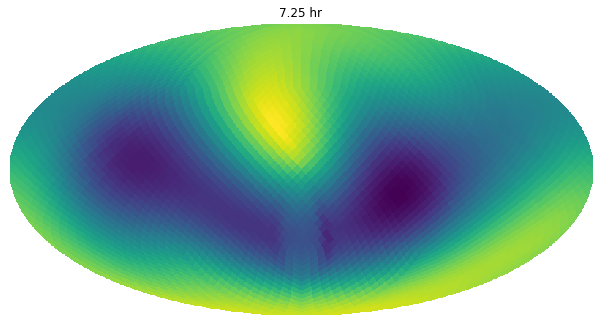

(3072, 3072)


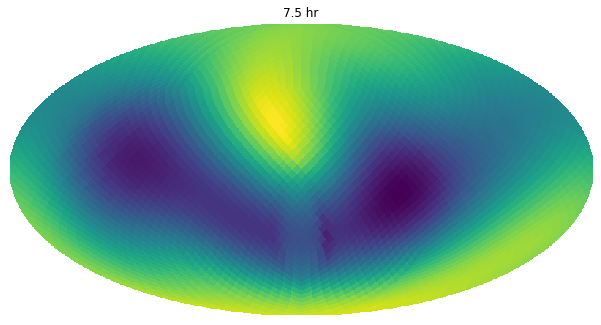

(3072, 3072)


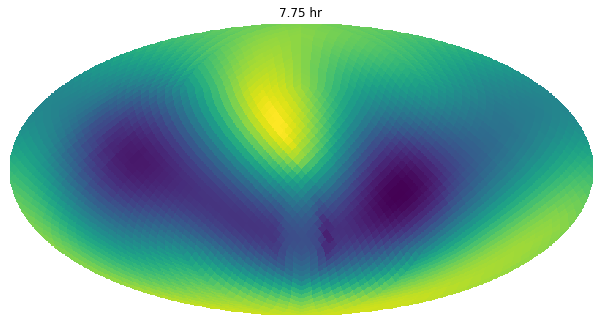

(3072, 3072)


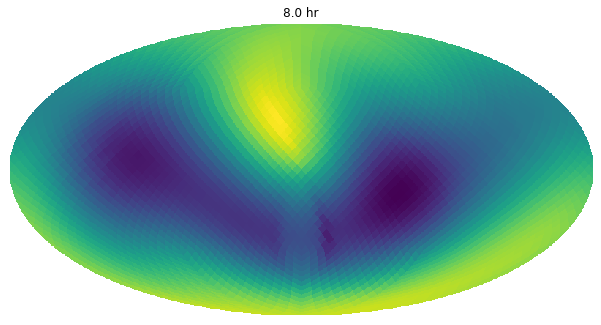

(3072, 3072)


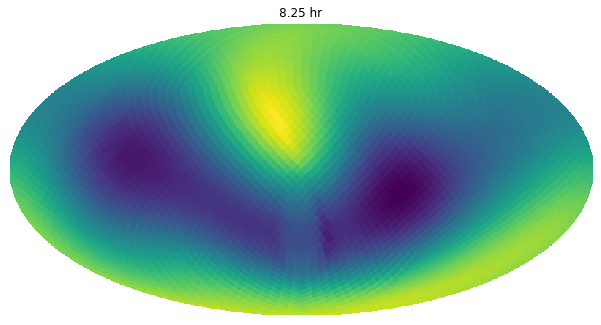

(3072, 3072)


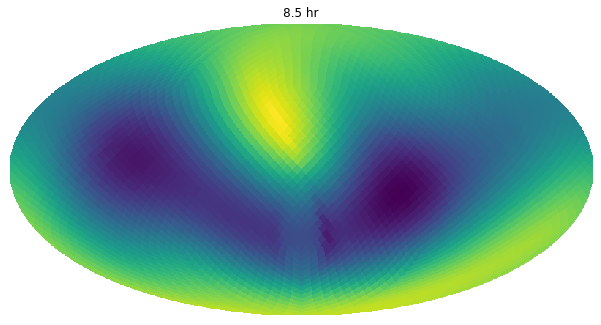

(3072, 3072)


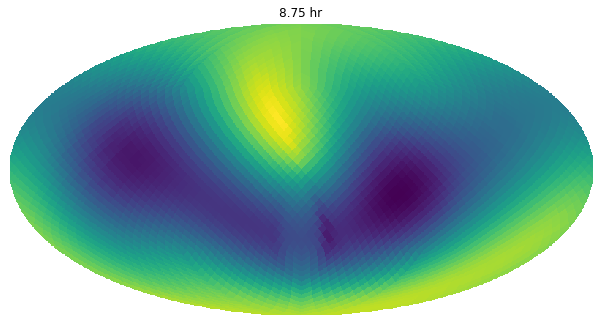

(3072, 3072)


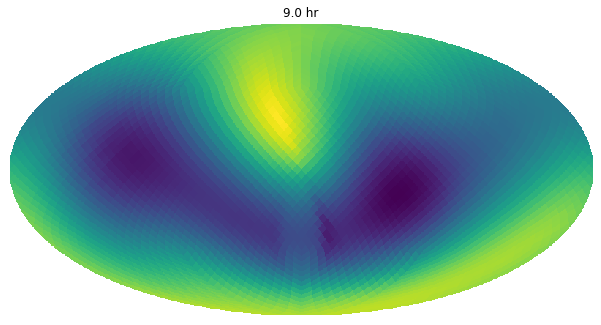

(3072, 3072)


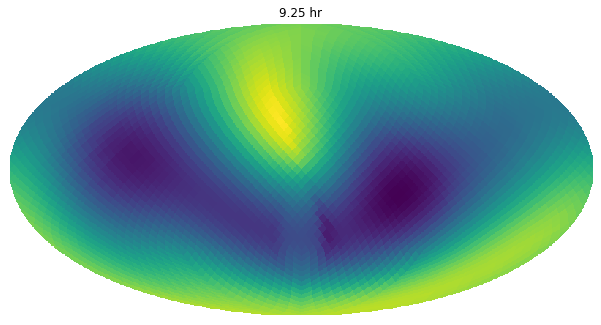

(3072, 3072)


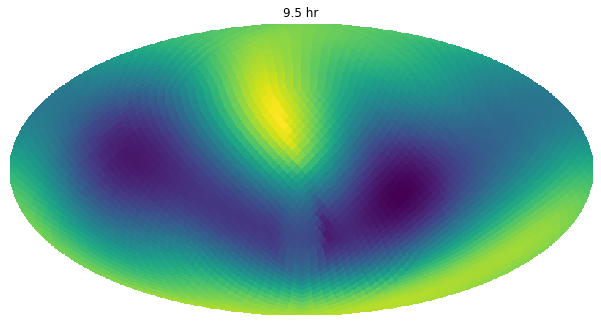

(3072, 3072)


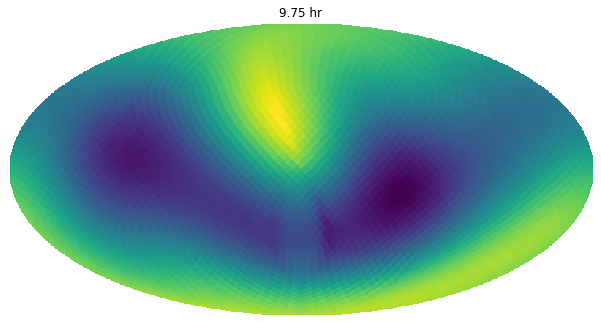

(3072, 3072)


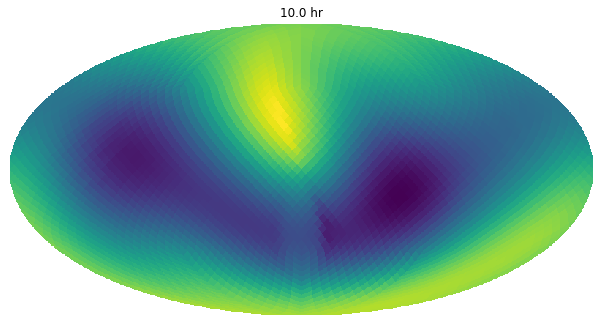

(3072, 3072)


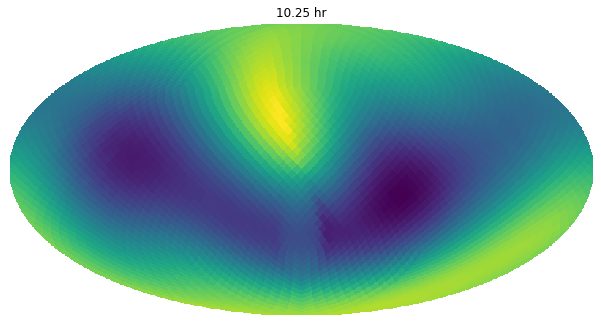

(3072, 3072)


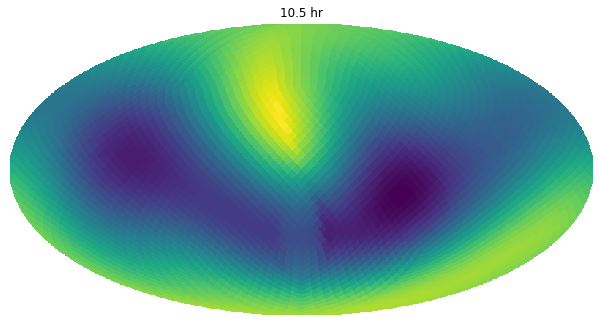

(3072, 3072)


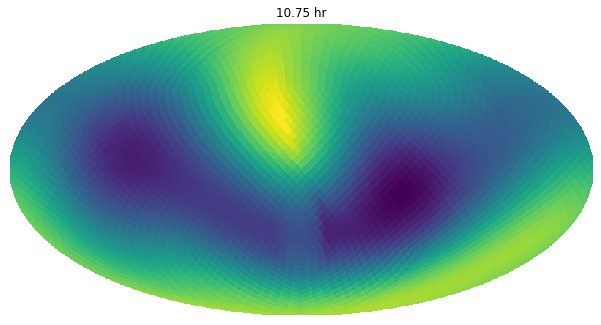

(3072, 3072)


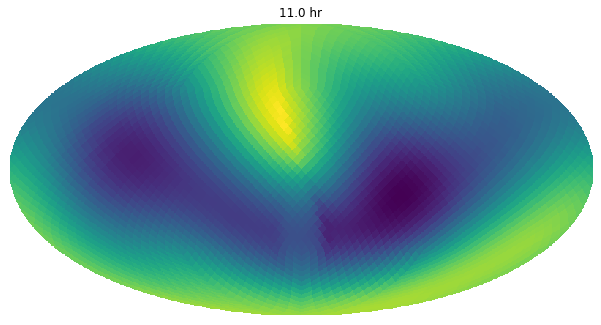

(3072, 3072)


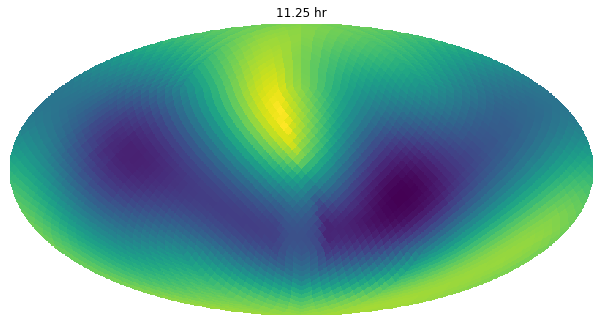

(3072, 3072)


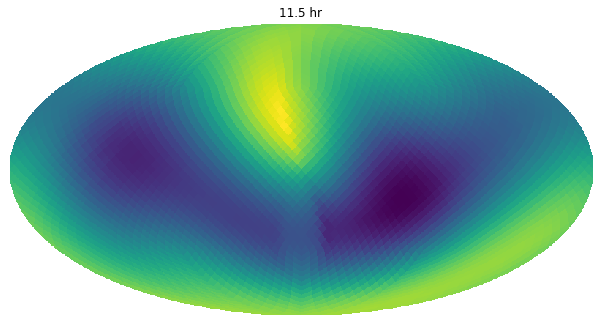

(3072, 3072)


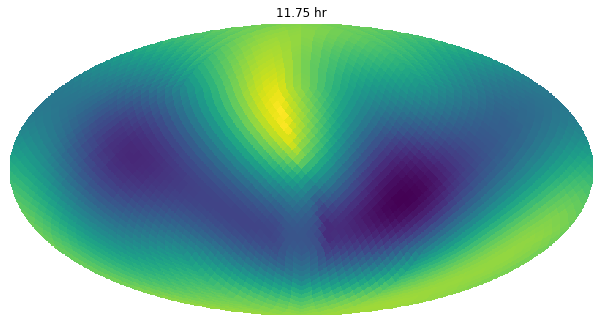

(3072, 3072)


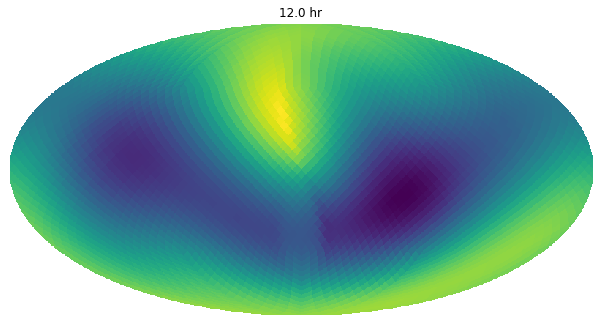

(3072, 3072)


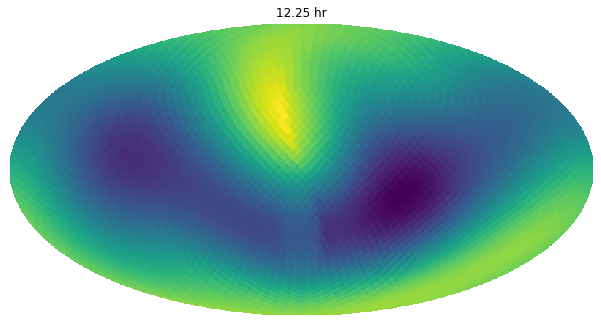

(3072, 3072)


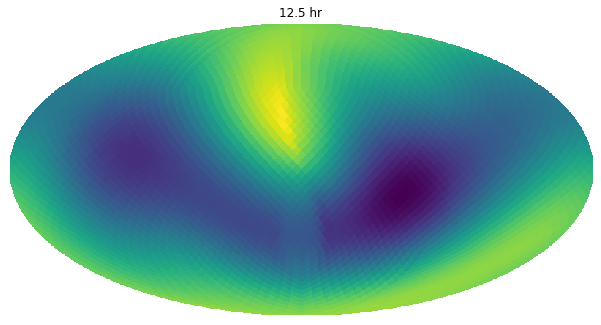

(3072, 3072)


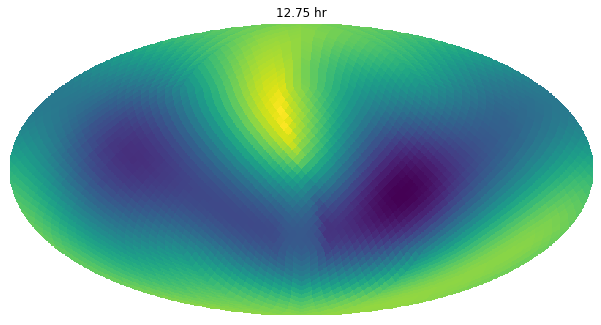

(3072, 3072)


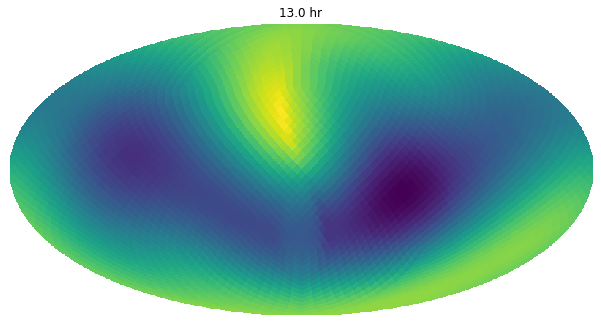

(3072, 3072)


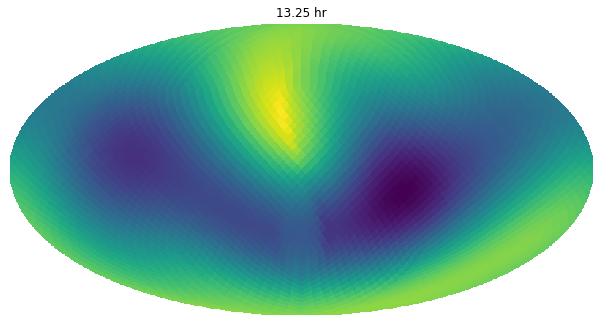

(3072, 3072)


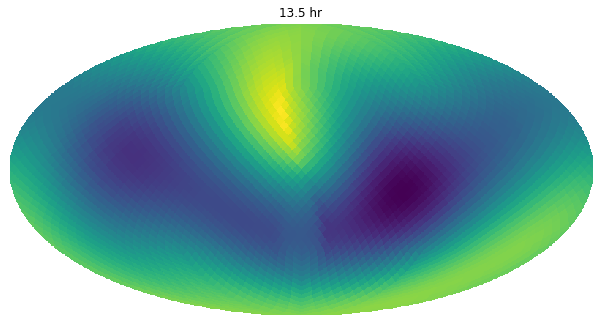

(3072, 3072)


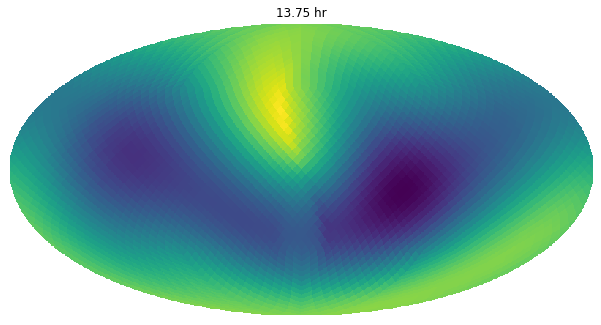

(3072, 3072)


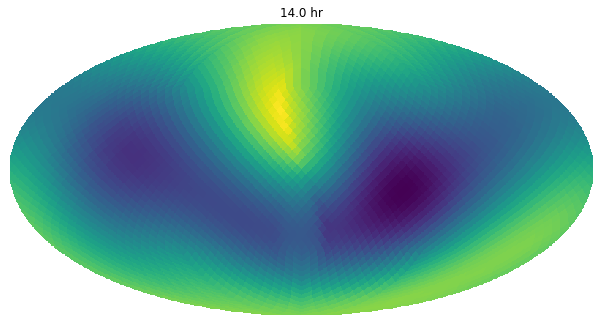

(3072, 3072)


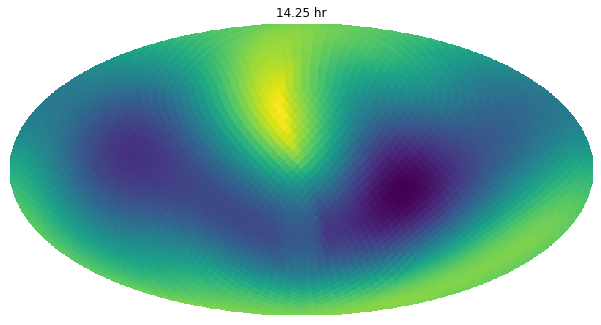

(3072, 3072)


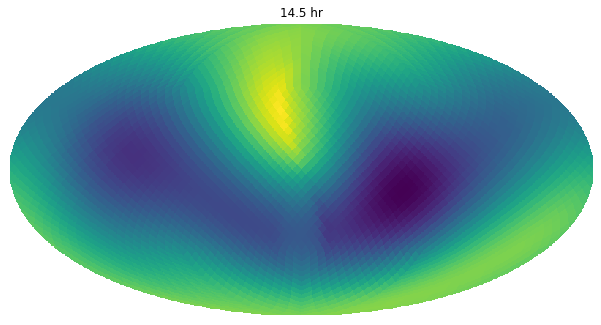

(3072, 3072)


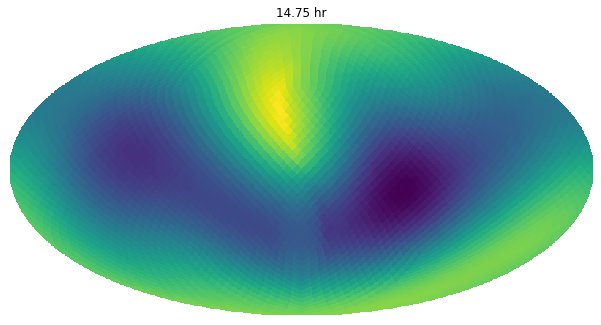

(3072, 3072)


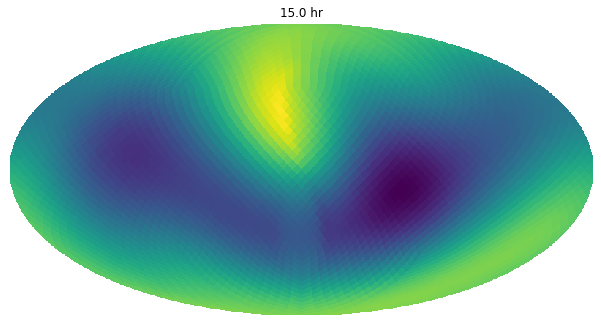

(3072, 3072)


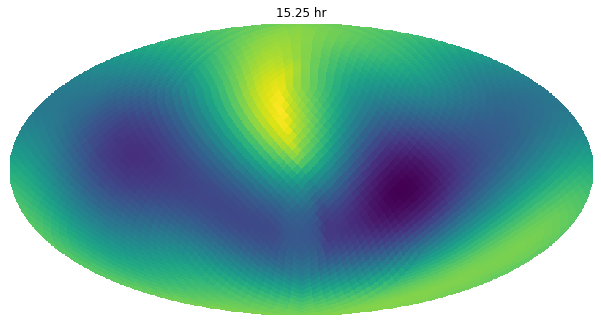

(3072, 3072)


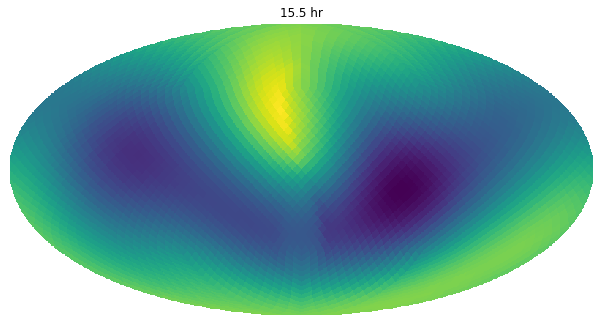

(3072, 3072)


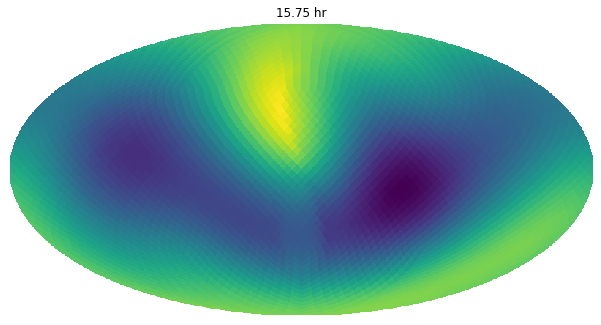

(3072, 3072)


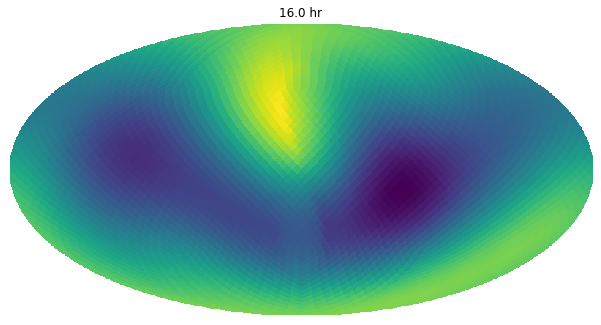

(3072, 3072)


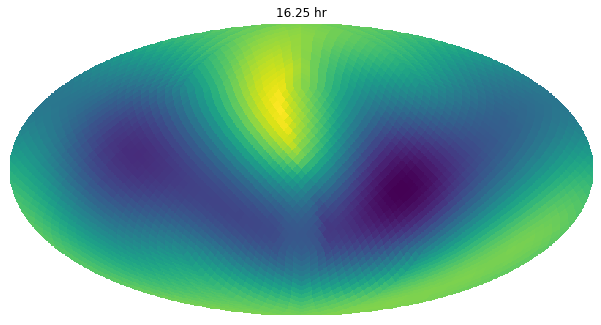

(3072, 3072)


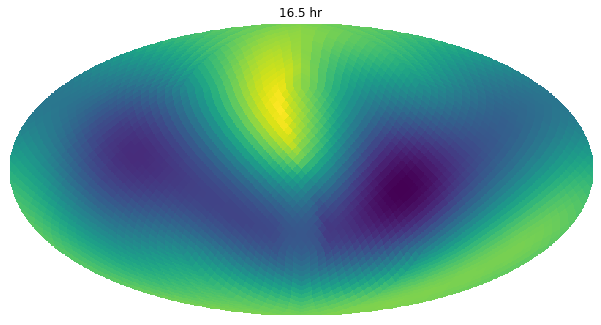

(3072, 3072)


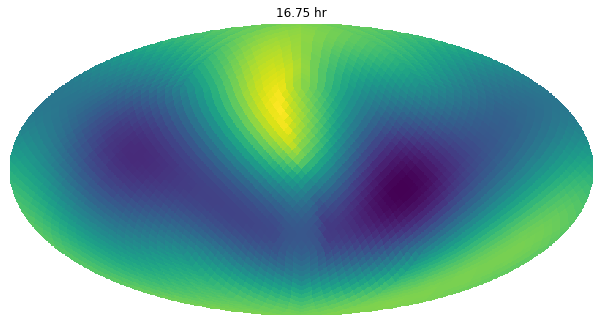

(3072, 3072)


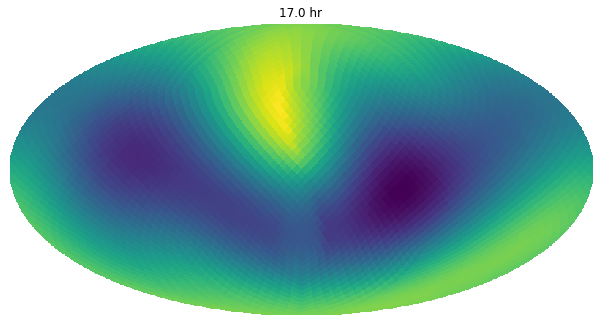

(3072, 3072)


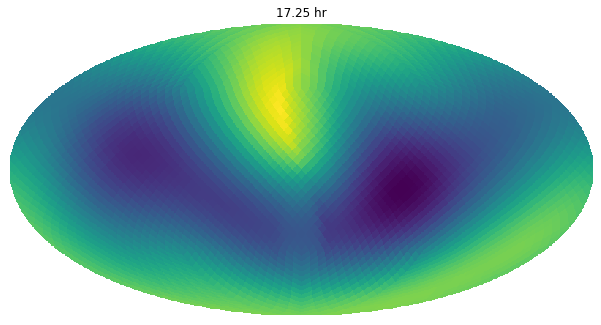

(3072, 3072)


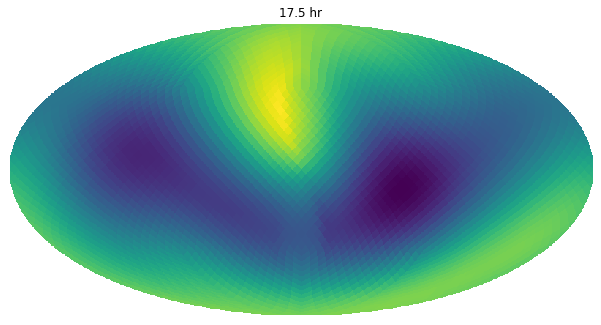

(3072, 3072)


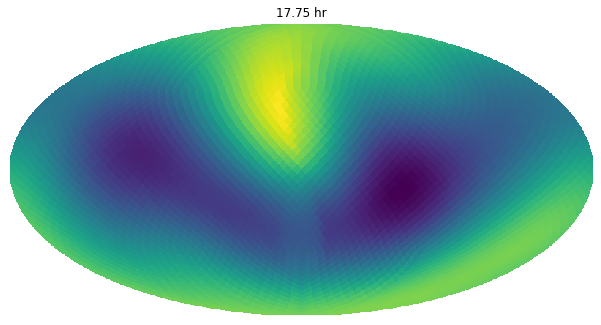

(3072, 3072)


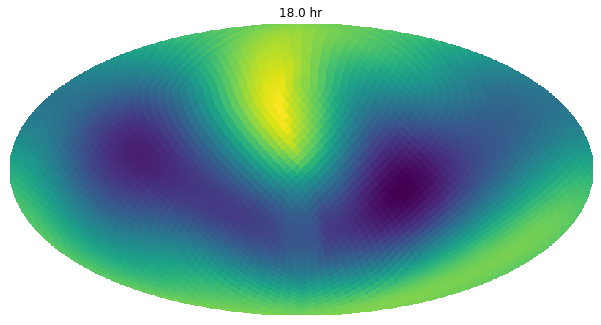

(3072, 3072)


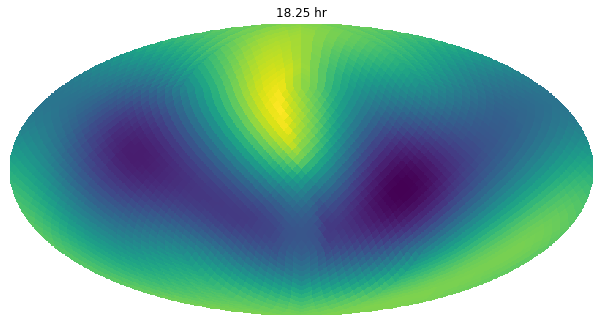

(3072, 3072)


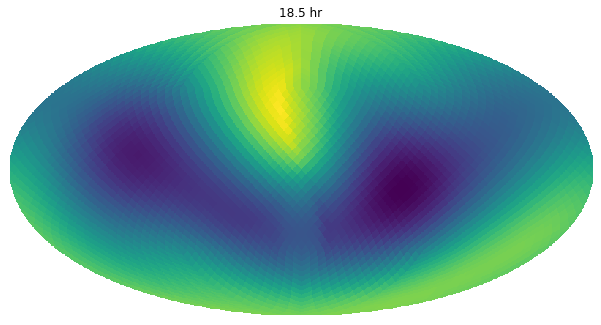

(3072, 3072)


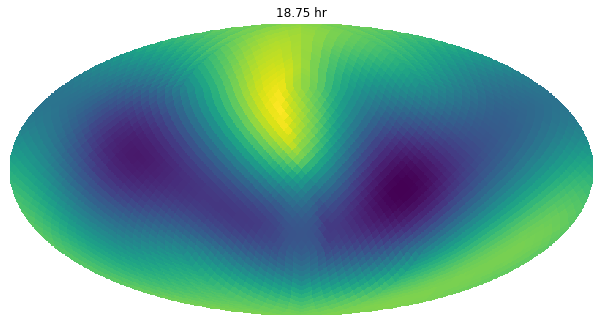

(3072, 3072)


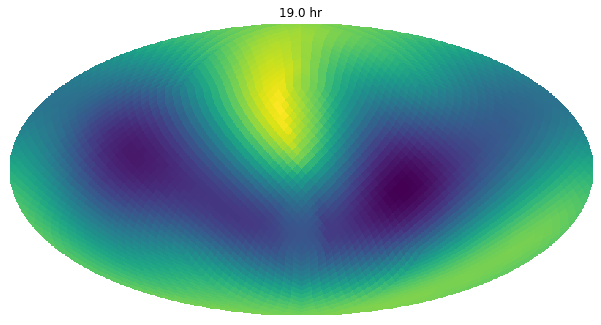

(3072, 3072)


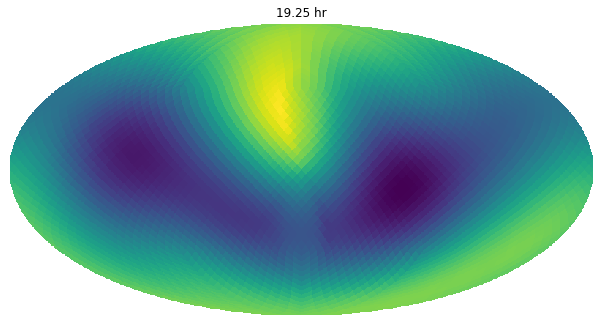

(3072, 3072)


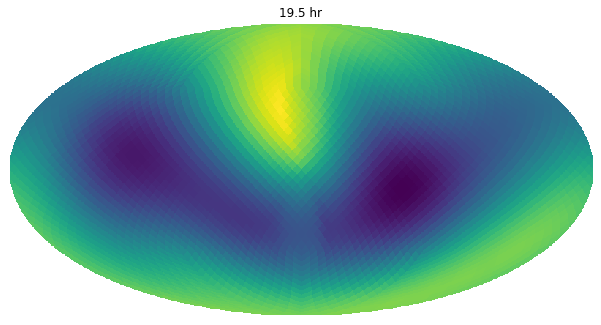

(3072, 3072)


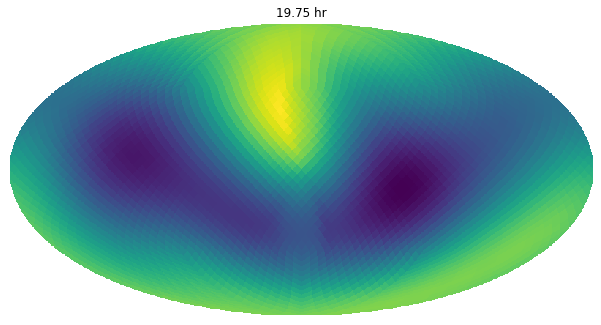

(3072, 3072)


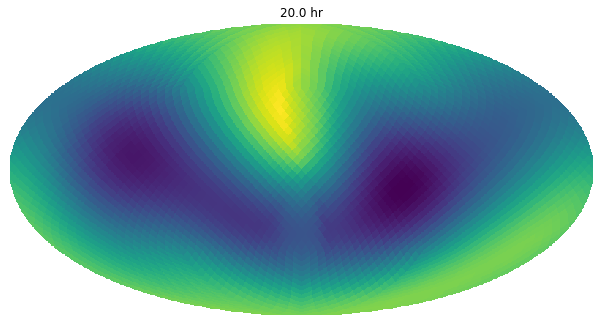

(3072, 3072)


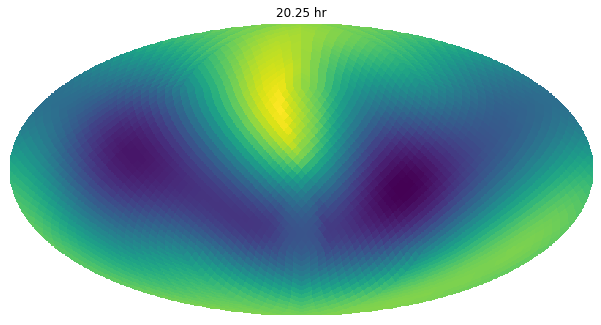

(3072, 3072)


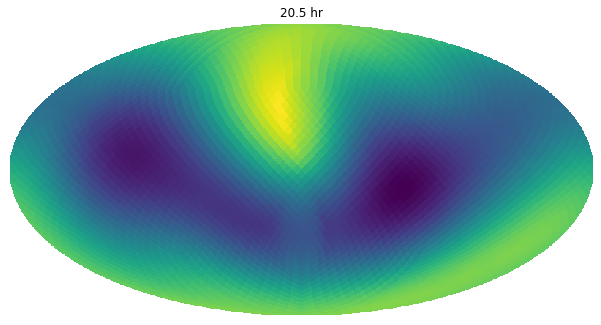

(3072, 3072)


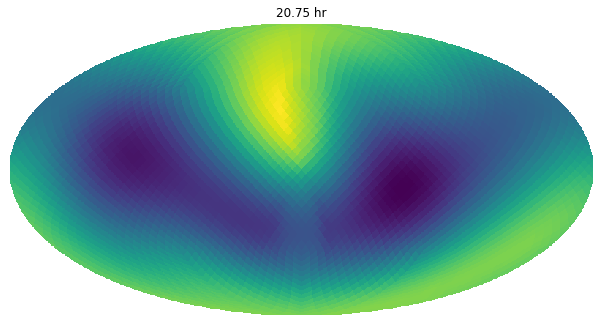

(3072, 3072)


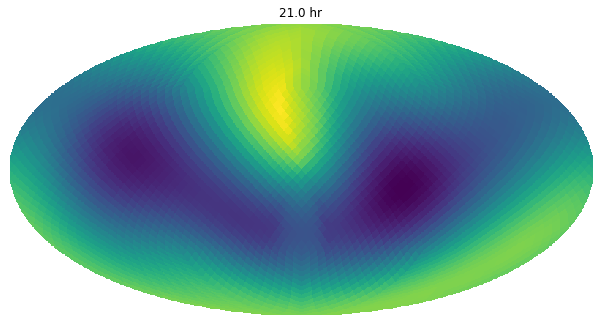

(3072, 3072)


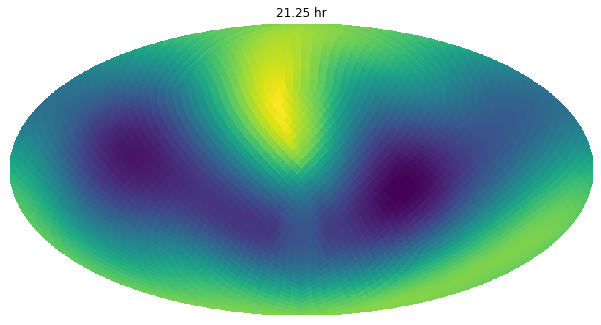

(3072, 3072)


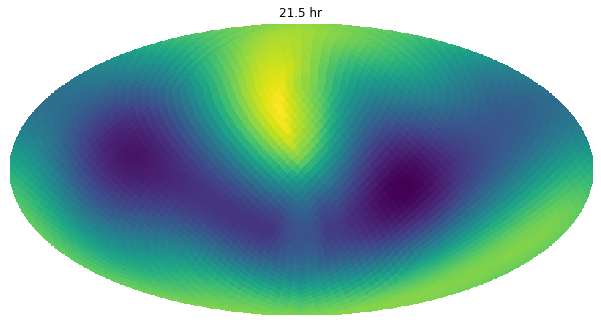

(3072, 3072)


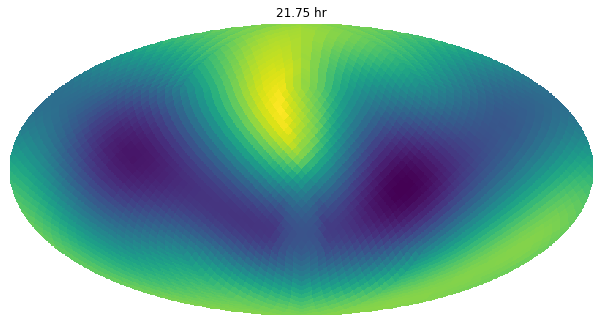

(3072, 3072)


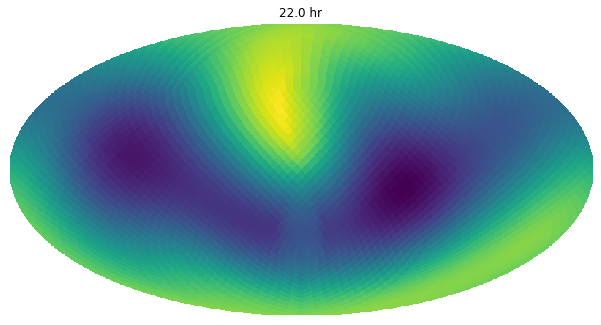

(3072, 3072)


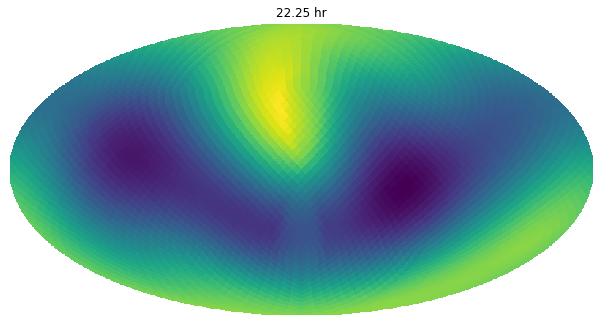

(3072, 3072)


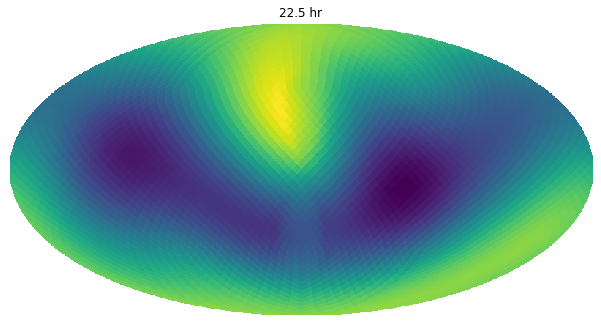

(3072, 3072)


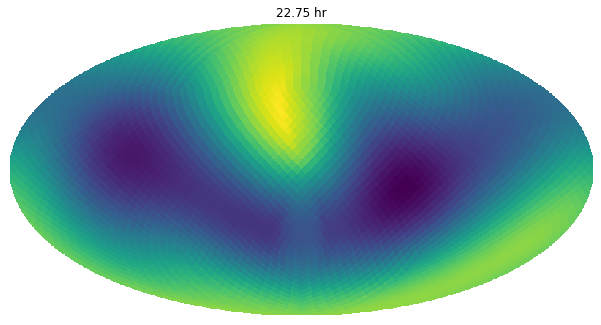

(3072, 3072)


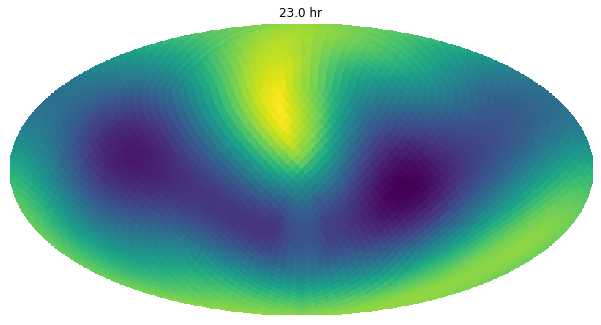

(3072, 3072)


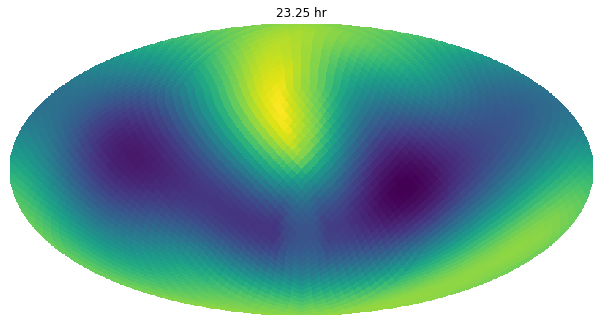

(3072, 3072)


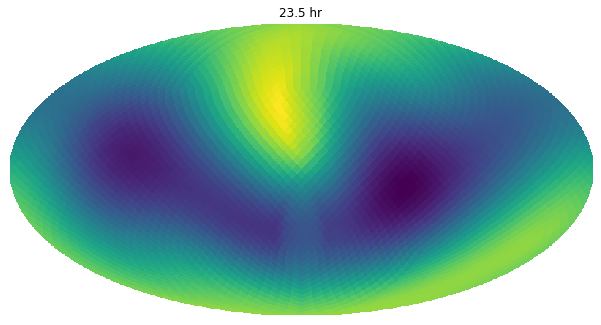

(3072, 3072)


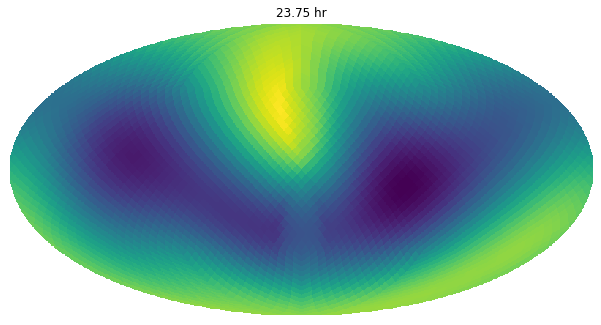

In [108]:
#cumulative_dirty = np.zeros(hp.nside2npix(nside), dtype="complex128")
cumulative_fisher = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
for i, t in enumerate(np.arange(0, 86400, 900)):
    
    orf = 0.5*geom_fact*np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=t, t0=0), n_hat(theta, phi))/c)\
           for f in freqs])
    orf_star = np.conjugate(orf)
    cumulative_fisher += simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    cumulative_dirty = np.einsum("ij,j", cumulative_fisher, source)
    hp.mollview(cumulative_dirty, title = f"{t/3600} hr", cbar = False)
    
    #if i<100 and i>10:
    #    num = f"0{i}"
    #elif i<10:
    #    num = f"00{i}"
    #else:
    num = f"{i}"
    
    #plt.savefig(f"./Animation/Broadband_real_ORF/{num}.svg", bbox_inches='tight')
    plt.savefig(f"./Animation/Broadband_real_ORF/{num}.png", dpi = 300, bbox_inches='tight')
    plt.show()
    plt.close()

(3072, 3072)
(3072, 3072)
(3072, 3072)


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


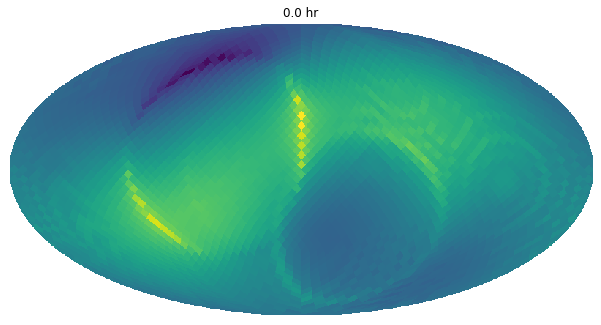

(3072, 3072)
(3072, 3072)
(3072, 3072)


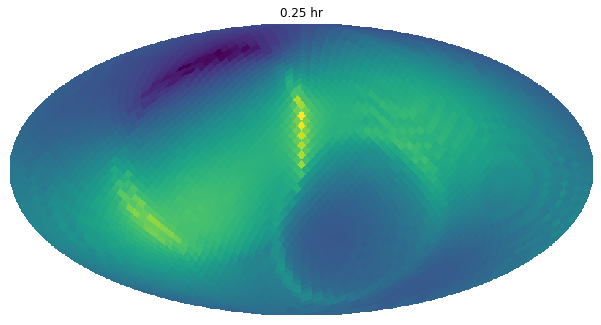

(3072, 3072)
(3072, 3072)
(3072, 3072)


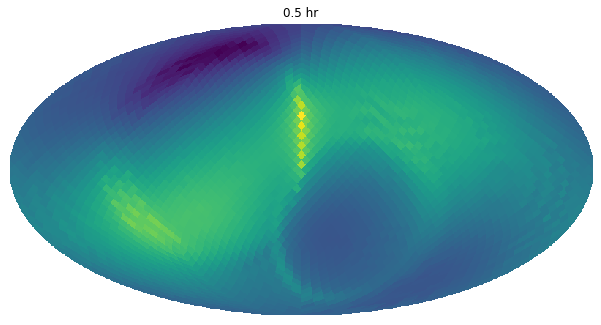

(3072, 3072)
(3072, 3072)
(3072, 3072)


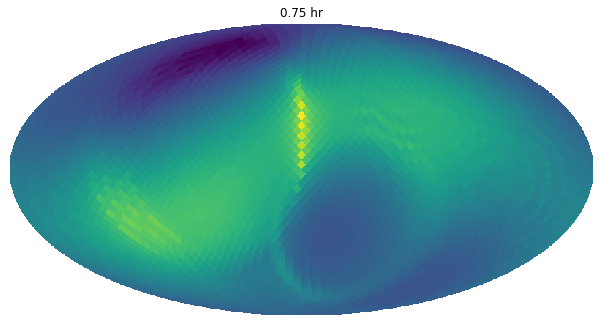

(3072, 3072)
(3072, 3072)
(3072, 3072)


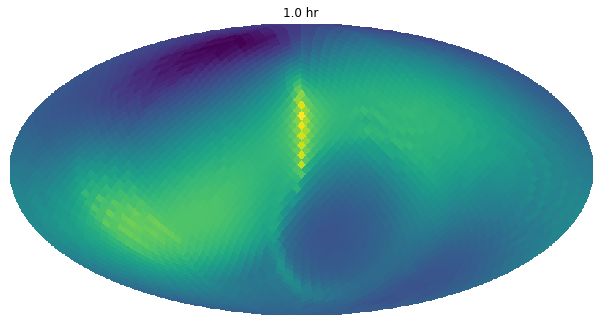

(3072, 3072)
(3072, 3072)
(3072, 3072)


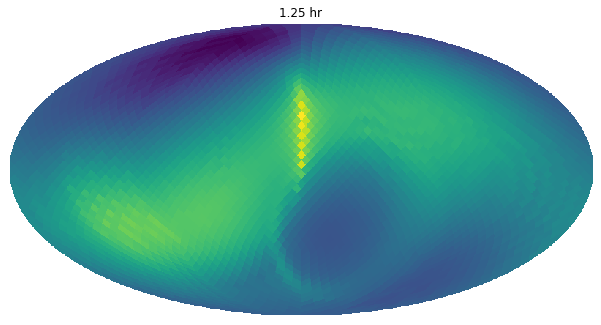

(3072, 3072)
(3072, 3072)
(3072, 3072)


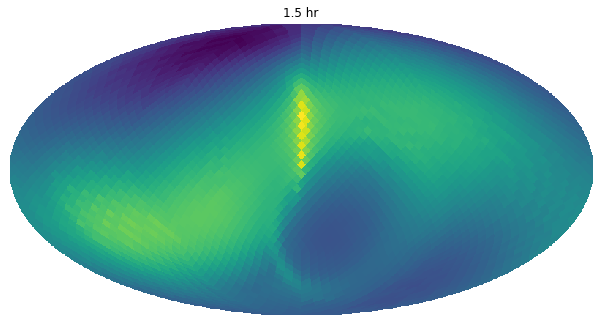

(3072, 3072)
(3072, 3072)
(3072, 3072)


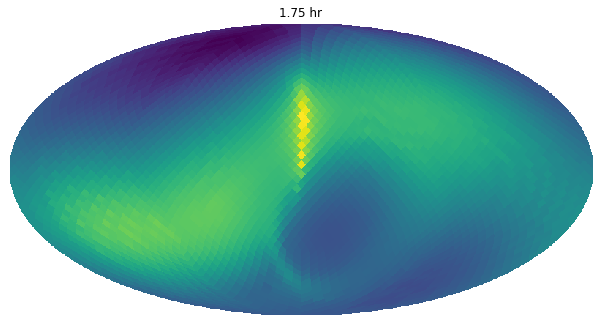

(3072, 3072)
(3072, 3072)
(3072, 3072)


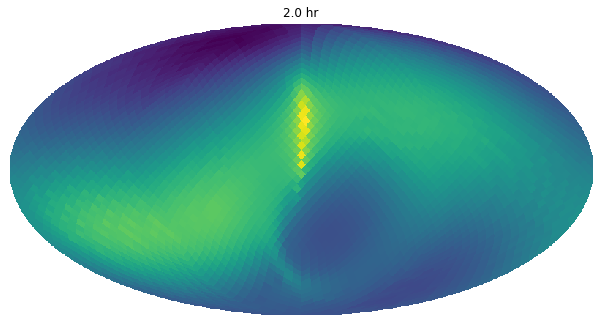

(3072, 3072)
(3072, 3072)
(3072, 3072)


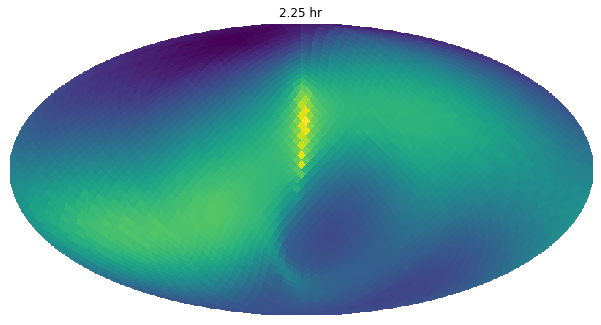

(3072, 3072)
(3072, 3072)
(3072, 3072)


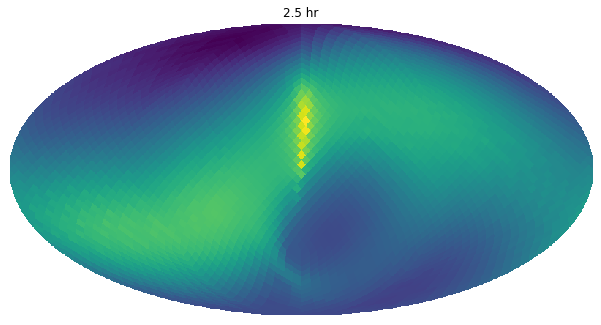

(3072, 3072)
(3072, 3072)
(3072, 3072)


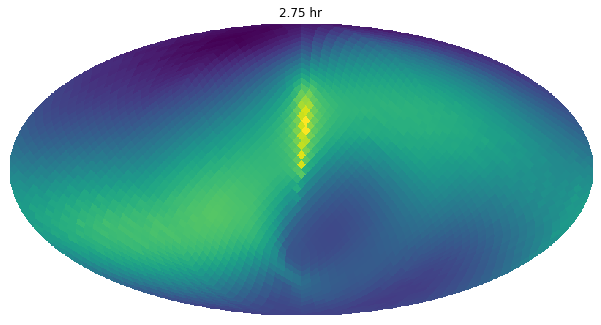

(3072, 3072)
(3072, 3072)
(3072, 3072)


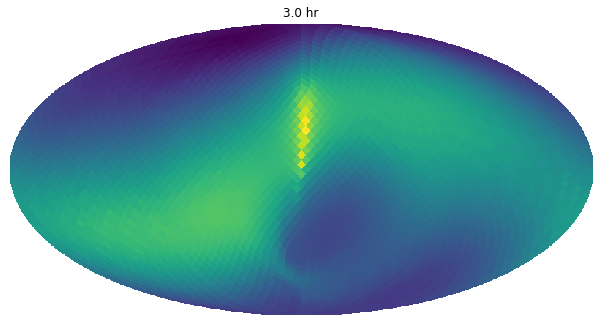

(3072, 3072)
(3072, 3072)
(3072, 3072)


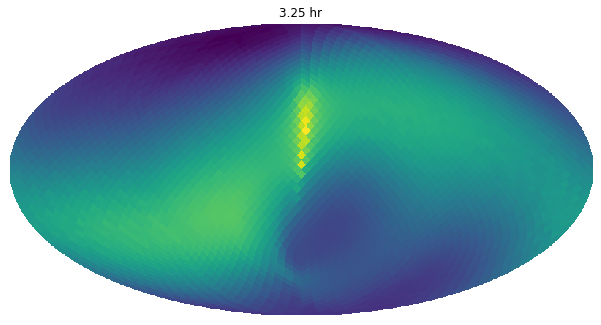

(3072, 3072)
(3072, 3072)
(3072, 3072)


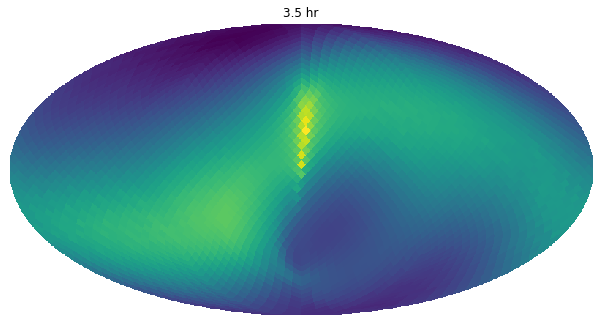

(3072, 3072)
(3072, 3072)
(3072, 3072)


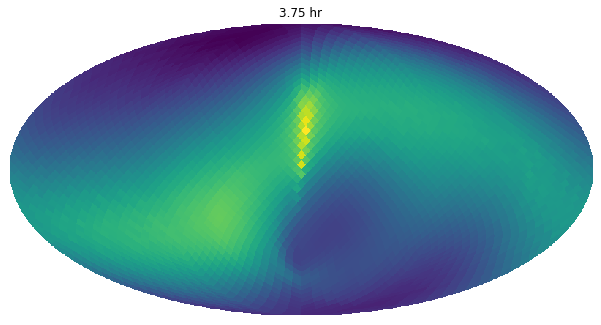

(3072, 3072)
(3072, 3072)
(3072, 3072)


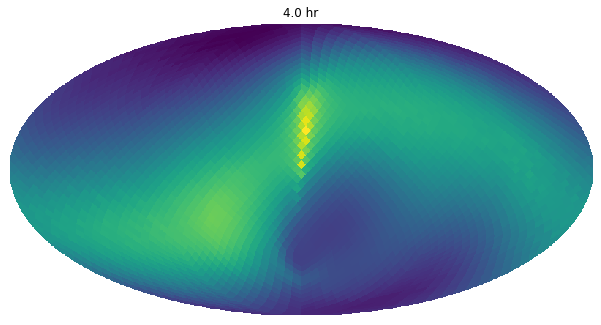

(3072, 3072)
(3072, 3072)
(3072, 3072)


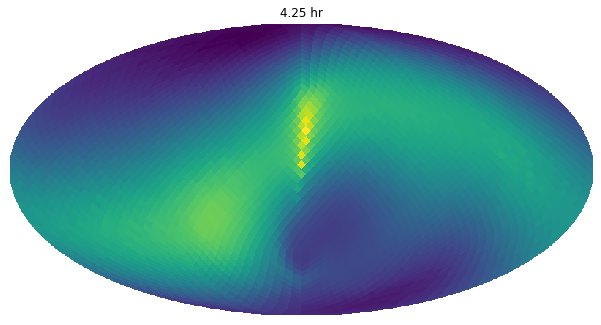

(3072, 3072)
(3072, 3072)
(3072, 3072)


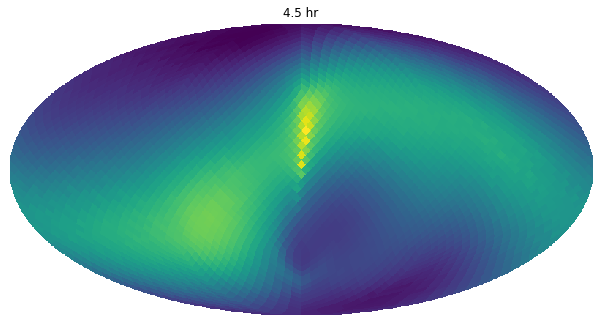

(3072, 3072)
(3072, 3072)
(3072, 3072)


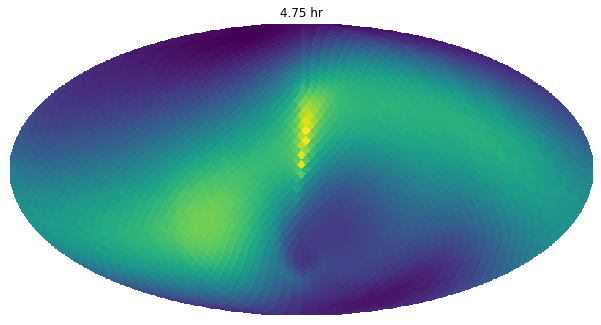

(3072, 3072)
(3072, 3072)
(3072, 3072)


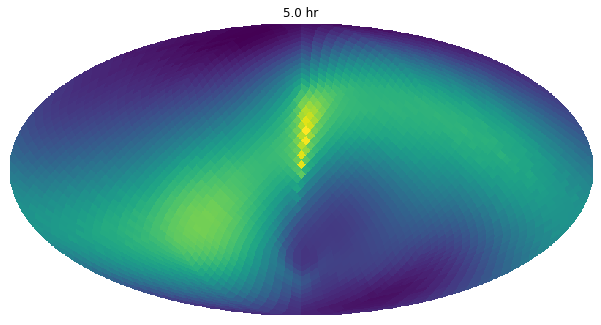

(3072, 3072)
(3072, 3072)
(3072, 3072)


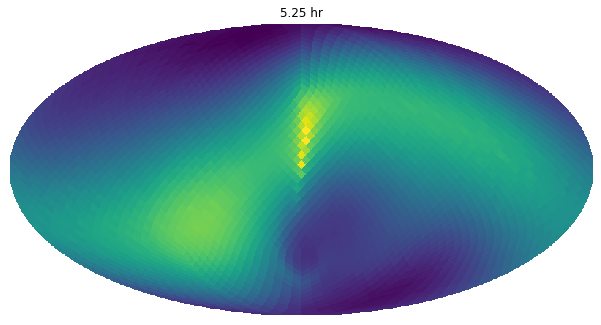

(3072, 3072)
(3072, 3072)
(3072, 3072)


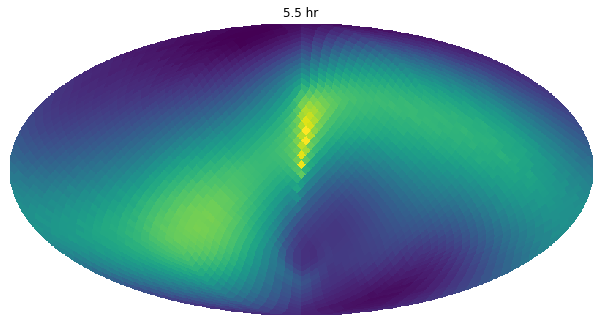

(3072, 3072)
(3072, 3072)
(3072, 3072)


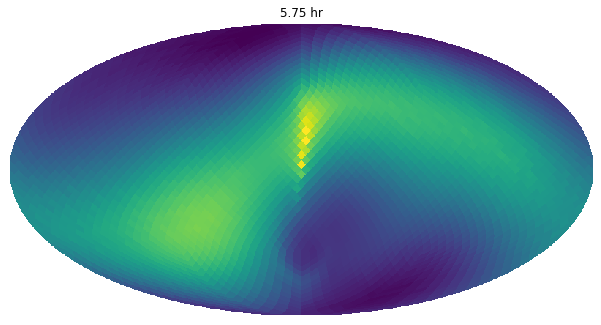

(3072, 3072)
(3072, 3072)
(3072, 3072)


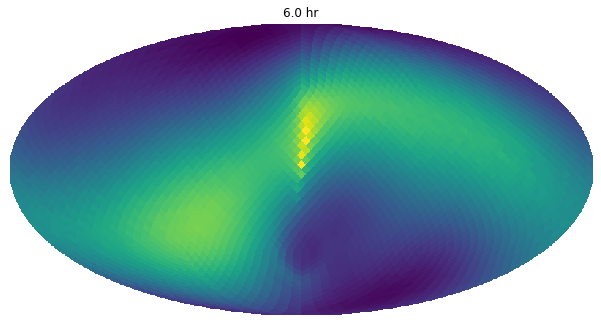

(3072, 3072)
(3072, 3072)
(3072, 3072)


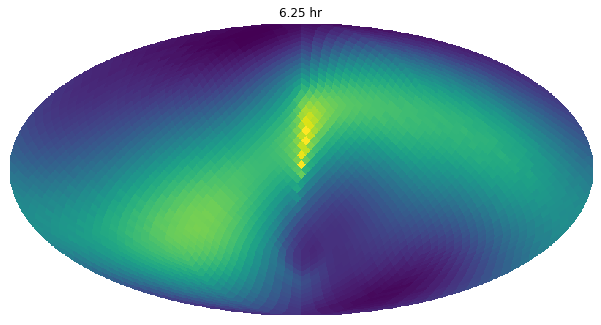

(3072, 3072)
(3072, 3072)
(3072, 3072)


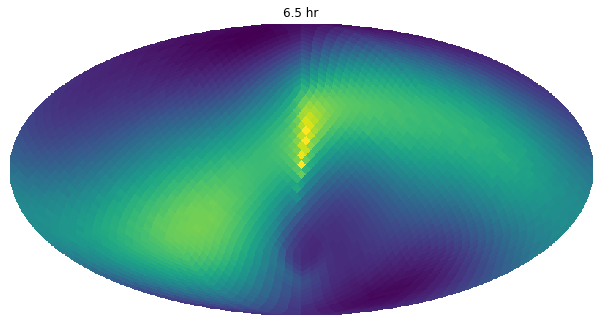

(3072, 3072)
(3072, 3072)
(3072, 3072)


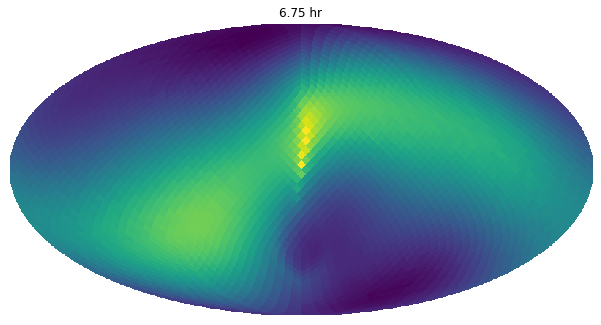

(3072, 3072)
(3072, 3072)
(3072, 3072)


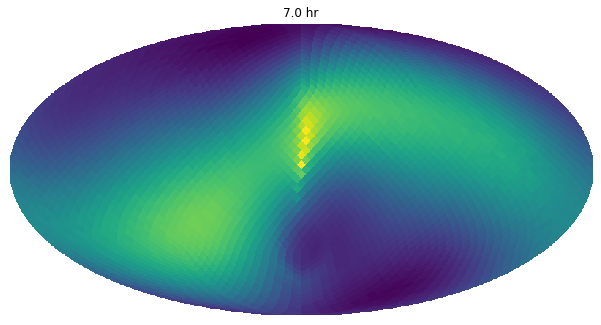

(3072, 3072)
(3072, 3072)
(3072, 3072)


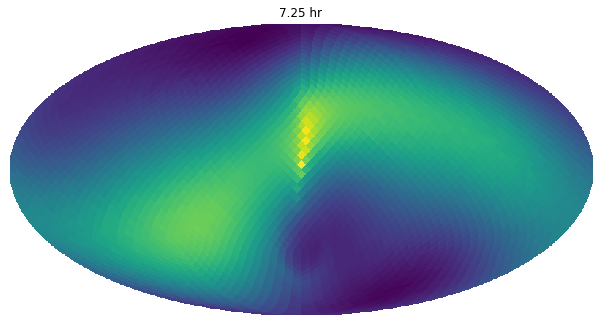

(3072, 3072)
(3072, 3072)
(3072, 3072)


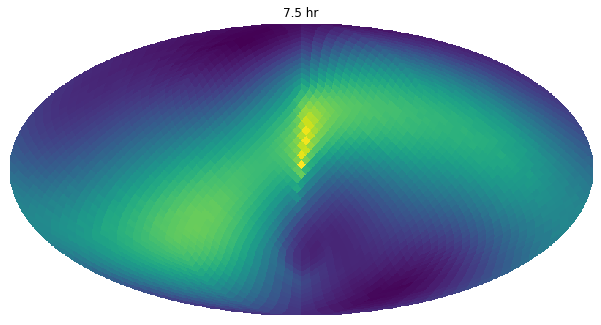

(3072, 3072)
(3072, 3072)
(3072, 3072)


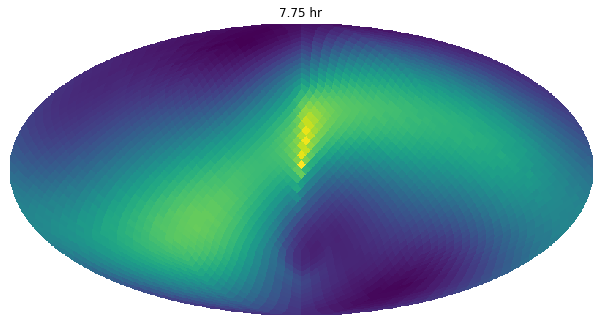

(3072, 3072)
(3072, 3072)
(3072, 3072)


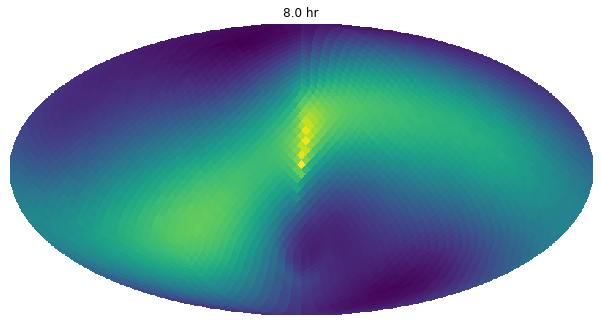

(3072, 3072)
(3072, 3072)
(3072, 3072)


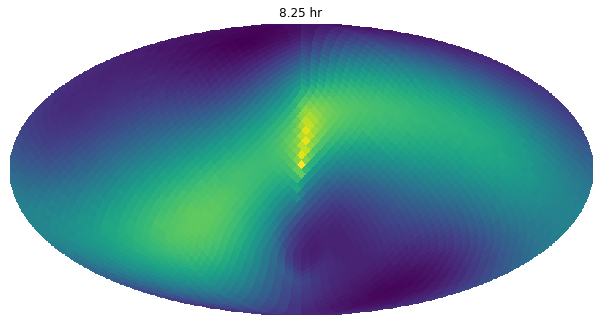

(3072, 3072)
(3072, 3072)
(3072, 3072)


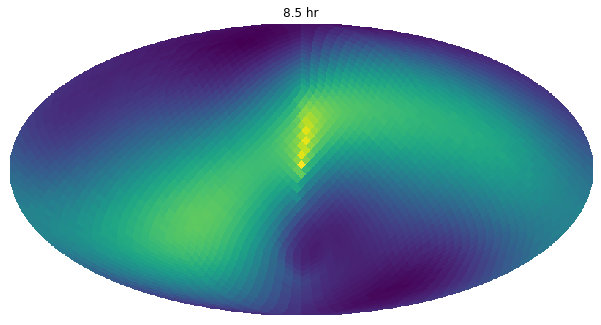

(3072, 3072)
(3072, 3072)
(3072, 3072)


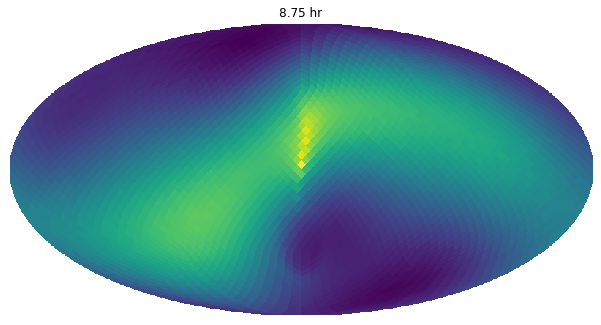

(3072, 3072)
(3072, 3072)
(3072, 3072)


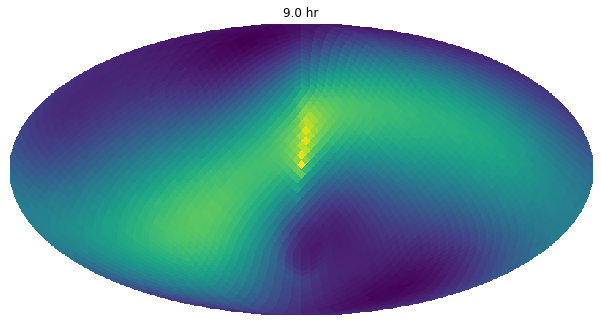

(3072, 3072)
(3072, 3072)
(3072, 3072)


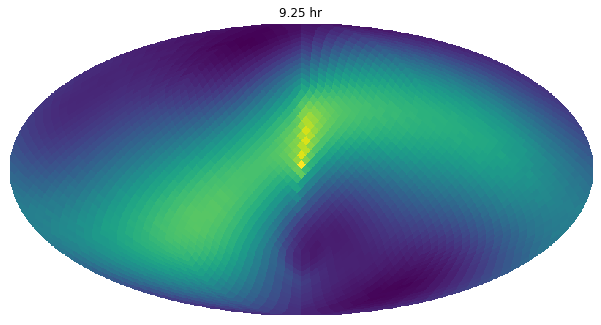

(3072, 3072)
(3072, 3072)
(3072, 3072)


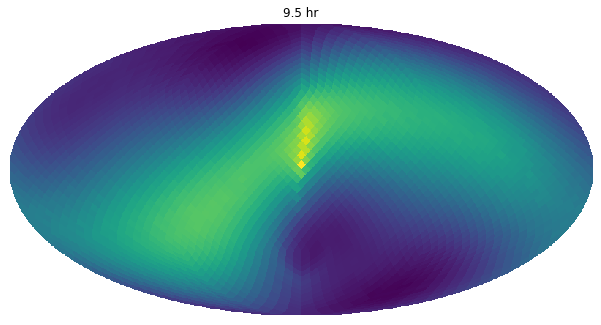

(3072, 3072)
(3072, 3072)
(3072, 3072)


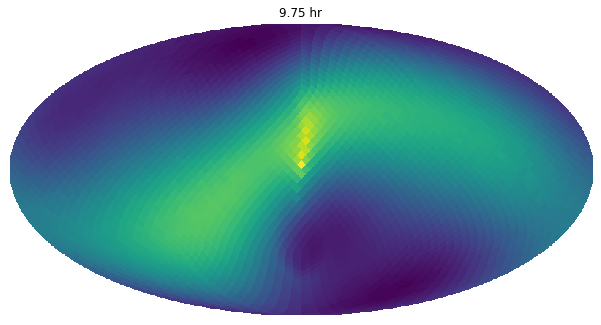

(3072, 3072)
(3072, 3072)
(3072, 3072)


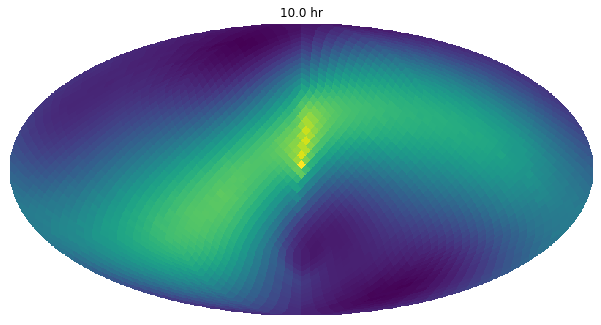

(3072, 3072)
(3072, 3072)
(3072, 3072)


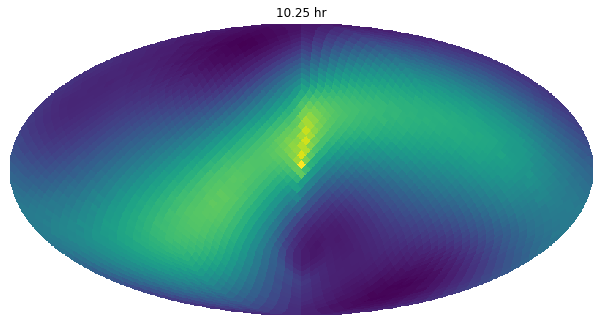

(3072, 3072)
(3072, 3072)
(3072, 3072)


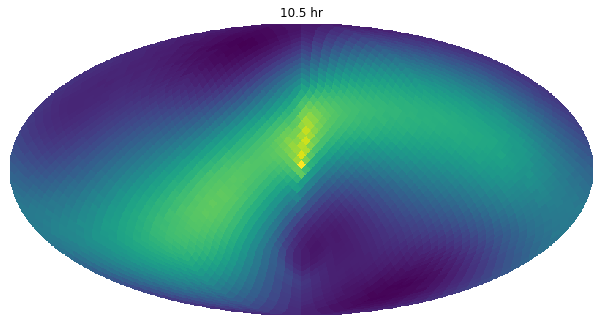

(3072, 3072)
(3072, 3072)
(3072, 3072)


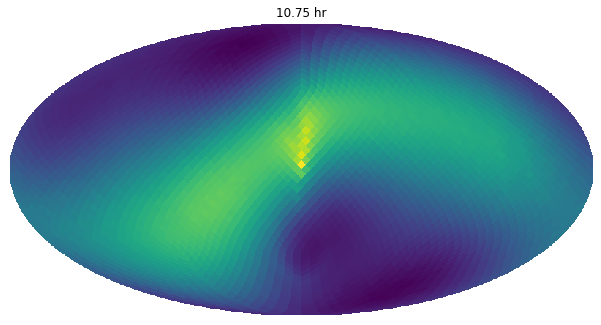

(3072, 3072)
(3072, 3072)
(3072, 3072)


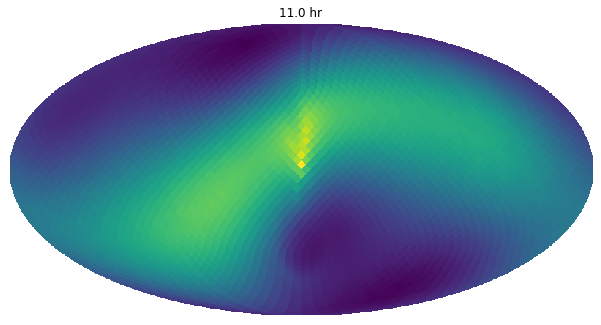

(3072, 3072)
(3072, 3072)
(3072, 3072)


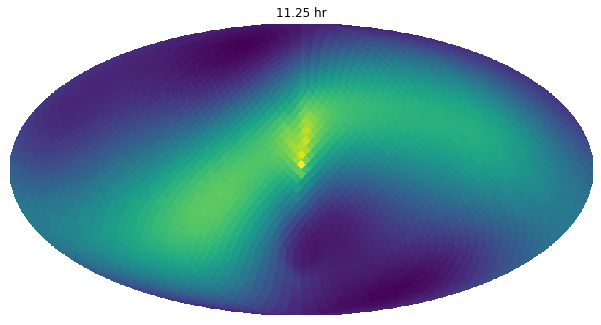

(3072, 3072)
(3072, 3072)
(3072, 3072)


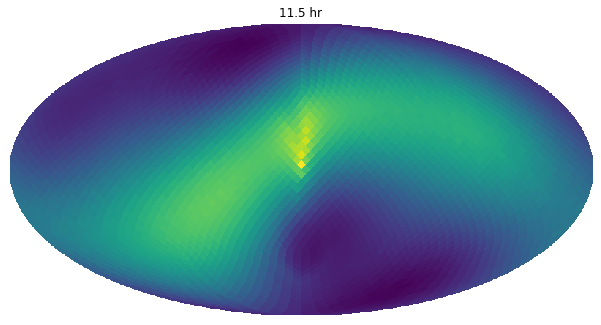

(3072, 3072)
(3072, 3072)
(3072, 3072)


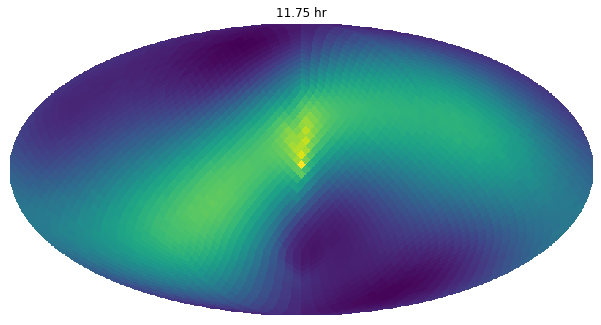

(3072, 3072)
(3072, 3072)
(3072, 3072)


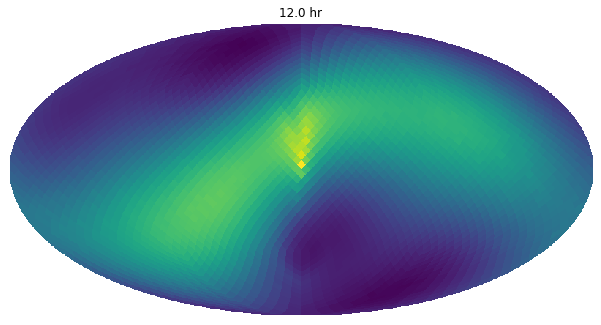

(3072, 3072)
(3072, 3072)
(3072, 3072)


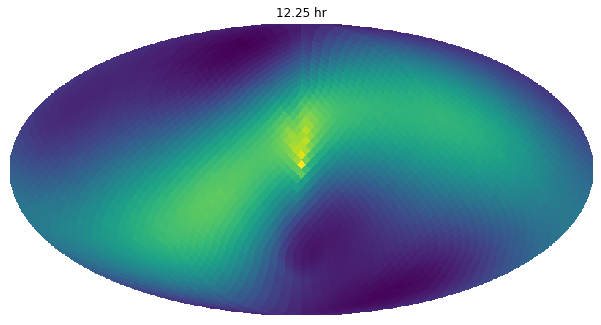

(3072, 3072)
(3072, 3072)
(3072, 3072)


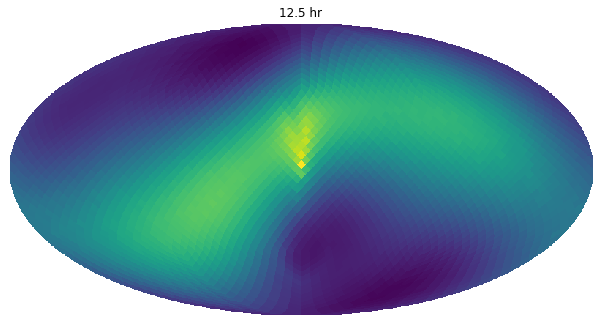

(3072, 3072)
(3072, 3072)
(3072, 3072)


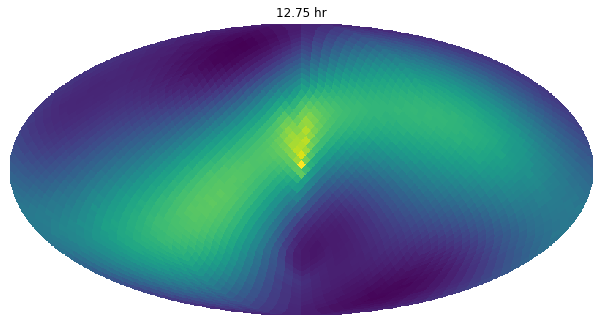

(3072, 3072)
(3072, 3072)
(3072, 3072)


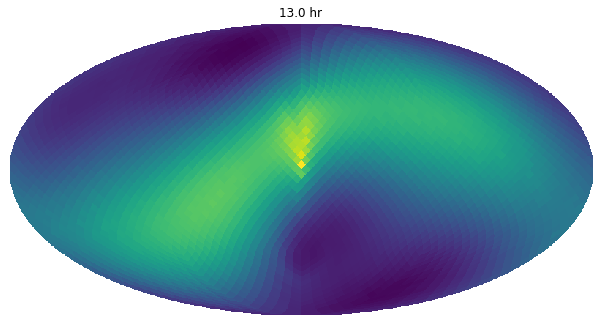

(3072, 3072)
(3072, 3072)
(3072, 3072)


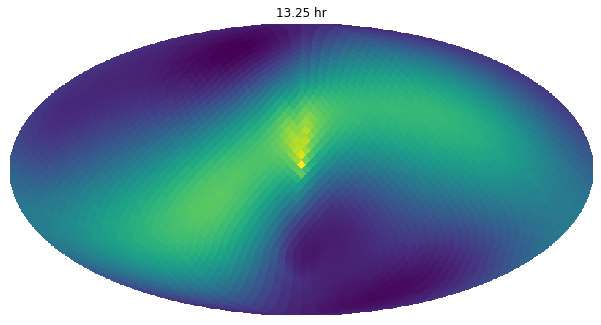

(3072, 3072)
(3072, 3072)
(3072, 3072)


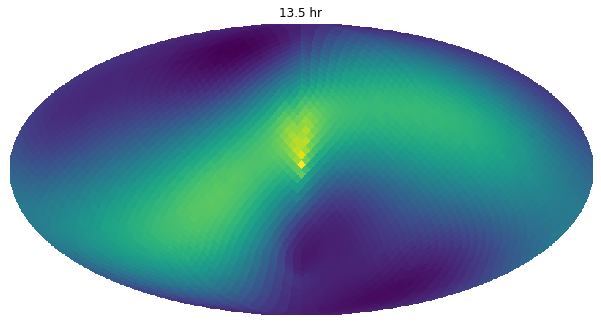

(3072, 3072)
(3072, 3072)
(3072, 3072)


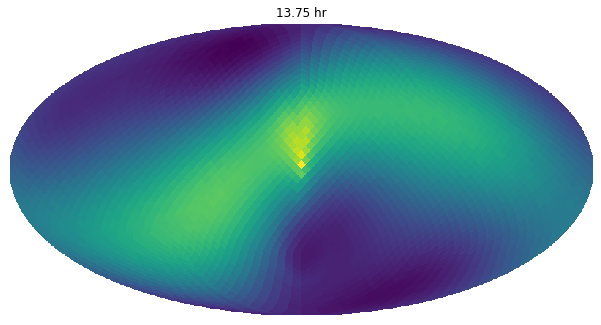

(3072, 3072)
(3072, 3072)
(3072, 3072)


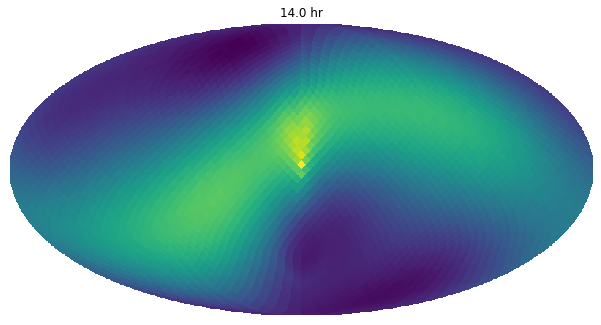

(3072, 3072)
(3072, 3072)
(3072, 3072)


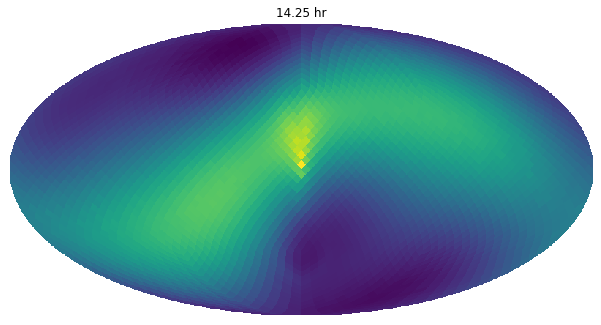

(3072, 3072)
(3072, 3072)
(3072, 3072)


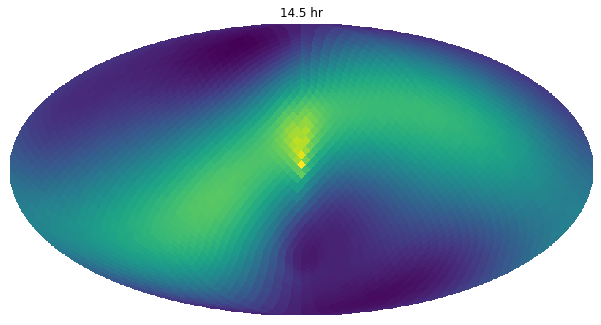

(3072, 3072)
(3072, 3072)
(3072, 3072)


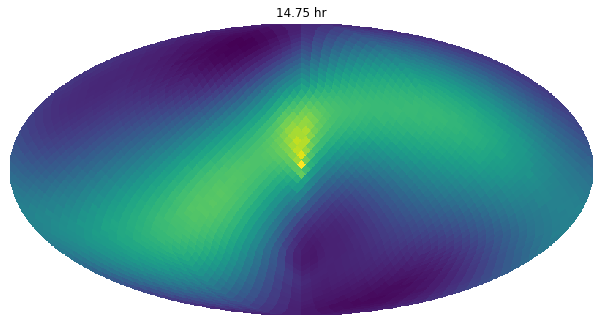

(3072, 3072)
(3072, 3072)
(3072, 3072)


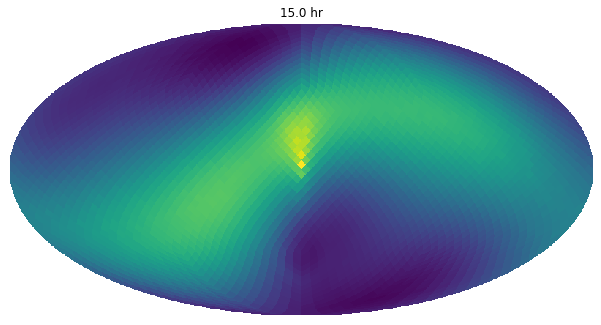

(3072, 3072)
(3072, 3072)
(3072, 3072)


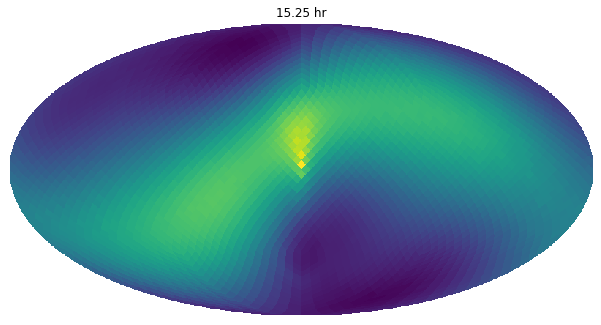

(3072, 3072)
(3072, 3072)
(3072, 3072)


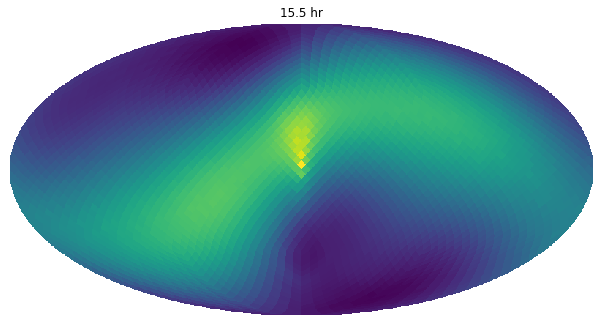

(3072, 3072)
(3072, 3072)
(3072, 3072)


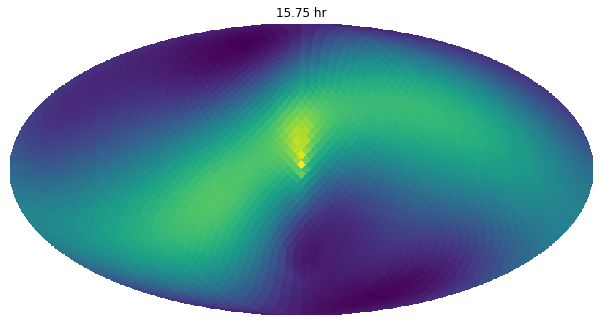

(3072, 3072)
(3072, 3072)
(3072, 3072)


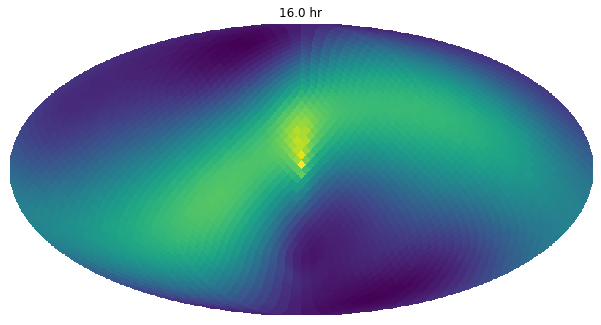

(3072, 3072)
(3072, 3072)
(3072, 3072)


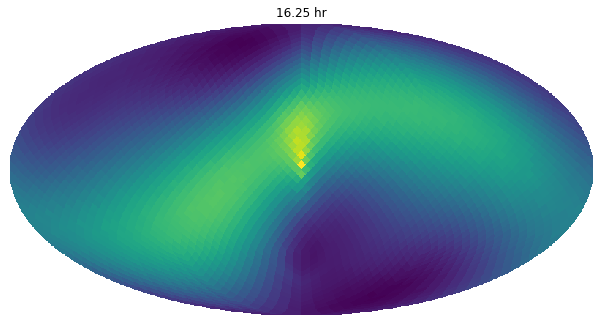

(3072, 3072)
(3072, 3072)
(3072, 3072)


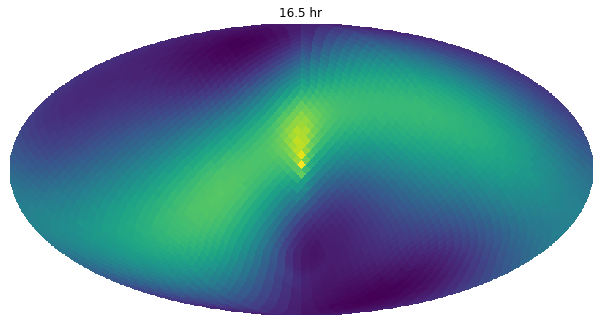

(3072, 3072)
(3072, 3072)
(3072, 3072)


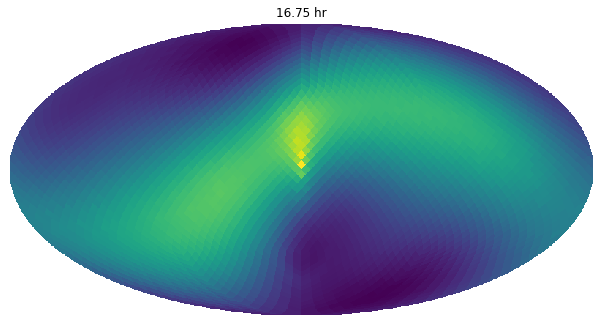

(3072, 3072)
(3072, 3072)
(3072, 3072)


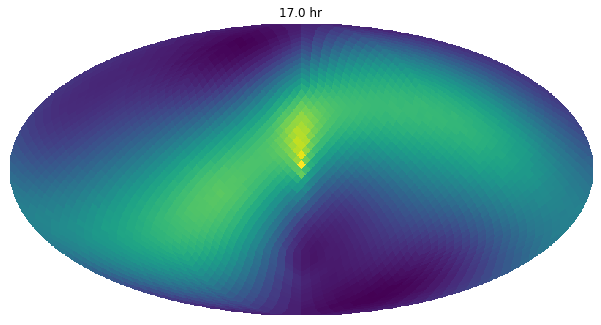

(3072, 3072)
(3072, 3072)
(3072, 3072)


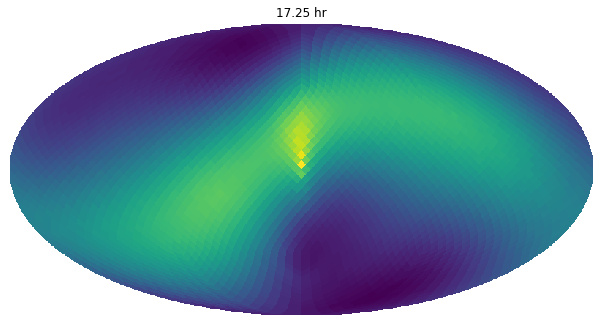

(3072, 3072)
(3072, 3072)
(3072, 3072)


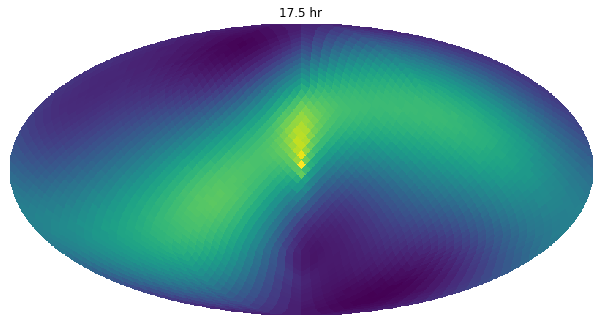

(3072, 3072)
(3072, 3072)
(3072, 3072)


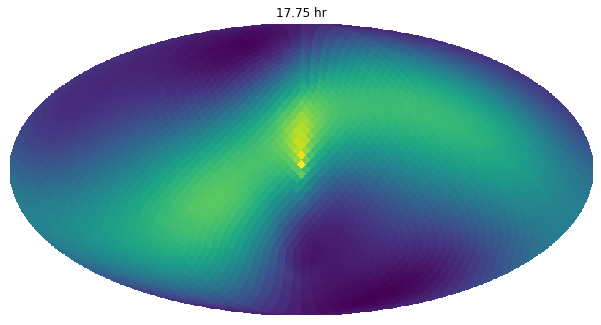

(3072, 3072)
(3072, 3072)
(3072, 3072)


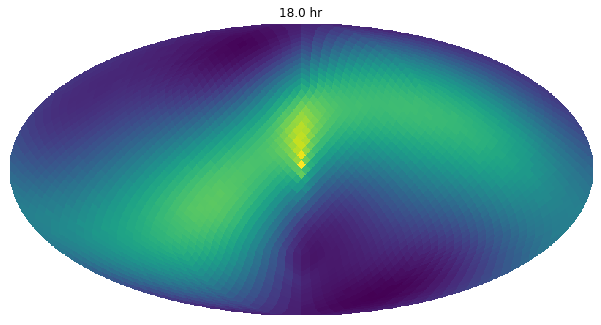

(3072, 3072)
(3072, 3072)
(3072, 3072)


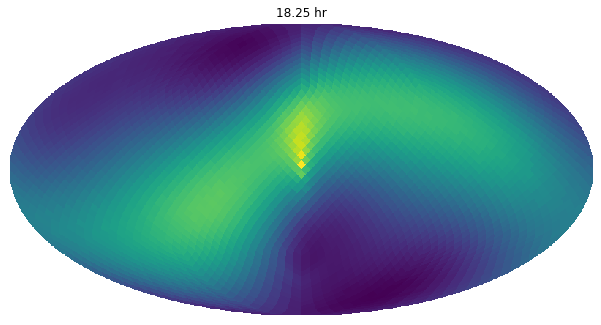

(3072, 3072)
(3072, 3072)
(3072, 3072)


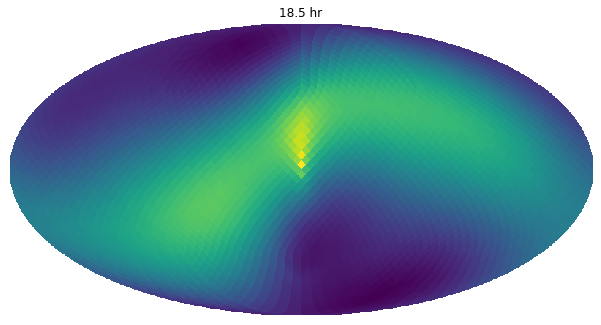

(3072, 3072)
(3072, 3072)
(3072, 3072)


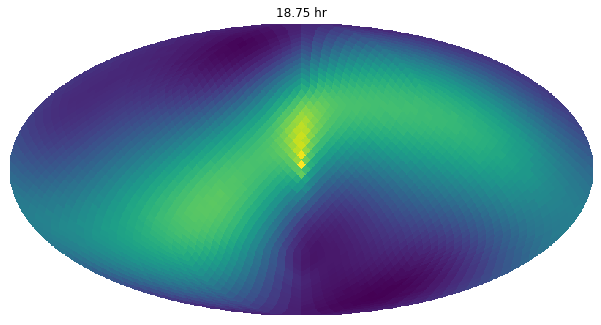

(3072, 3072)
(3072, 3072)
(3072, 3072)


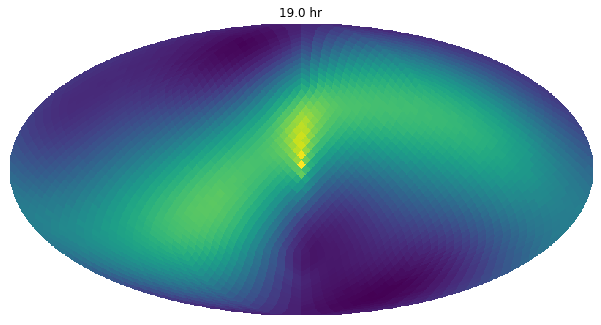

(3072, 3072)
(3072, 3072)
(3072, 3072)


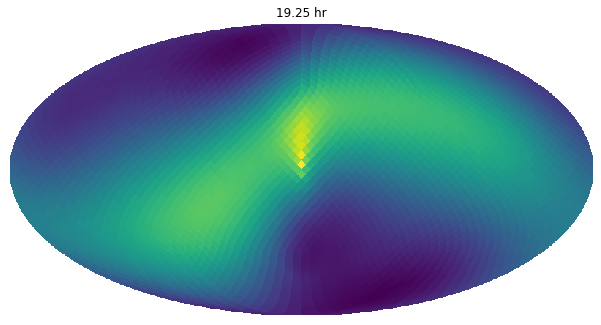

(3072, 3072)
(3072, 3072)
(3072, 3072)


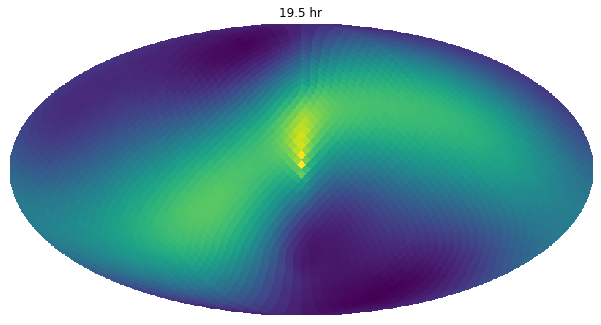

(3072, 3072)
(3072, 3072)
(3072, 3072)


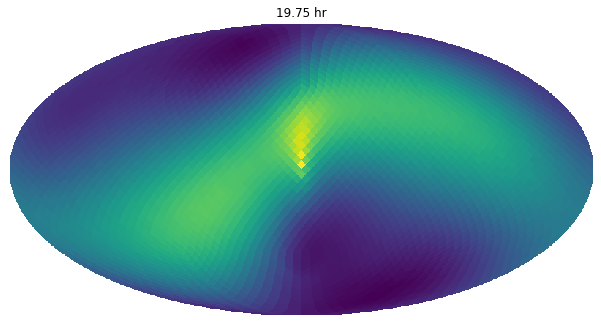

(3072, 3072)
(3072, 3072)
(3072, 3072)


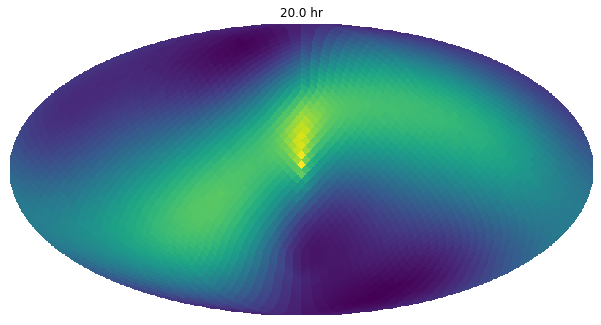

(3072, 3072)
(3072, 3072)
(3072, 3072)


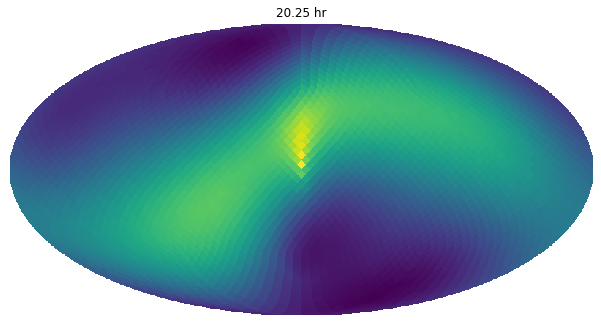

(3072, 3072)
(3072, 3072)
(3072, 3072)


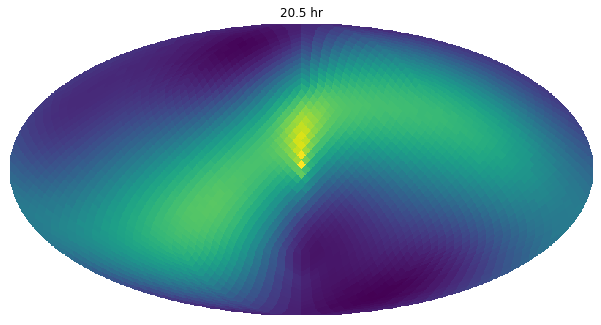

(3072, 3072)
(3072, 3072)
(3072, 3072)


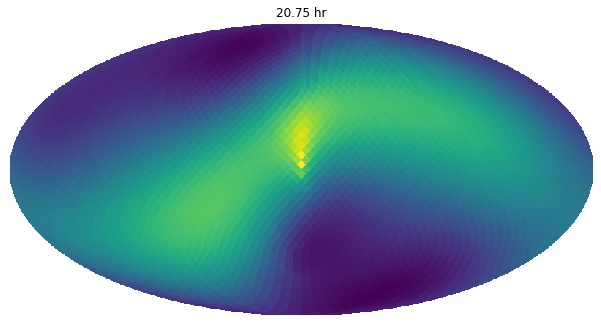

(3072, 3072)
(3072, 3072)
(3072, 3072)


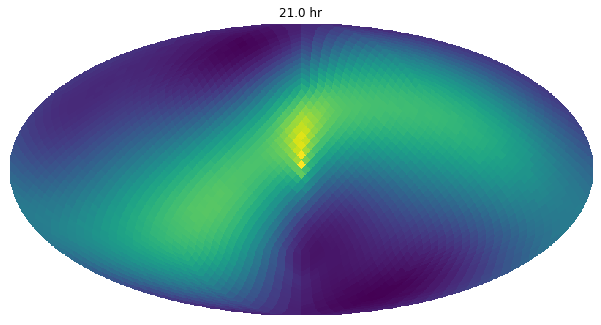

(3072, 3072)
(3072, 3072)
(3072, 3072)


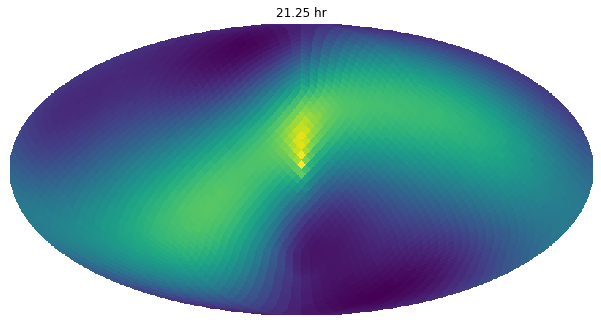

(3072, 3072)
(3072, 3072)
(3072, 3072)


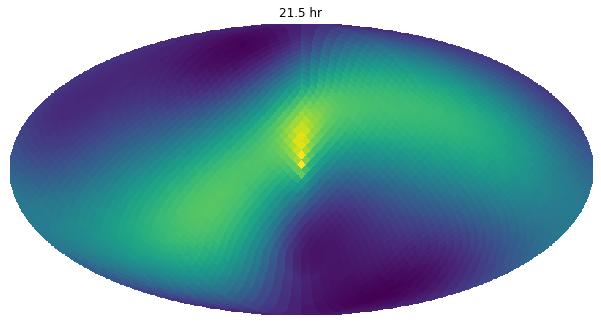

(3072, 3072)
(3072, 3072)
(3072, 3072)


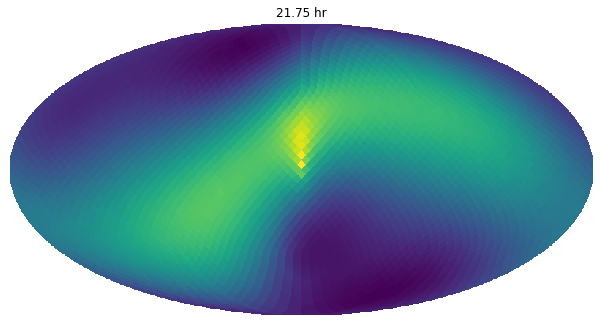

(3072, 3072)
(3072, 3072)
(3072, 3072)


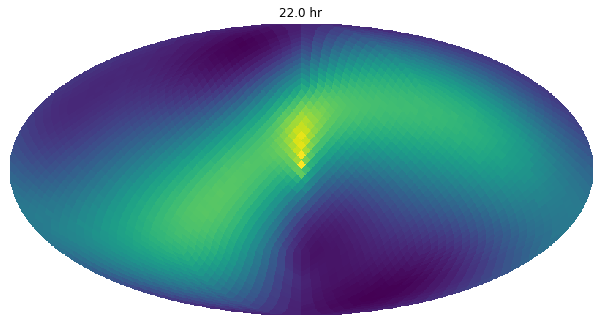

(3072, 3072)
(3072, 3072)
(3072, 3072)


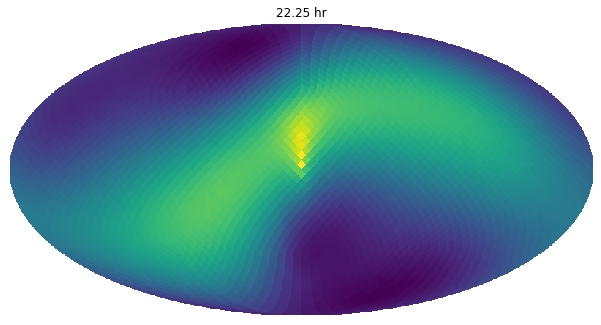

(3072, 3072)
(3072, 3072)
(3072, 3072)


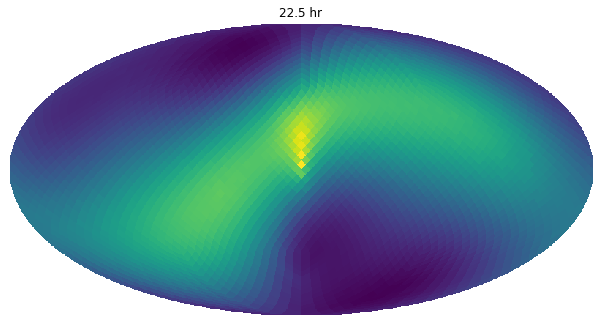

(3072, 3072)
(3072, 3072)
(3072, 3072)


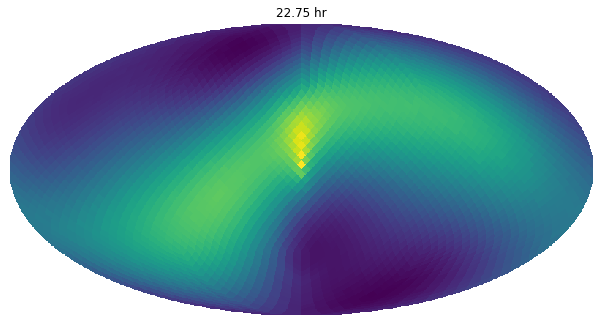

(3072, 3072)
(3072, 3072)
(3072, 3072)


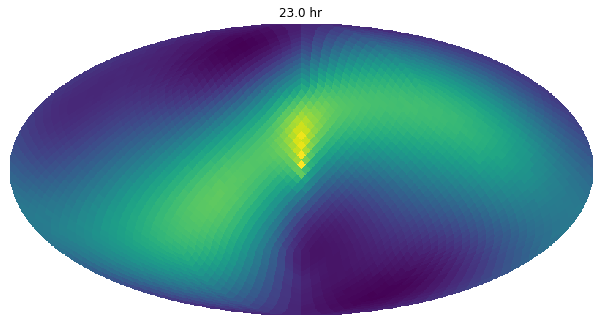

(3072, 3072)
(3072, 3072)
(3072, 3072)


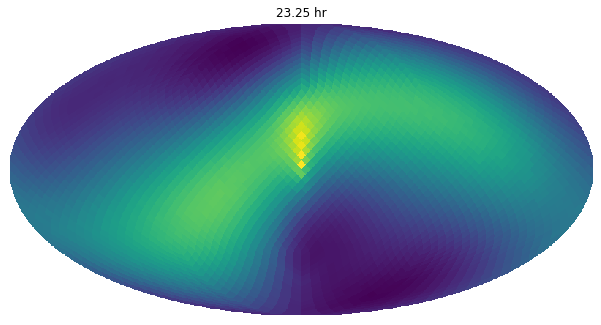

(3072, 3072)
(3072, 3072)
(3072, 3072)


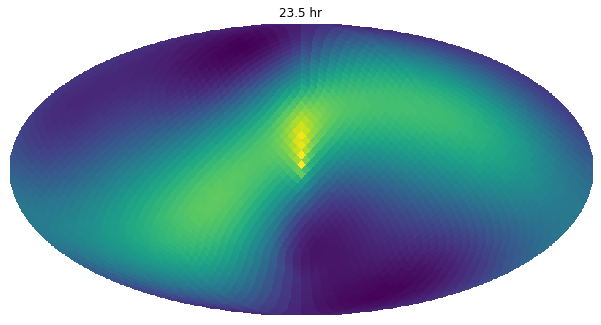

(3072, 3072)
(3072, 3072)
(3072, 3072)


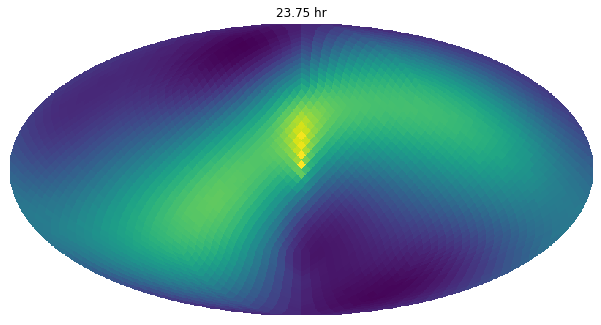

In [20]:
#cumulative_dirty = np.zeros(hp.nside2npix(nside), dtype="complex128")
cumulative_fisher = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
geom_fact_IJ = [geom_fact_HL, geom_fact_HV, geom_fact_LV]
dx_IJ = [x_H-x_L, x_H-x_V, x_L-x_V]

for i, t in enumerate(np.arange(0, 86400, 900)):
    for geom_fact, dx in zip(geom_fact_IJ, dx_IJ):
        orf = 0.5*geom_fact*np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=t, t0=0), n_hat(theta, phi))/c)\
               for f in freqs])
        orf_star = np.conjugate(orf)
        cumulative_fisher += simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    cumulative_dirty = np.einsum("ij,j", cumulative_fisher, source)
    hp.mollview(cumulative_dirty, title = f"{t/3600} hr", cbar = False)
    
    #if i<100 and i>10:
    #    num = f"0{i}"
    #elif i<10:
    #    num = f"00{i}"
    #else:
    num = f"{i}"
    
    #plt.savefig(f"./Animation/Broadband_real_ORF/{num}.svg", bbox_inches='tight')
    plt.savefig(f"./Animation/Broadband_real_ORF_HLV/{num}.png", dpi = 300, bbox_inches='tight')
    plt.show()
    plt.close()

# Testing

(-0.8906498302603392+0j)
(100, 3072)


/home/delillo/.local/lib/python3.8/site-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


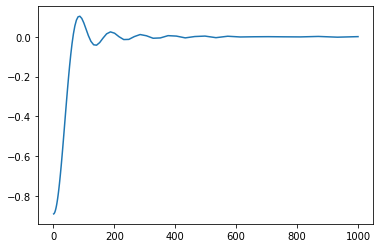

In [22]:
geom_fact = np.sum(F_L*np.conjugate(F_H), axis = 0)
print(np.sum(0.5*geom_fact*np.exp(-2*np.pi*1j*0*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=0, t0=0), n_hat(theta, phi))/c)\
                                 *5/hp.nside2npix(nside), axis = 0))
orf_test = 0.5*geom_fact*[np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=0, t0=0), n_hat(theta, phi))/c)\
                          for f in freqs]
print(np.shape(orf_test))
orf_iso_test = np.sum(orf_test, axis = 1)*5/hp.nside2npix(nside)

plt.plot(freqs, orf_iso_test)
plt.show()

(786432, 2)


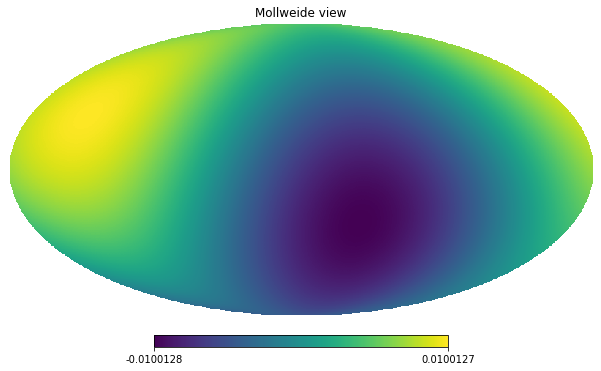

In [18]:
time_delay_HL = time_delay(x1 = x_H, x2 = x_L, nside = 256, t=0, t0=0)
print(np.shape(time_delay_HL.reshape(12*256**2,1)*np.array([0,1])))
hp.mollview(time_delay_HL, flip = "astro")

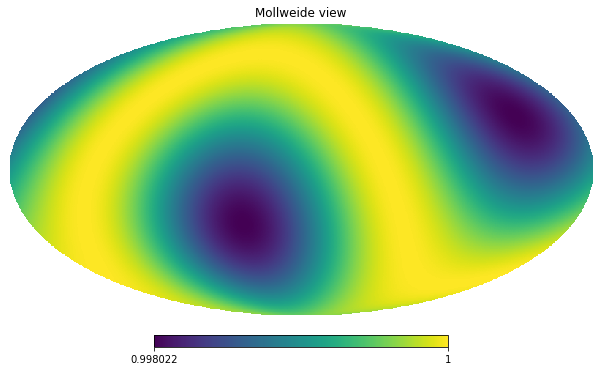

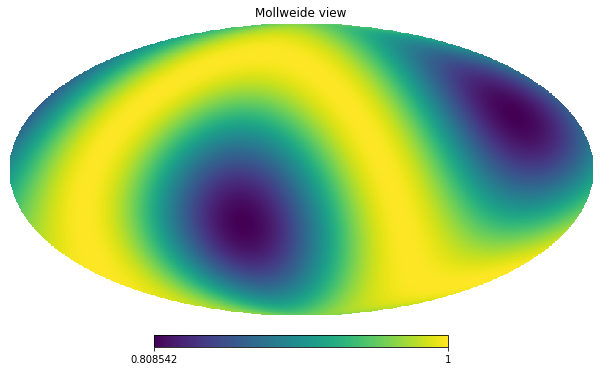

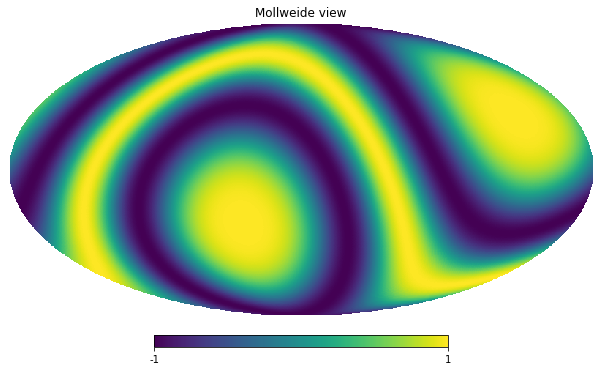

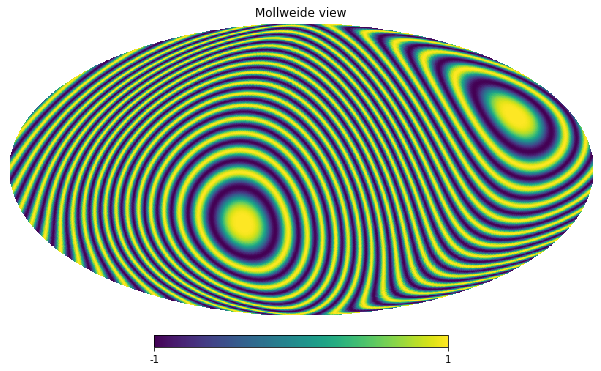

In [24]:
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*1), flip = "geo")
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*10), flip = "geo")
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*100), flip = "geo")
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*1000), flip = "geo")
#hp.mollview(np.sum(np.exp(2*np.pi*1j*time_delay_HL.reshape(12*256**2,1)*np.logspace(0,3, 100)), axis =1), flip = "astro")

In [16]:
np.shape(simple_fisher(x1 = x_H, x2 = x_L, t=[0,1], f = 1, nside = 8, t0=0))

(768, 768)

In [17]:
nside=8
f = 100
times = np.arange(0, day_s, 360)
theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))

In [18]:
#HL_simple_fisher_f = simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = nside, t0=0)
HL_simple_fisher_f = np.sum([simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = nside, t0=0)\
                           for f in tqdm(np.logspace(0,3, 100))], axis=0)

HL_simple_fisher_f_diag =np.diag(HL_simple_fisher_f)

100%|██████████| 100/100 [03:02<00:00,  1.82s/it]


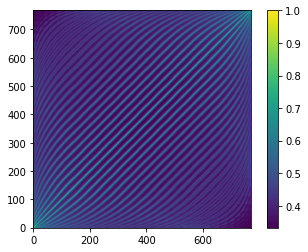

In [19]:
plt.imshow(np.real(HL_simple_fisher_f)/np.max(np.abs(HL_simple_fisher_f)), origin="lower")
plt.colorbar()
plt.show()
plt.close()

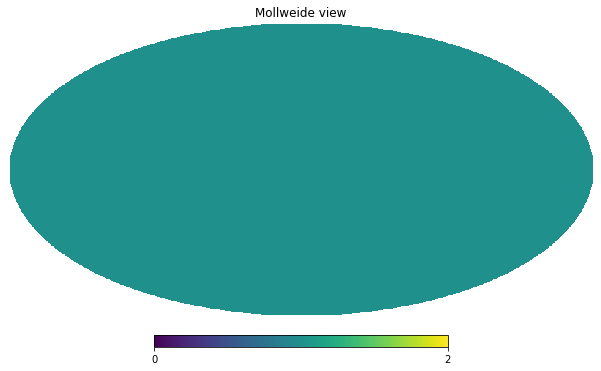

In [20]:
hp.mollview(np.real(HL_simple_fisher_f_diag)/np.max(np.abs(HL_simple_fisher_f_diag)), flip = "astro")

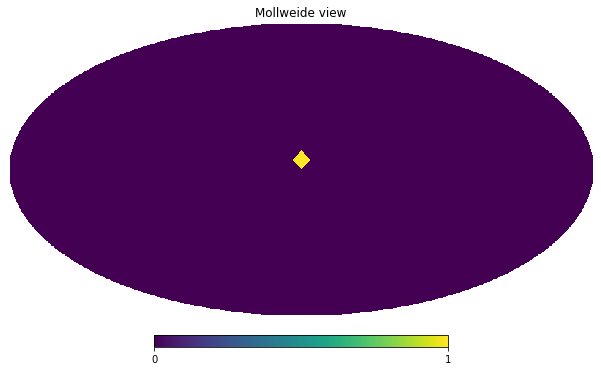

In [21]:
intensity = 1
source = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.1) & (phi==0.)]=intensity #ok for nside >8
#source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.2) & (phi==0.)]=intensity #ok for nside <=8
#print(source[source ==intensity])

hp.mollview(source)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


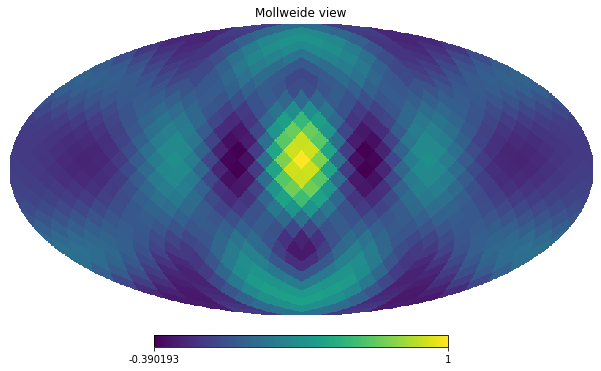

In [22]:
HL_simple_dirty_f = simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f, nside = nside, t0=0, injection=source)
hp.mollview(HL_simple_dirty_f/np.max(np.abs(HL_simple_dirty_f)), rot=(0,0,0), flip = "astro")

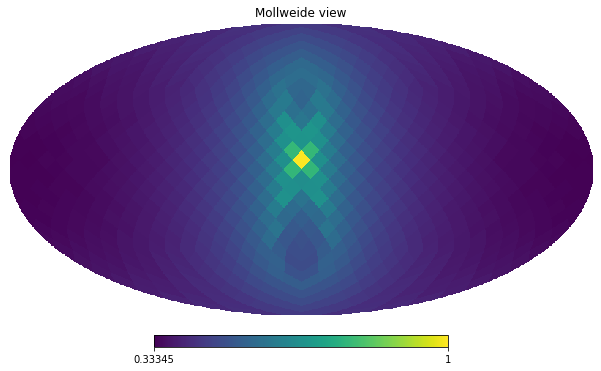

In [23]:
HL_simple_dirty = np.einsum("ij,j",HL_simple_fisher_f, source)

hp.mollview(HL_simple_dirty/np.max(np.abs(HL_simple_dirty)), rot=(0,0,0), flip = "astro")

100%|██████████| 100/100 [00:45<00:00,  2.19it/s]


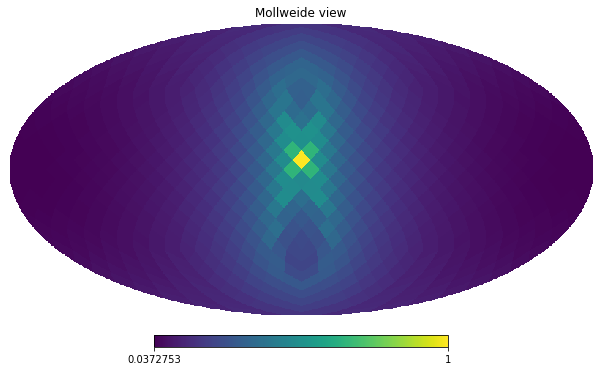

In [24]:
#HL_simple_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source)\
#                                                for f in [10,100,1000]], axis = 0)

HL_simple_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
                                                nside = nside, t0=0, injection=source)\
                                                for f in tqdm(np.logspace(1,3, 100))], axis = 0)


hp.mollview(HL_simple_dirty_broad/np.max(np.abs(HL_simple_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")

In [171]:
nside=16
f = 100
freqs = np.logspace(0,3, 100)
times = np.arange(0, day_s, 3600)
theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))

In [172]:
orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=0, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf))

(3072,) (3072,)


In [176]:
simple_fisher_numba_single_time_delay(list(orf), list(orf_star))[2][-1]

(0.9786615148615603-0.2054790483939326j)

In [177]:
simple_fisher(x1 = x_H, x2 = x_L, t=0, f = f, nside = 16, t0=0)[2][-1]

(0.9786615148615603-0.2054790483939326j)

In [59]:
%timeit simple_fisher_numba_single_time_delay(list(orf), list(orf_star))
%timeit simple_fisher(x1 = x_H, x2 = x_L, t=0, f = f, nside = 16, t0=0)

511 ms ± 58.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
103 ms ± 10.9 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [60]:
orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf))

(24, 3072) (24, 3072)


In [61]:
%timeit simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
%timeit simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = 16, t0=0)

2.41 s ± 118 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
4.37 s ± 178 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [62]:
orf = np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in [1,10,100,1000]])
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf_star))
print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

(4, 24, 3072) (4, 24, 3072)
(96, 3072)


In [63]:
%timeit simple_fisher_numba_multiple_time_delay(list(orf.reshape(-1, *orf.shape[-1:])), list(orf_star.reshape(-1, *orf_star.shape[-1:])))
%timeit [simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = 16, t0=0) for f in [1,10,100,1000]]

6.45 s ± 1.04 s per loop (mean ± std. dev. of 7 runs, 1 loop each)
15.9 s ± 912 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [156]:
a= [[0. + 0.j for i in range(0,3)] for i in range(0,3)]
print(a)
a[0][0] += 1
print(a)

[[0j, 0j, 0j], [0j, 0j, 0j], [0j, 0j, 0j]]
[[(1+0j), 0j, 0j], [0j, 0j, 0j], [0j, 0j, 0j]]


In [150]:
a=[[1, 2, 3], [4, 5, 6], [7,8,9]]
print(a[0], a[0][0])

[1, 2, 3] 1


In [198]:
%time HL_simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf.reshape(-1, *orf.shape[-1:])), list(orf_star.reshape(-1, *orf_star.shape[-1:])))

(768, 768)
CPU times: user 12.6 s, sys: 64.9 ms, total: 12.6 s
Wall time: 12.5 s


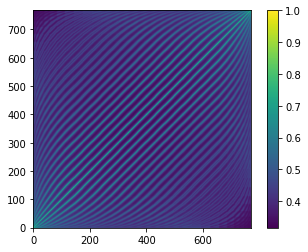

In [199]:
plt.imshow(np.real(HL_simple_fisher_broad)/np.max(np.abs(HL_simple_fisher_broad)), origin="lower")
plt.colorbar()
plt.show()
plt.close()